<a href="https://colab.research.google.com/github/frnocentini/brain-tumor-object-dectection/blob/main/Brain_Tumor_Object_Detection_Scratch_Crop_Brightness_9_layers.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd '/content/drive/MyDrive/dataset brain tumor/dataset'

/content/drive/.shortcut-targets-by-id/1LSYxqUtErLWfbOg3Kht_4Q02IsWLPY5r/dataset brain tumor/dataset


In [3]:
!unzip 'axial_t1wce_2_class' -d '/dataset unzipped'

Archive:  axial_t1wce_2_class.zip
  inflating: /dataset unzipped/axial_t1wce_2_class/axial_t1wce_2_class.yaml  
   creating: /dataset unzipped/axial_t1wce_2_class/images/
   creating: /dataset unzipped/axial_t1wce_2_class/images/test/
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_101.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_109.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_111.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_117.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_121.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_126.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00018_134.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_66.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/images/test/00019_75.jpg  
  inflating: /dataset unzipped/axial_t1wce_2_class/image

In [4]:
!unzip 'coronal_t1wce_2_class' -d '/dataset unzipped'

Archive:  coronal_t1wce_2_class.zip
  inflating: /dataset unzipped/coronal_t1wce_2_class/coronal_t1wce_2_class.yaml  
   creating: /dataset unzipped/coronal_t1wce_2_class/images/
   creating: /dataset unzipped/coronal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/13.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/15.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/17.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/19.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/20.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/23.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/33.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/34.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/35.jpg  
  inflating: /dataset unzipped/coronal_t1wce_2_class/images/test/36.jpg  
  inflating: /d

In [5]:
!unzip 'sagittal_t1wce_2_class' -d '/dataset unzipped'

Archive:  sagittal_t1wce_2_class.zip
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/
   creating: /dataset unzipped/sagittal_t1wce_2_class/images/test/
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_102.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_121.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_140.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00000_159.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_110.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_129.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_147.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00002_166.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_154.jpg  
  inflating: /dataset unzipped/sagittal_t1wce_2_class/images/test/00003_173.jpg  
  inflating: /

In [6]:
# Data Manipulation
import numpy as np
import pandas as pd
import os
# Visualization/Image Processing
import cv2
import matplotlib.pyplot as plt
from tqdm import tqdm
# Machine Learning
import tensorflow as tf
from tensorflow.keras.layers import Conv2D, Input, BatchNormalization, Flatten, MaxPool2D, MaxPooling2D, Dense, Activation, Dropout
from PIL import Image
# Other
from pathlib import Path
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from tensorflow import keras
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.models import Model
import xml.etree.ElementTree as ET
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers
import imutils
from PIL import Image, ImageEnhance

In [7]:
%cd '/dataset unzipped'

/dataset unzipped


In [8]:
def crop_brain_contour(image, plot=False):
    
    #import imutils
    #import cv2
    #from matplotlib import pyplot as plt
    
    brightness = 30
    image = np.int16(image)
    image = image + brightness
    image = np.clip(image,0,255)
    image = np.uint8(image)
    #image_enhance = ImageEnhance.Brightness(image)
    #factor = 1.5
    #image = image_enhance.enhance(factor)

    # Convert the image to grayscale, and blur it slightl
    
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image, then perform a series of erosions +
    # dilations to remove any small regions of noise
    #thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY,11,2)
    thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY)[1]
    #thresh = cv2.erode(thresh, None, iterations=2)
    #thresh = cv2.dilate(thresh, None, iterations=2)

    # Find contours in thresholded image, then grab the largest one
    cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    cnts = imutils.grab_contours(cnts)
    c = max(cnts, key=cv2.contourArea)
    

    # Find the extreme points
    extLeft = tuple(c[c[:, :, 0].argmin()][0])
    extRight = tuple(c[c[:, :, 0].argmax()][0])
    extTop = tuple(c[c[:, :, 1].argmin()][0])
    extBot = tuple(c[c[:, :, 1].argmax()][0])
    
    # crop new image out of the original image using the four extreme points (left, right, top, bottom)
    new_image = image[extTop[1]:extBot[1], extLeft[0]:extRight[0]]            

    if plot:
        plt.figure()

        plt.subplot(1, 2, 1)
        plt.imshow(image)
        
        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)
        
        plt.title('Original Image')
            
        plt.subplot(1, 2, 2)
        plt.imshow(new_image)

        plt.tick_params(axis='both', which='both', 
                        top=False, bottom=False, left=False, right=False,
                        labelbottom=False, labeltop=False, labelleft=False, labelright=False)

        plt.title('Cropped Image')
        
        plt.show()

    #add contrast
    #kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(3,3))
    # Top Hat Transform
    #topHat = cv2.morphologyEx(new_image, cv2.MORPH_TOPHAT, kernel)
    # Black Hat Transform
    #blackHat = cv2.morphologyEx(new_image, cv2.MORPH_BLACKHAT, kernel)
    
    #new_image = new_image + topHat - blackHat
    
    return new_image,extLeft,extRight,extTop,extBot

In [9]:
#Codice per rendere l'immagine quadrata 
def make_square(im, fill_color=(0, 0, 0, 0)):
    x, y = im.shape[0], im.shape[1]
    size = max(x, y)
    BLACK = [0, 0, 0]
    new_im = cv2.copyMakeBorder(im,int((size-y)/2),int((size-y)/2),int((size-x)/2),int((size-x)/2),cv2.BORDER_CONSTANT, value = BLACK)
    return new_im

In [10]:
#Bounding box with one tumor
lab = ['axial_t1wce_2_class','coronal_t1wce_2_class', 'sagittal_t1wce_2_class']
X_train = []
bb = []
count = 0;
temp_array  = []
extLeft_coords_x = []
extLeft_coords_y = []
extRight_coords_x = []
extRight_coords_y = []
extTop_coords_x = []
extTop_coords_y = []
extBot_coords_x = []
extBot_coords_y = []
image_width = []
image_height = []


extLeft_coords_x_test = []
extLeft_coords_y_test = []
extRight_coords_x_test = []
extRight_coords_y_test = []
extTop_coords_x_test = []
extTop_coords_y_test = []
extBot_coords_x_test = []
extBot_coords_y_test = []
images_width_test = []
images_height_test = []
width_new_im = []
height_new_im = []
traslazione_x_test = []
traslazione_y_test = []

image_size = 224

for i in lab:
    folderPath = os.path.join('./',i,'images','train')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        image_width.append(img.shape[1])
        image_height.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image,extLeft,extRight,extTop,extBot = crop_brain_contour(img,False)
        extLeft_coords_x.append(extLeft[0])
        extLeft_coords_y.append(extLeft[1])
        extRight_coords_x.append(extRight[0])
        extRight_coords_y.append(extRight[1])
        extTop_coords_x.append(extTop[0])
        extTop_coords_y.append(extTop[1])
        extBot_coords_x.append(extBot[0])
        extBot_coords_y.append(extBot[1])
        # resize image
        image = cv2.resize(image, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_train.append(image)

image_index = 0
#bb_train = np.zeros((len(X_train),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','train')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                 
                temp_array[0] = temp_array[0]*image_width[count] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x[count]
                temp_array[0] = (temp_array[0]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                temp_array[1] = temp_array[1]*image_height[count]
                temp_array[1] = temp_array[1]-extTop_coords_y[count]
                temp_array[1] = (temp_array[1]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size
                
                temp_array[2] = temp_array[2]*(image_width[count])
                temp_array[2] = (temp_array[2]/(extRight_coords_x[count]-extLeft_coords_x[count]))*image_size
                
                
                temp_array[3] = temp_array[3]*(image_height[count])
                temp_array[3] = (temp_array[3]/(extBot_coords_y[count]-extTop_coords_y[count]))*image_size                 
            
                lbls_array.append(temp_array)

                #print(temp_array)
                #bb_train[image_index] = np.array([temp_array])
                #print(bb_train[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_train: ', len(X_train))
print('bb_list: ', len(bb_list))

for i in range(len(X_train)):
  if(len(duplicate_img[i]) == 2):
    X_train.append(X_train[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata
bb_train = np.zeros((len(X_train),4))

for j in range(len(bb_list)):
  bb_train[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_train: ', len(X_train))
print('bb_train: ', len(bb_train))

X_test = []
for i in lab:
    folderPath = os.path.join('./',i,'images','test')
    for j in sorted(os.listdir(folderPath)):
        #load the image
        img = cv2.imread(os.path.join(folderPath,j))
        images_width_test.append(img.shape[1])
        images_height_test.append(img.shape[0])
        # crop the brain and ignore the unnecessary rest part of the image
        image_test,extLeft_test,extRight_test,extTop_test,extBot_test = crop_brain_contour(img,False)
        extLeft_coords_x_test.append(extLeft_test[0])
        extLeft_coords_y_test.append(extLeft_test[1])
        extRight_coords_x_test.append(extRight_test[0])
        extRight_coords_y_test.append(extRight_test[1])
        extTop_coords_x_test.append(extTop_test[0])
        extTop_coords_y_test.append(extTop_test[1])
        extBot_coords_x_test.append(extBot_test[0])
        extBot_coords_y_test.append(extBot_test[1])
        # resize image
        image_test = cv2.resize(image_test, dsize=(image_size, image_size), interpolation=cv2.INTER_CUBIC)
        #if img.shape[0] != img.shape[1]:
            #img = make_square(img, fill_color=(0, 0, 0, 0))
        #img = cv2.resize(img,(image_size, image_size))
        X_test.append(image_test)

image_index = 0
count_test = 0;
#bb_test = np.zeros((len(X_test),4))
bb_list = []
duplicate_img = []
for i in lab:
    labelsPath = os.path.join('./',i,'labels','test')
    for j in sorted(os.listdir(labelsPath)):
        with open(os.path.join(labelsPath,j), encoding="utf-8") as f:
            lbls_array = []
            for line in f:
                num = list(map(float,line.split(" ")))
                temp_array = []
                for k in num:
                    temp_array.append(k)
                temp_array.pop(0)
                #width_new_im.append(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test])
                #height_new_im.append(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test])
                
                
                temp_array[0] = temp_array[0]*images_width_test[count_test] #centro x immagine originale
                temp_array[0] = temp_array[0]-extLeft_coords_x_test[count_test]
                temp_array[0] = (temp_array[0]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                temp_array[1] = temp_array[1]*images_height_test[count_test]
                temp_array[1] = temp_array[1]-extTop_coords_y_test[count_test]
                temp_array[1] = (temp_array[1]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size
                
                temp_array[2] = temp_array[2]*(images_width_test[count_test])
                temp_array[2] = (temp_array[2]/(extRight_coords_x_test[count_test]-extLeft_coords_x_test[count_test]))*image_size
                
                
                temp_array[3] = temp_array[3]*(images_height_test[count_test])
                temp_array[3] = (temp_array[3]/(extBot_coords_y_test[count_test]-extTop_coords_y_test[count_test]))*image_size                 
            
                lbls_array.append(temp_array)

                #bb_test[image_index] = np.array([temp_array])
                #print(bb_test[image_index])

            bb_list.append(temp_array)
            duplicate_img.append(lbls_array)
            image_index += 1
            count_test += 1

#Codice per duplicare le immagini con due bounding box
print('Dimensione delle liste prima di duplicare le immagini:')
print('X_test: ', len(X_test))
print('bb_list: ', len(bb_list))

for i in range(len(X_test)):
  if(len(duplicate_img[i]) == 2):
    X_test.append(X_test[i])
    bb_list.append(duplicate_img[i][0])  #dentro bb_list è già stata inserita la seconda label, quindi ora insieriamo la prima per l'immagine duplicata

bb_test = np.zeros((len(X_test),4))

for j in range(len(bb_test)):
  bb_test[j] = np.array([bb_list[j]])

#Dimensione delle liste dopo la duplicazione delle immagini:
print('Dimensione delle liste dopo la duplicazione delle immagini:')
print('X_test: ', len(X_test))
print('bb_test: ', len(bb_test))

#print(bb_test[30])
#print(extRight_coords_x_test[30])
#print(extLeft_coords_x_test[30])
     


Dimensione delle liste prima di duplicare le immagini:
X_train:  878
bb_list:  878
Dimensione delle liste dopo la duplicazione delle immagini:
X_train:  919
bb_train:  919
Dimensione delle liste prima di duplicare le immagini:
X_test:  223
bb_list:  223
Dimensione delle liste dopo la duplicazione delle immagini:
X_test:  237
bb_test:  237


In [11]:
#prepare dataset 
train_dataset = ImageDataGenerator()
val_dataset = ImageDataGenerator()
test_dataset = ImageDataGenerator()

In [12]:
datagen = ImageDataGenerator(
  rescale = 1./255,
  #rotation_range = 5,
  shear_range = 0.02,
  #zoom_range = 0.02, 
  samplewise_center = True,
  samplewise_std_normalization = True
  #horizontal_flip=True
)

val_data_gen = ImageDataGenerator(rescale = 1./255)

In [13]:
#array conversion
X_train = np.array(X_train)
X_test = np.array(X_test)

In [14]:
#Shuffle
X_train, bb_train = shuffle(X_train, bb_train)

In [15]:
#Validation set created
X_train, X_val, bb_train, bb_val = train_test_split(X_train, bb_train, test_size = 0.1, shuffle = False)

In [16]:
tf.keras.backend.set_image_data_format('channels_last')
BATCH_SIZE = 32
#save_path = os.path.join('./', 'model_from_scratch')
train_dataset = train_dataset.flow(X_train, bb_train, batch_size = BATCH_SIZE)
val_dataset = val_dataset.flow(X_val, bb_val, batch_size = BATCH_SIZE)
test_dataset = test_dataset.flow(X_test, bb_test)

In [17]:
input_ = Input(shape=[image_size,image_size, 3])

x = input_

for i in range(9):
    n_filters = 2**(i + 3)
    x = Conv2D(n_filters, 3, activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = MaxPool2D(2, padding='same')(x)

x = Dropout(0.5)(x)
x = Flatten()(x)
x = Dense(256, activation='relu')(x)
x = Dense(32, activation='relu')(x)
output = Dense(4, name='coords')(x)

model = tf.keras.models.Model(input_, output)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv2d (Conv2D)             (None, 224, 224, 8)       224       
                                                                 
 batch_normalization (BatchN  (None, 224, 224, 8)      32        
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 112, 112, 8)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 112, 112, 16)      1168      
                                                                 
 batch_normalization_1 (Batc  (None, 112, 112, 16)     64    

In [18]:
# Draw the predicted bounding boxes
def display_image(img, bbox_coords, pred_coords):
    if len(bbox_coords) == 4: #in rosso
        xmin, ymin, height, width = bbox_coords
        img = cv2.rectangle(img, (int(xmin-height/2), int(ymin-width/2)), (int(xmin+height/2), int(ymin+width/2)), (255, 0, 0), 1)
    print(len(pred_coords))    
    if len(pred_coords) == 4: #in verde
        xmin1, ymin1, height1, width1 = pred_coords
        img = cv2.rectangle(img, (int(xmin1-height1/2), int(ymin1-width1/2)), (int(xmin1+height1/2), int(ymin1+width1/2)), (0, 255, 0), 1)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [19]:
#To test the model
def test_model(model):
    rand_index = np.random.randint(0, bb_test.shape[0])
    pred_bbox = model.predict(X_test)[rand_index]
    img_original = X_test[rand_index]
    img = img_original.copy()
    coords = bb_test[rand_index]
    #example, label = next(datagen)
    #X = example['image']
    #y = label['coords']
    #pred_bbox = model.predict(X)[0]
    #img = X[0]
    #gt_coords = y[0]
    
    display_image(img,bbox_coords = coords, pred_coords=pred_bbox)

def test(model):
    
    plt.figure(figsize=(15,7))
    for i in range(3):
        plt.subplot(1, 3, i + 1)
        test_model(model)    
    plt.show()

class ShowTestImages(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        test(self.model)
        

In [20]:
%cd '../content/drive/MyDrive'
! mkdir  model_checkpoint_SCRATCH

save_path = './model_checkpoint_SCRATCH/model_SCRATCH.h5'
     

/content/drive/MyDrive
mkdir: cannot create directory ‘model_checkpoint_SCRATCH’: File exists


In [21]:
callbacks_list = [
    keras.callbacks.ModelCheckpoint(
    save_format = 'h5',
    filepath=save_path,
    monitor='val_loss',
    verbose=1,
    save_best_only=True
    ),
    ShowTestImages()
]

In [22]:
METRIC_THRESH = 0.3

def raw_iou(y_true, y_pred):
    results = []
    for i in range(0,y_true.shape[0]):


        boxTrue_width = y_true[i,2]
        boxTrue_height = y_true[i,3]
        x_boxTrue_tleft = y_true[i,0]-boxTrue_width/2  # numpy index selection
        y_boxTrue_tleft = y_true[i,1]-boxTrue_height/2
    
        area_boxTrue = (boxTrue_width * boxTrue_height)

        # boxPred
        boxPred_width = y_pred[i,2]
        boxPred_height = y_pred[i,3]
        x_boxPred_tleft = y_pred[i,0]-boxPred_width/2  
        y_boxPred_tleft = y_pred[i,1]-boxPred_height/2
    
        area_boxPred = (boxPred_width * boxPred_height)


        # calculate the bottom right coordinates for boxTrue and boxPred

        # boxTrue
        x_boxTrue_br = x_boxTrue_tleft + boxTrue_width
        y_boxTrue_br = y_boxTrue_tleft + boxTrue_height # Version 2 revision

        # boxPred
        x_boxPred_br = x_boxPred_tleft + boxPred_width
        y_boxPred_br = y_boxPred_tleft + boxPred_height # Version 2 revision


        # calculate the top left and bottom right coordinates for the intersection box, boxInt

        # boxInt - top left coords
        x_boxInt_tleft = np.max([x_boxTrue_tleft,x_boxPred_tleft])
        y_boxInt_tleft = np.max([y_boxTrue_tleft,y_boxPred_tleft]) # Version 2 revision

        # boxInt - bottom right coords
        x_boxInt_br = np.min([x_boxTrue_br,x_boxPred_br])
        y_boxInt_br = np.min([y_boxTrue_br,y_boxPred_br]) 

        # Calculate the area of boxInt, i.e. the area of the intersection 
        # between boxTrue and boxPred.
        # The np.max() function forces the intersection area to 0 if the boxes don't overlap.
        
        
        # Version 2 revision
        area_of_intersection = \
        np.max([0,(x_boxInt_br - x_boxInt_tleft)]) * np.max([0,(y_boxInt_br - y_boxInt_tleft)])

        iou = np.mean(area_of_intersection / ((area_boxTrue + area_boxPred) - area_of_intersection)).astype(np.float32)


        # This must match the type used in py_func
        results.append(iou)
    return np.mean(results)
def IoU(y_true, y_pred):
    iou = tf.numpy_function(raw_iou, [y_true, y_pred], tf.float32)
    return iou

In [23]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

Epoch 1/200
26/26 [==============================] - ETA: 0s - loss: 51.5537 - IoU: 0.0216
Epoch 1: val_loss improved from inf to 304.36737, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 1s 62ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 9ms/step
4


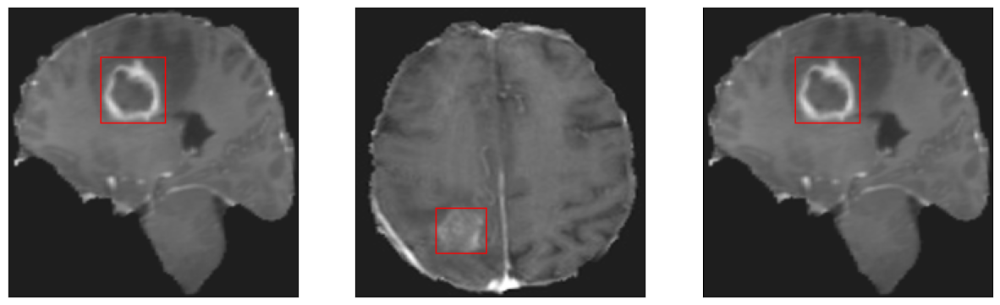

26/26 [==============================] - 36s 624ms/step - loss: 51.5537 - IoU: 0.0216 - val_loss: 304.3674 - val_IoU: 0.0000e+00
Epoch 2/200
26/26 [==============================] - ETA: 0s - loss: 27.7559 - IoU: 0.0751
Epoch 2: val_loss improved from 304.36737 to 62.65740, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4


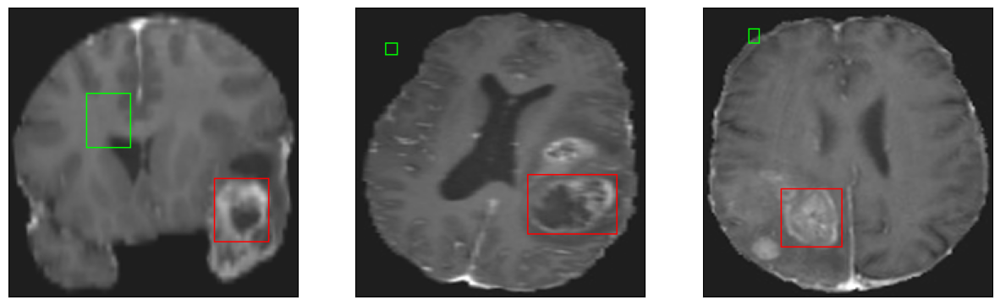

26/26 [==============================] - 9s 350ms/step - loss: 27.7559 - IoU: 0.0751 - val_loss: 62.6574 - val_IoU: 0.0038
Epoch 3/200
26/26 [==============================] - ETA: 0s - loss: 26.3866 - IoU: 0.0676
Epoch 3: val_loss improved from 62.65740 to 35.33547, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


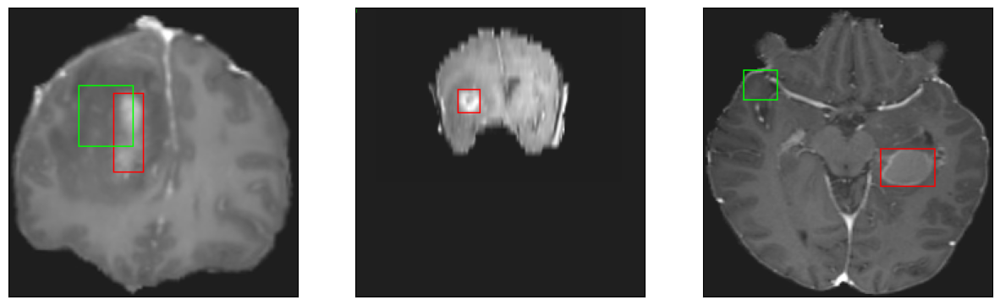

26/26 [==============================] - 4s 165ms/step - loss: 26.3866 - IoU: 0.0676 - val_loss: 35.3355 - val_IoU: 0.0593
Epoch 4/200
26/26 [==============================] - ETA: 0s - loss: 24.9944 - IoU: 0.0811
Epoch 4: val_loss improved from 35.33547 to 33.61256, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


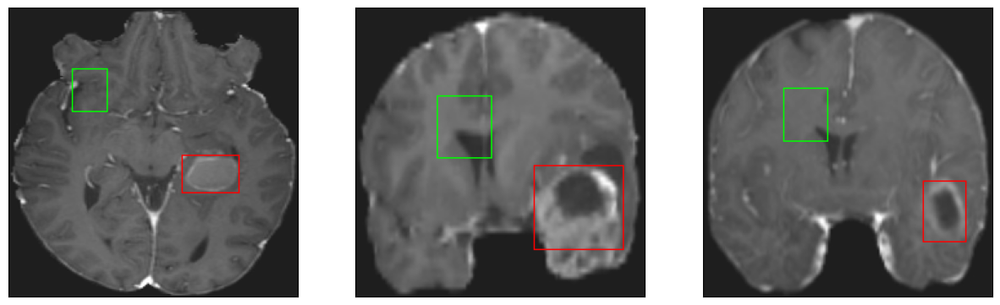

26/26 [==============================] - 4s 167ms/step - loss: 24.9944 - IoU: 0.0811 - val_loss: 33.6126 - val_IoU: 0.0483
Epoch 5/200
26/26 [==============================] - ETA: 0s - loss: 25.6538 - IoU: 0.0800
Epoch 5: val_loss improved from 33.61256 to 29.69296, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


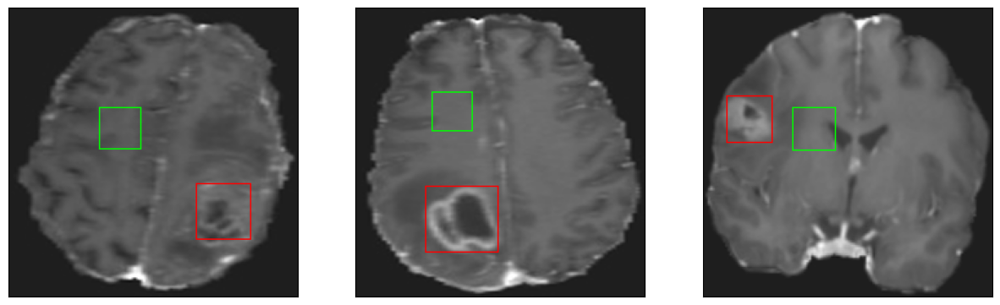

26/26 [==============================] - 4s 164ms/step - loss: 25.6538 - IoU: 0.0800 - val_loss: 29.6930 - val_IoU: 0.0501
Epoch 6/200
26/26 [==============================] - ETA: 0s - loss: 24.6114 - IoU: 0.0883
Epoch 6: val_loss improved from 29.69296 to 27.03841, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4


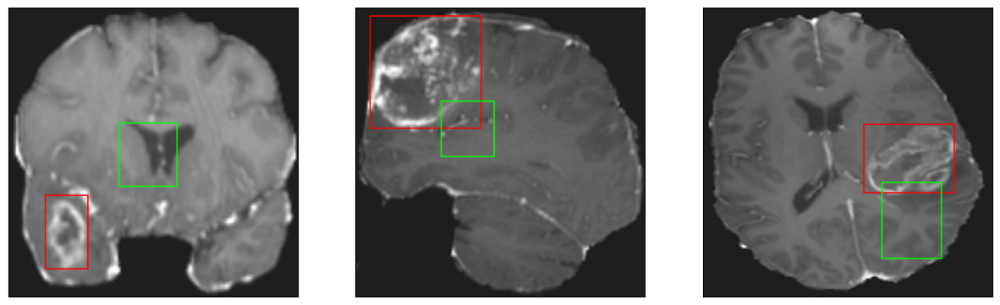

26/26 [==============================] - 5s 182ms/step - loss: 24.6114 - IoU: 0.0883 - val_loss: 27.0384 - val_IoU: 0.0738
Epoch 7/200
26/26 [==============================] - ETA: 0s - loss: 23.1286 - IoU: 0.1101
Epoch 7: val_loss improved from 27.03841 to 26.68112, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4


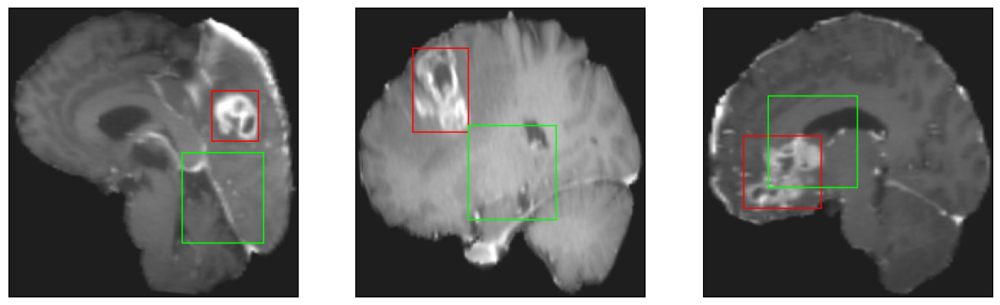

26/26 [==============================] - 4s 170ms/step - loss: 23.1286 - IoU: 0.1101 - val_loss: 26.6811 - val_IoU: 0.1298
Epoch 8/200
26/26 [==============================] - ETA: 0s - loss: 21.6698 - IoU: 0.1381
Epoch 8: val_loss improved from 26.68112 to 20.72202, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


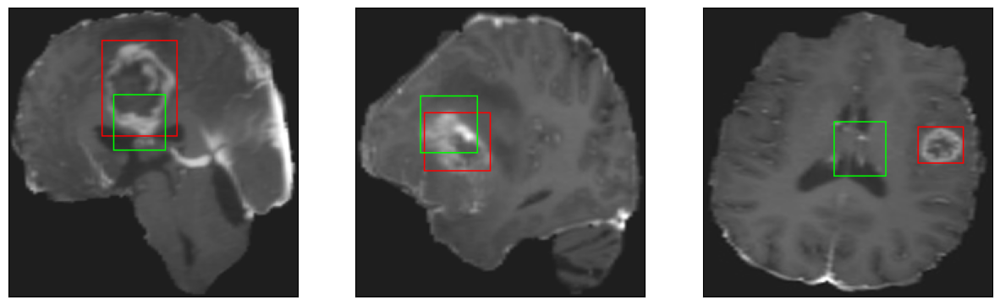

26/26 [==============================] - 4s 170ms/step - loss: 21.6698 - IoU: 0.1381 - val_loss: 20.7220 - val_IoU: 0.1781
Epoch 9/200
26/26 [==============================] - ETA: 0s - loss: 19.8743 - IoU: 0.1601
Epoch 9: val_loss did not improve from 20.72202
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4


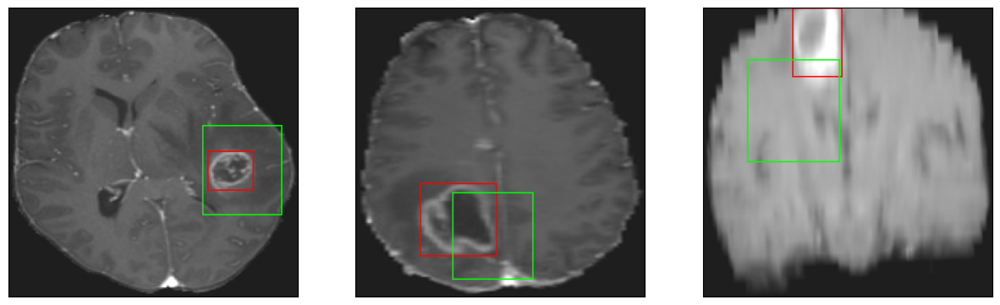

26/26 [==============================] - 3s 128ms/step - loss: 19.8743 - IoU: 0.1601 - val_loss: 27.3003 - val_IoU: 0.1585
Epoch 10/200
26/26 [==============================] - ETA: 0s - loss: 18.0814 - IoU: 0.2173
Epoch 10: val_loss did not improve from 20.72202
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4


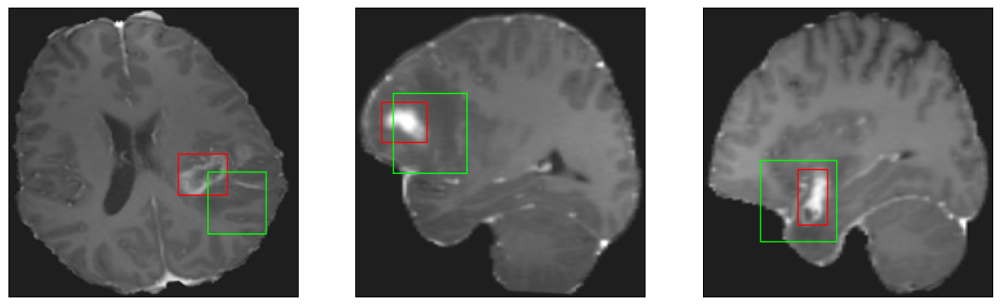

26/26 [==============================] - 3s 124ms/step - loss: 18.0814 - IoU: 0.2173 - val_loss: 24.3288 - val_IoU: 0.1730
Epoch 11/200
26/26 [==============================] - ETA: 0s - loss: 16.8155 - IoU: 0.2195
Epoch 11: val_loss did not improve from 20.72202
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4


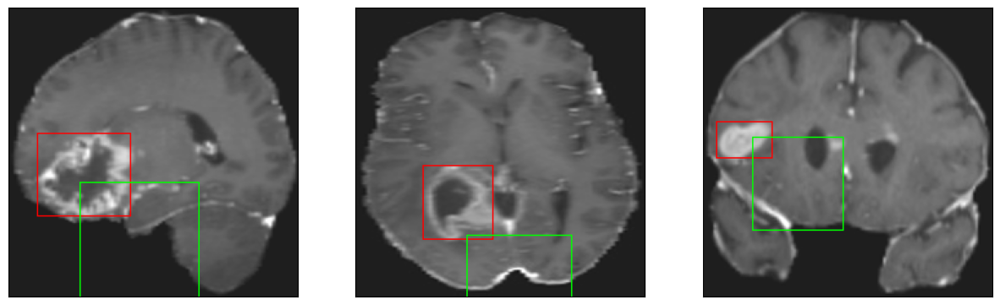

26/26 [==============================] - 3s 133ms/step - loss: 16.8155 - IoU: 0.2195 - val_loss: 41.3586 - val_IoU: 0.0784
Epoch 12/200
26/26 [==============================] - ETA: 0s - loss: 16.6380 - IoU: 0.2344
Epoch 12: val_loss improved from 20.72202 to 20.31179, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4


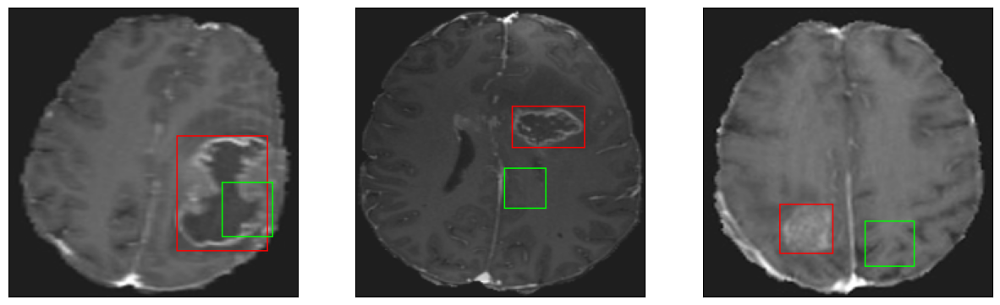

26/26 [==============================] - 12s 466ms/step - loss: 16.6380 - IoU: 0.2344 - val_loss: 20.3118 - val_IoU: 0.1678
Epoch 13/200
26/26 [==============================] - ETA: 0s - loss: 15.9256 - IoU: 0.2589
Epoch 13: val_loss did not improve from 20.31179
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4


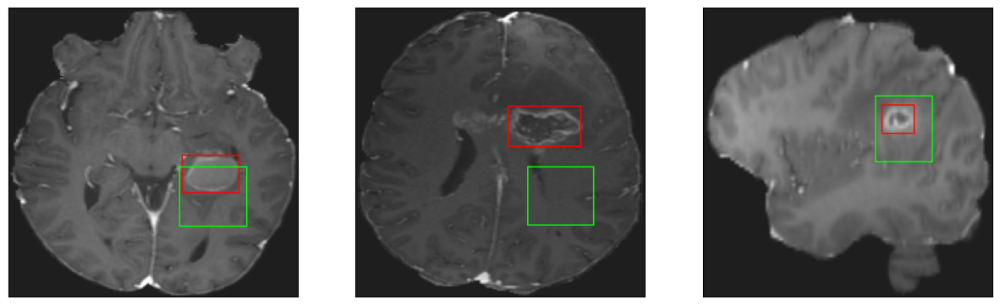

26/26 [==============================] - 3s 123ms/step - loss: 15.9256 - IoU: 0.2589 - val_loss: 22.2482 - val_IoU: 0.2222
Epoch 14/200
26/26 [==============================] - ETA: 0s - loss: 15.0846 - IoU: 0.2700
Epoch 14: val_loss improved from 20.31179 to 20.30563, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4


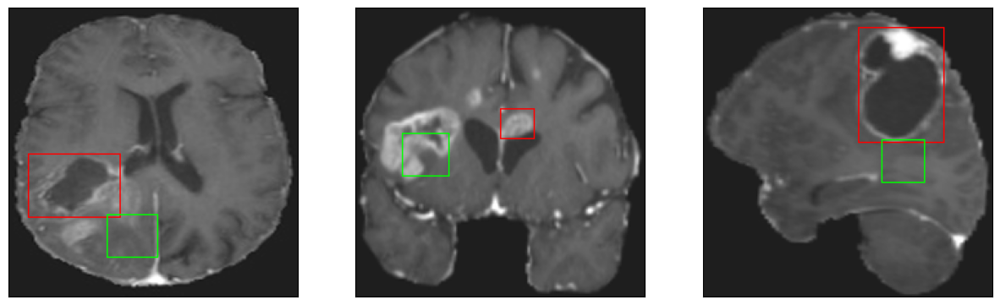

26/26 [==============================] - 5s 212ms/step - loss: 15.0846 - IoU: 0.2700 - val_loss: 20.3056 - val_IoU: 0.1526
Epoch 15/200
26/26 [==============================] - ETA: 0s - loss: 14.6430 - IoU: 0.2801
Epoch 15: val_loss did not improve from 20.30563
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 17ms/step
4


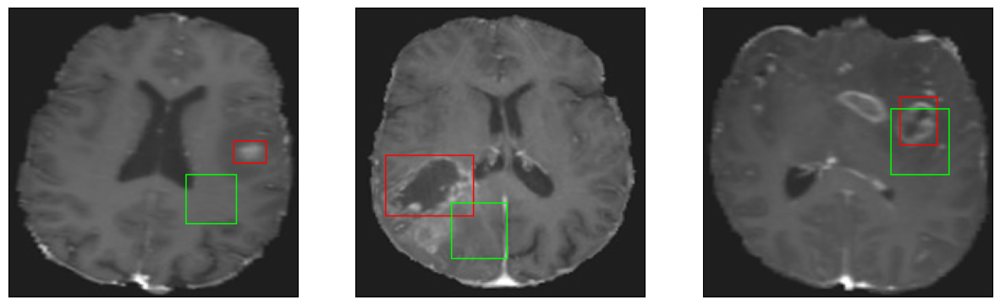

26/26 [==============================] - 3s 131ms/step - loss: 14.6430 - IoU: 0.2801 - val_loss: 21.0343 - val_IoU: 0.1252
Epoch 16/200
26/26 [==============================] - ETA: 0s - loss: 14.3408 - IoU: 0.2748
Epoch 16: val_loss improved from 20.30563 to 16.22105, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 15ms/step
4


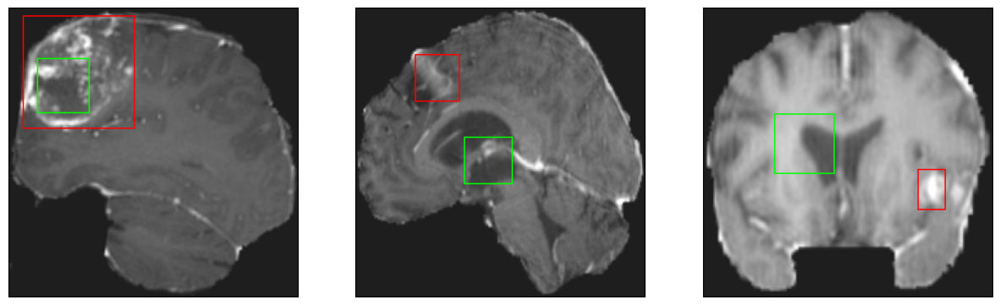

26/26 [==============================] - 10s 379ms/step - loss: 14.3408 - IoU: 0.2748 - val_loss: 16.2211 - val_IoU: 0.2801
Epoch 17/200
26/26 [==============================] - ETA: 0s - loss: 13.5504 - IoU: 0.3008
Epoch 17: val_loss improved from 16.22105 to 14.68625, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 20ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4


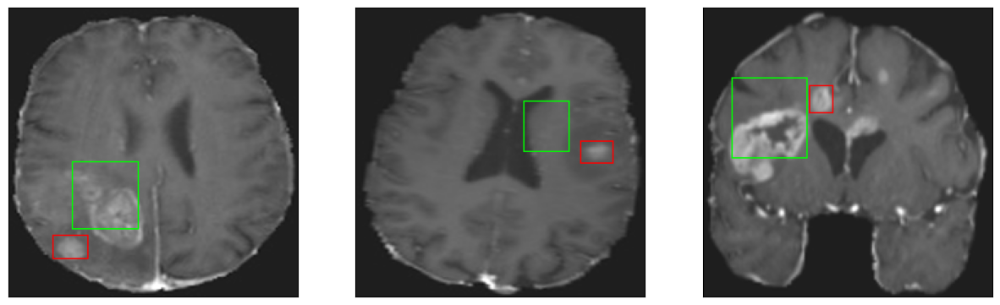

26/26 [==============================] - 5s 205ms/step - loss: 13.5504 - IoU: 0.3008 - val_loss: 14.6862 - val_IoU: 0.3252
Epoch 18/200
26/26 [==============================] - ETA: 0s - loss: 12.9880 - IoU: 0.3114
Epoch 18: val_loss did not improve from 14.68625
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4


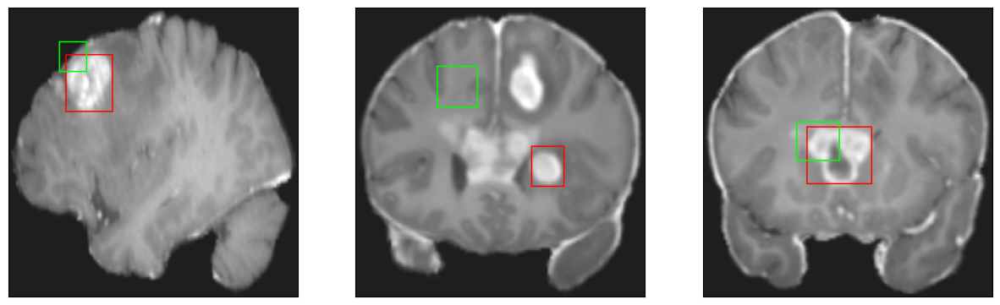

26/26 [==============================] - 3s 128ms/step - loss: 12.9880 - IoU: 0.3114 - val_loss: 21.6177 - val_IoU: 0.1414
Epoch 19/200
26/26 [==============================] - ETA: 0s - loss: 13.2634 - IoU: 0.3166
Epoch 19: val_loss did not improve from 14.68625
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 16ms/step
4


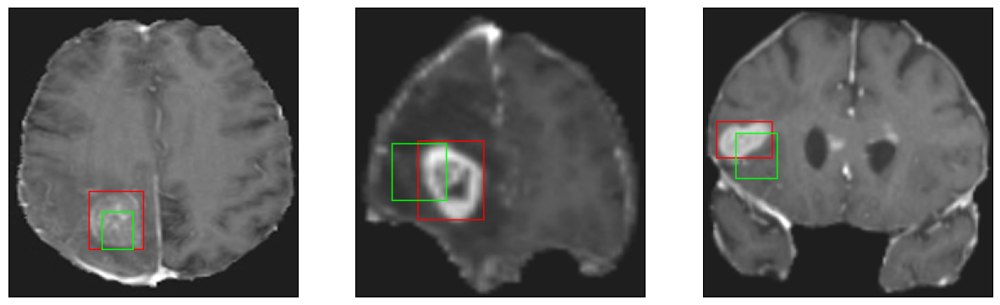

26/26 [==============================] - 4s 159ms/step - loss: 13.2634 - IoU: 0.3166 - val_loss: 17.1658 - val_IoU: 0.2095
Epoch 20/200
26/26 [==============================] - ETA: 0s - loss: 13.5372 - IoU: 0.3051
Epoch 20: val_loss improved from 14.68625 to 14.21005, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4


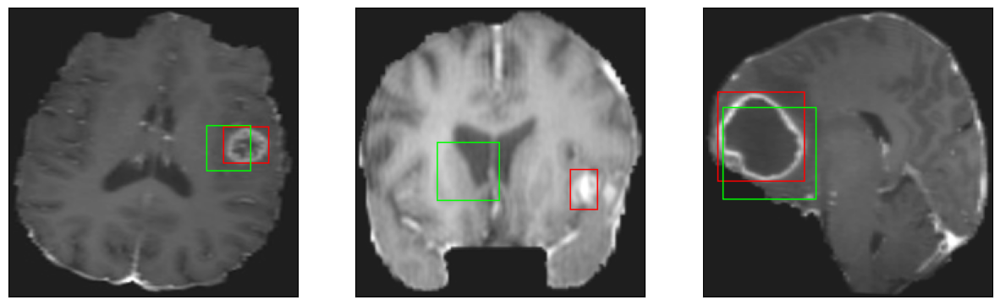

26/26 [==============================] - 10s 374ms/step - loss: 13.5372 - IoU: 0.3051 - val_loss: 14.2101 - val_IoU: 0.2972
Epoch 21/200
26/26 [==============================] - ETA: 0s - loss: 12.5826 - IoU: 0.3323
Epoch 21: val_loss did not improve from 14.21005
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4


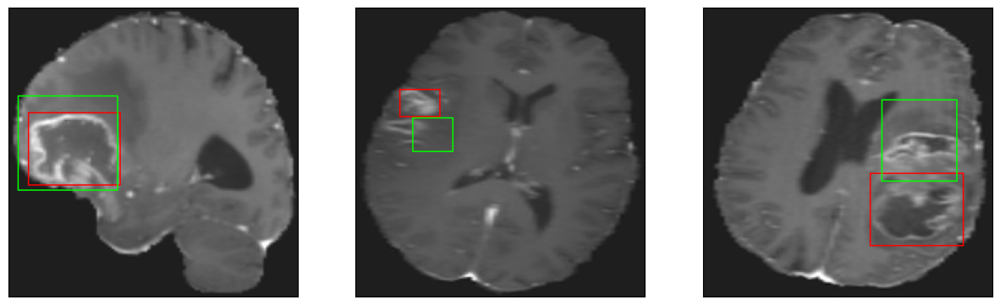

26/26 [==============================] - 4s 137ms/step - loss: 12.5826 - IoU: 0.3323 - val_loss: 15.4577 - val_IoU: 0.3270
Epoch 22/200
26/26 [==============================] - ETA: 0s - loss: 13.1838 - IoU: 0.3054
Epoch 22: val_loss did not improve from 14.21005
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 12ms/step
4


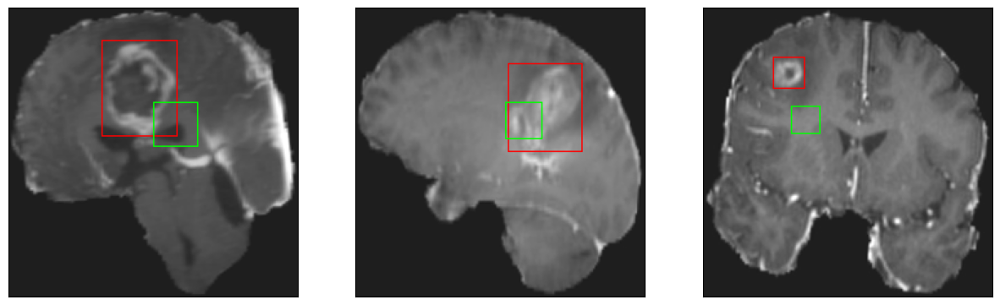

26/26 [==============================] - 4s 155ms/step - loss: 13.1838 - IoU: 0.3054 - val_loss: 17.0637 - val_IoU: 0.2435
Epoch 23/200
26/26 [==============================] - ETA: 0s - loss: 11.5453 - IoU: 0.3517
Epoch 23: val_loss did not improve from 14.21005
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4


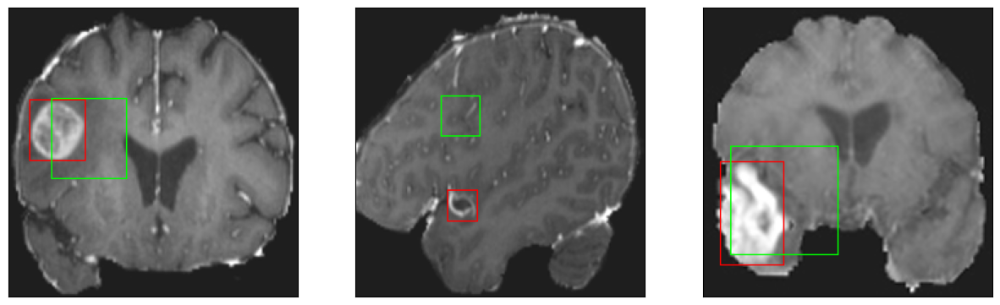

26/26 [==============================] - 3s 125ms/step - loss: 11.5453 - IoU: 0.3517 - val_loss: 16.0594 - val_IoU: 0.3319
Epoch 24/200
26/26 [==============================] - ETA: 0s - loss: 11.0641 - IoU: 0.3655
Epoch 24: val_loss improved from 14.21005 to 11.22927, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 19ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4


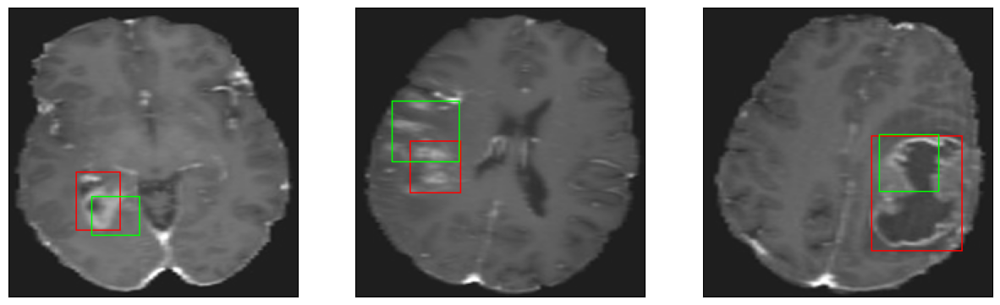

26/26 [==============================] - 7s 281ms/step - loss: 11.0641 - IoU: 0.3655 - val_loss: 11.2293 - val_IoU: 0.4295
Epoch 25/200
26/26 [==============================] - ETA: 0s - loss: 11.3005 - IoU: 0.3513
Epoch 25: val_loss did not improve from 11.22927
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


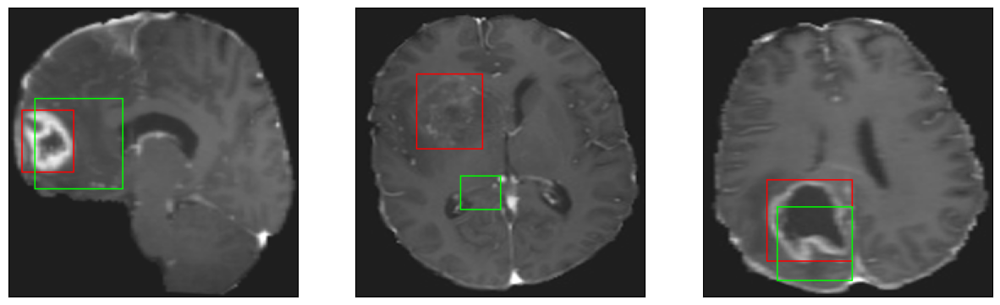

26/26 [==============================] - 3s 122ms/step - loss: 11.3005 - IoU: 0.3513 - val_loss: 13.9179 - val_IoU: 0.3605
Epoch 26/200
26/26 [==============================] - ETA: 0s - loss: 11.0159 - IoU: 0.3677
Epoch 26: val_loss did not improve from 11.22927
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 17ms/step
4


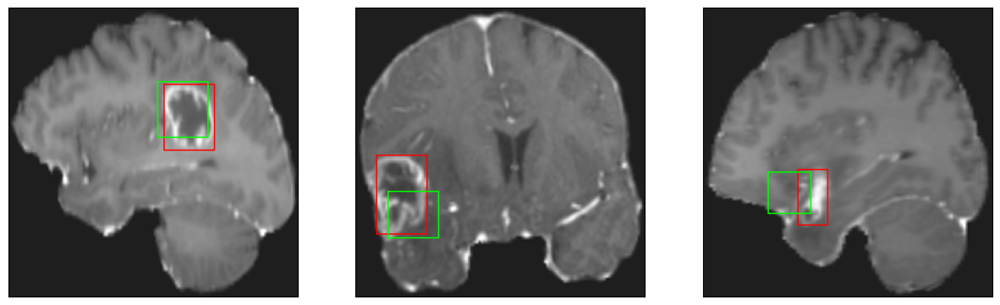

26/26 [==============================] - 4s 142ms/step - loss: 11.0159 - IoU: 0.3677 - val_loss: 13.9469 - val_IoU: 0.2948
Epoch 27/200
26/26 [==============================] - ETA: 0s - loss: 10.3845 - IoU: 0.3914
Epoch 27: val_loss did not improve from 11.22927
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


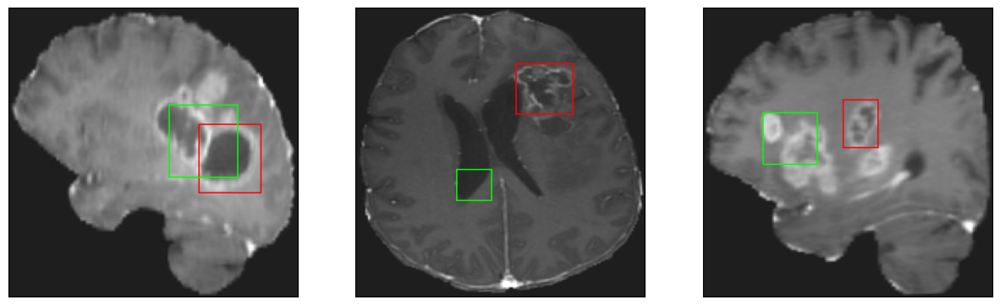

26/26 [==============================] - 4s 146ms/step - loss: 10.3845 - IoU: 0.3914 - val_loss: 12.9807 - val_IoU: 0.3535
Epoch 28/200
26/26 [==============================] - ETA: 0s - loss: 10.8678 - IoU: 0.3685
Epoch 28: val_loss did not improve from 11.22927
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


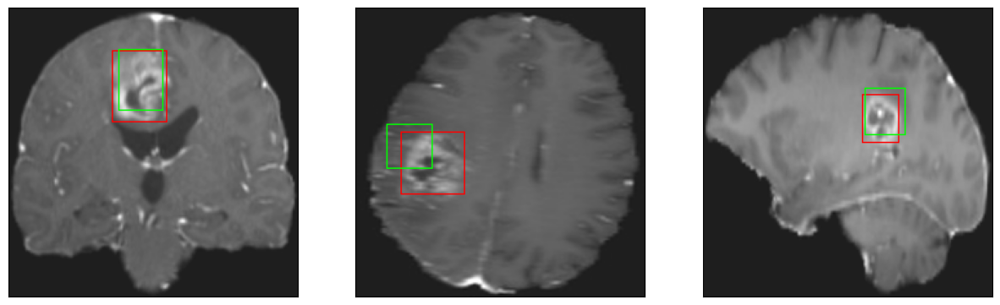

26/26 [==============================] - 3s 128ms/step - loss: 10.8678 - IoU: 0.3685 - val_loss: 12.8820 - val_IoU: 0.3601
Epoch 29/200
26/26 [==============================] - ETA: 0s - loss: 11.0324 - IoU: 0.3694
Epoch 29: val_loss did not improve from 11.22927
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


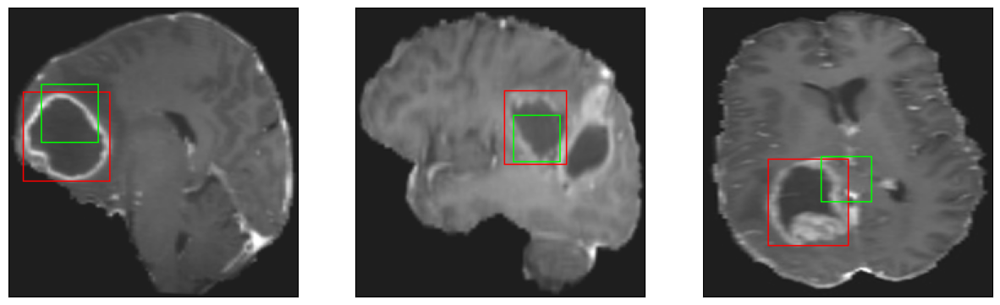

26/26 [==============================] - 3s 123ms/step - loss: 11.0324 - IoU: 0.3694 - val_loss: 22.2910 - val_IoU: 0.1358
Epoch 30/200
26/26 [==============================] - ETA: 0s - loss: 10.3826 - IoU: 0.3854
Epoch 30: val_loss did not improve from 11.22927
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4


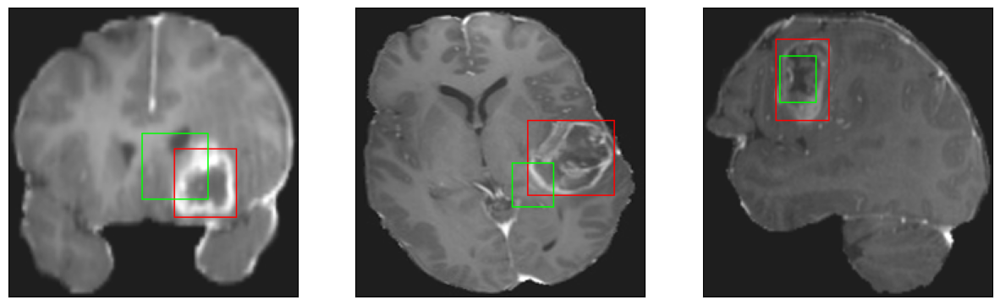

26/26 [==============================] - 4s 148ms/step - loss: 10.3826 - IoU: 0.3854 - val_loss: 17.9668 - val_IoU: 0.2035
Epoch 31/200
26/26 [==============================] - ETA: 0s - loss: 10.8487 - IoU: 0.3825
Epoch 31: val_loss did not improve from 11.22927
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


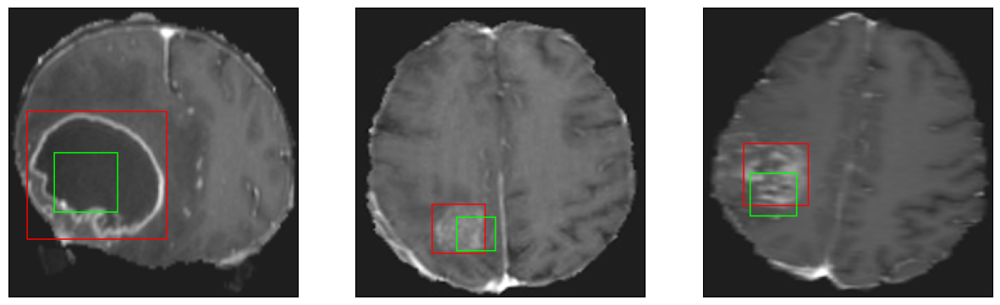

26/26 [==============================] - 3s 126ms/step - loss: 10.8487 - IoU: 0.3825 - val_loss: 13.9264 - val_IoU: 0.3288
Epoch 32/200
26/26 [==============================] - ETA: 0s - loss: 9.9803 - IoU: 0.3982
Epoch 32: val_loss did not improve from 11.22927
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


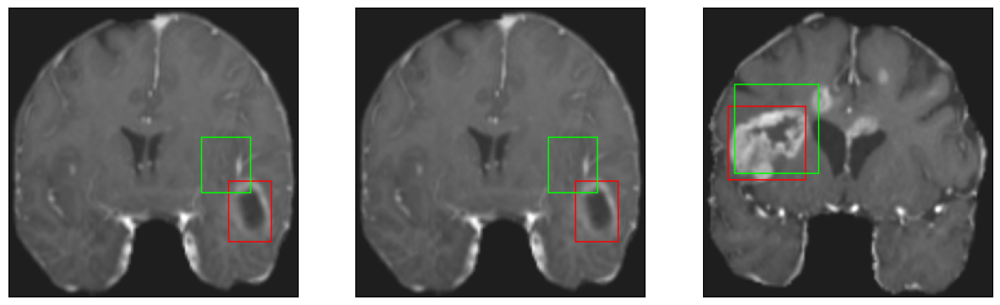

26/26 [==============================] - 3s 124ms/step - loss: 9.9803 - IoU: 0.3982 - val_loss: 12.8575 - val_IoU: 0.3565
Epoch 33/200
26/26 [==============================] - ETA: 0s - loss: 9.4217 - IoU: 0.4169
Epoch 33: val_loss did not improve from 11.22927
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 17ms/step
4


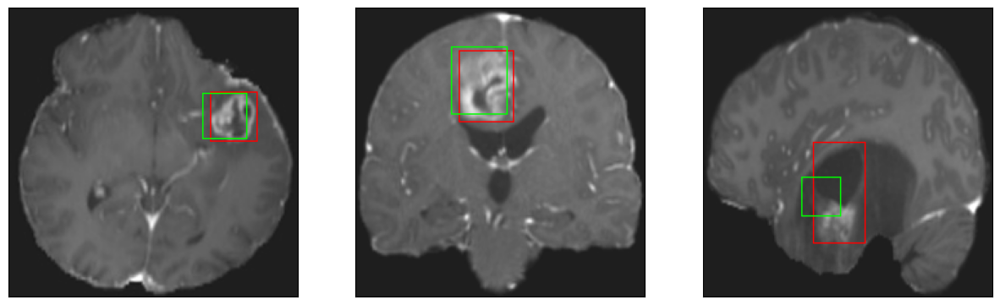

26/26 [==============================] - 4s 149ms/step - loss: 9.4217 - IoU: 0.4169 - val_loss: 12.4758 - val_IoU: 0.4166
Epoch 34/200
26/26 [==============================] - ETA: 0s - loss: 10.2601 - IoU: 0.3916
Epoch 34: val_loss did not improve from 11.22927
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4


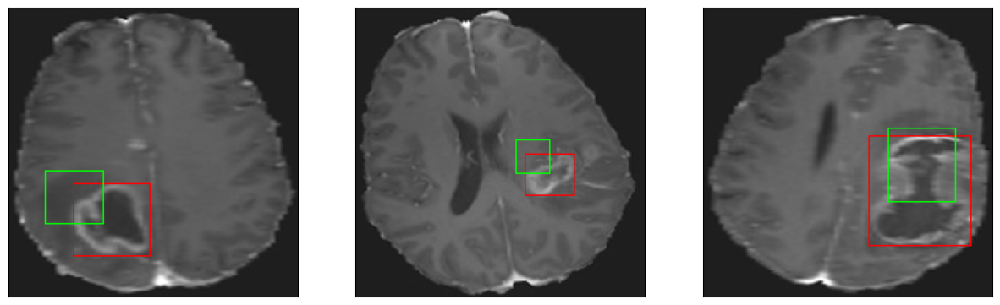

26/26 [==============================] - 4s 134ms/step - loss: 10.2601 - IoU: 0.3916 - val_loss: 14.2922 - val_IoU: 0.3372
Epoch 35/200
26/26 [==============================] - ETA: 0s - loss: 9.9353 - IoU: 0.3913
Epoch 35: val_loss did not improve from 11.22927
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


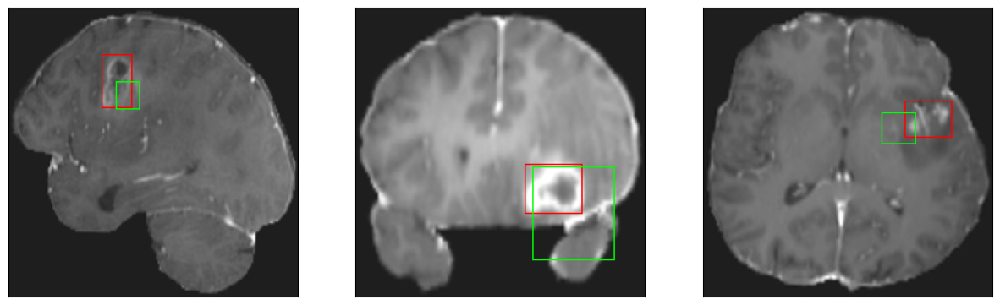

26/26 [==============================] - 3s 131ms/step - loss: 9.9353 - IoU: 0.3913 - val_loss: 12.1332 - val_IoU: 0.4104
Epoch 36/200
26/26 [==============================] - ETA: 0s - loss: 9.6062 - IoU: 0.4133
Epoch 36: val_loss improved from 11.22927 to 10.58945, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


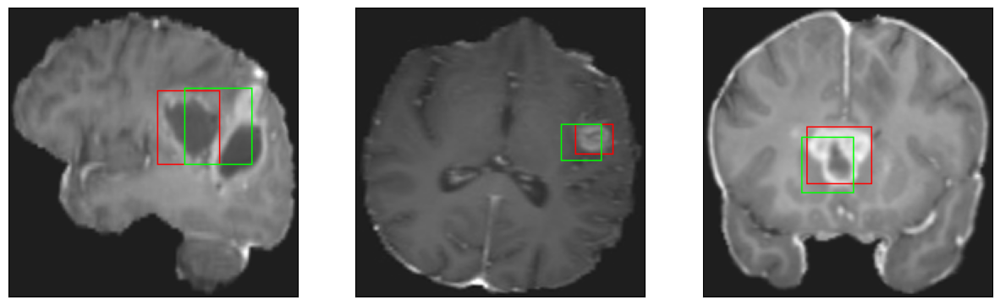

26/26 [==============================] - 14s 557ms/step - loss: 9.6062 - IoU: 0.4133 - val_loss: 10.5895 - val_IoU: 0.4564
Epoch 37/200
26/26 [==============================] - ETA: 0s - loss: 9.1073 - IoU: 0.4368
Epoch 37: val_loss did not improve from 10.58945
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4


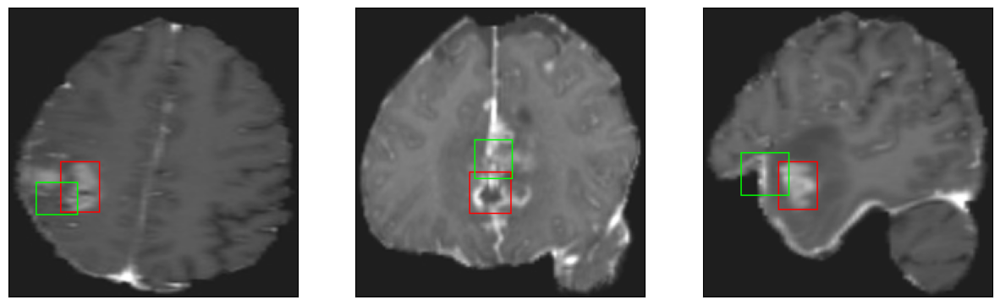

26/26 [==============================] - 4s 148ms/step - loss: 9.1073 - IoU: 0.4368 - val_loss: 13.2024 - val_IoU: 0.3429
Epoch 38/200
26/26 [==============================] - ETA: 0s - loss: 9.0761 - IoU: 0.4289
Epoch 38: val_loss did not improve from 10.58945
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4


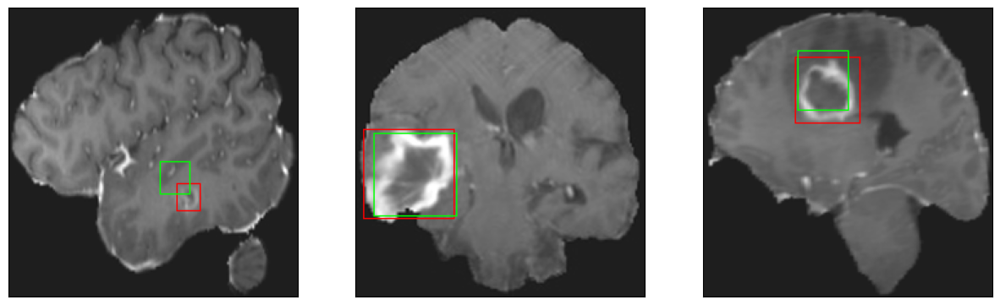

26/26 [==============================] - 4s 168ms/step - loss: 9.0761 - IoU: 0.4289 - val_loss: 12.3700 - val_IoU: 0.3949
Epoch 39/200
26/26 [==============================] - ETA: 0s - loss: 9.1951 - IoU: 0.4347
Epoch 39: val_loss did not improve from 10.58945
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 14ms/step
4


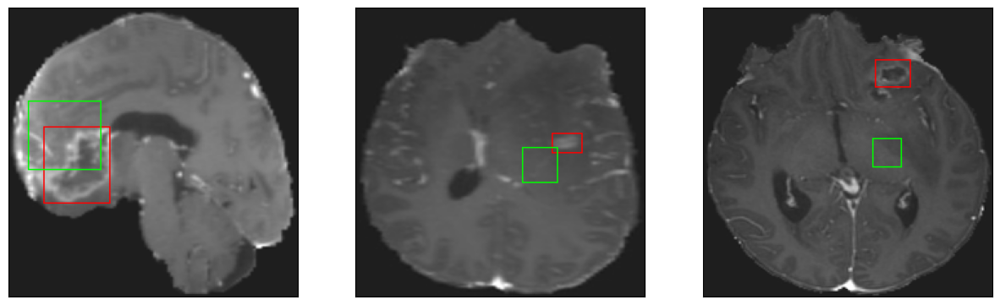

26/26 [==============================] - 4s 143ms/step - loss: 9.1951 - IoU: 0.4347 - val_loss: 12.1289 - val_IoU: 0.3688
Epoch 40/200
26/26 [==============================] - ETA: 0s - loss: 9.1240 - IoU: 0.4228
Epoch 40: val_loss did not improve from 10.58945
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


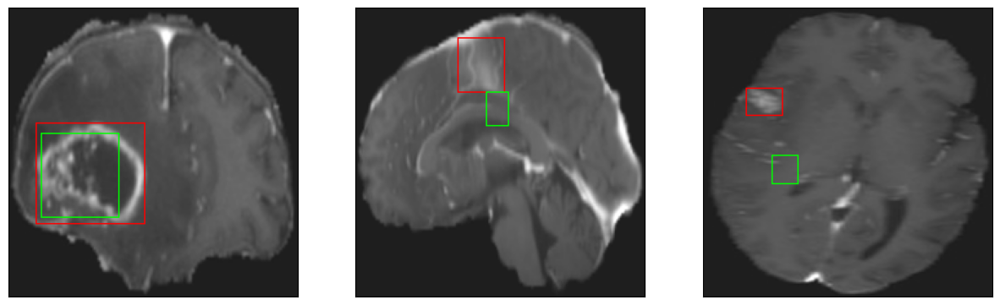

26/26 [==============================] - 3s 118ms/step - loss: 9.1240 - IoU: 0.4228 - val_loss: 12.9068 - val_IoU: 0.3620
Epoch 41/200
26/26 [==============================] - ETA: 0s - loss: 9.0282 - IoU: 0.4382
Epoch 41: val_loss did not improve from 10.58945
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 12ms/step
4


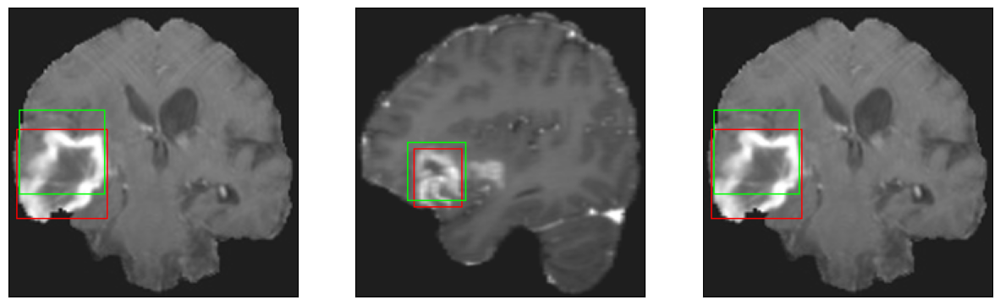

26/26 [==============================] - 4s 148ms/step - loss: 9.0282 - IoU: 0.4382 - val_loss: 12.9605 - val_IoU: 0.3438
Epoch 42/200
26/26 [==============================] - ETA: 0s - loss: 9.0741 - IoU: 0.4333
Epoch 42: val_loss did not improve from 10.58945
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


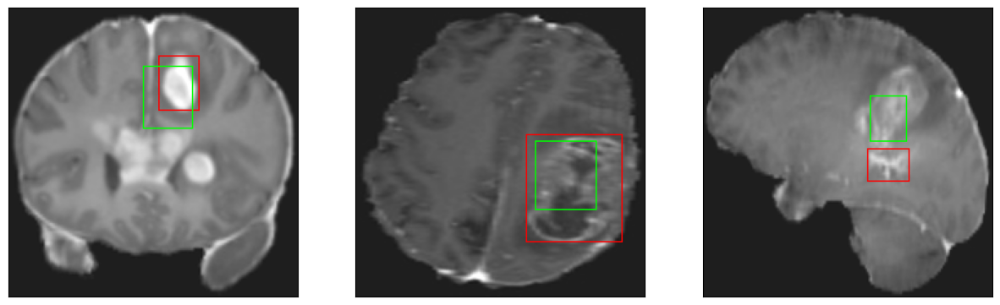

26/26 [==============================] - 3s 131ms/step - loss: 9.0741 - IoU: 0.4333 - val_loss: 10.6532 - val_IoU: 0.4547
Epoch 43/200
26/26 [==============================] - ETA: 0s - loss: 8.0294 - IoU: 0.4761
Epoch 43: val_loss improved from 10.58945 to 10.44563, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4


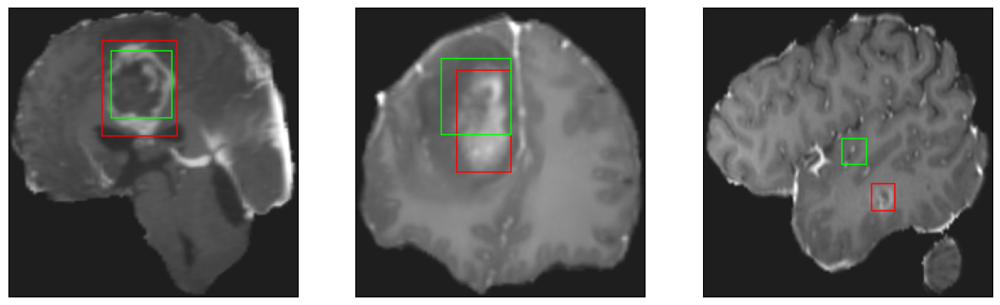

26/26 [==============================] - 9s 366ms/step - loss: 8.0294 - IoU: 0.4761 - val_loss: 10.4456 - val_IoU: 0.4721
Epoch 44/200
26/26 [==============================] - ETA: 0s - loss: 8.6347 - IoU: 0.4456
Epoch 44: val_loss did not improve from 10.44563
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


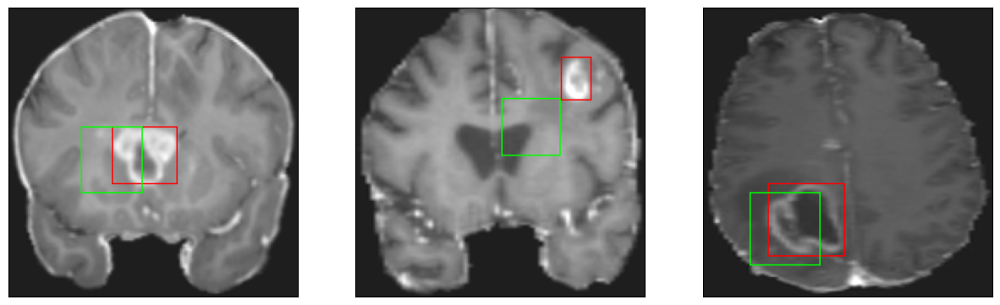

26/26 [==============================] - 3s 127ms/step - loss: 8.6347 - IoU: 0.4456 - val_loss: 12.1030 - val_IoU: 0.3848
Epoch 45/200
26/26 [==============================] - ETA: 0s - loss: 8.8963 - IoU: 0.4361
Epoch 45: val_loss did not improve from 10.44563
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


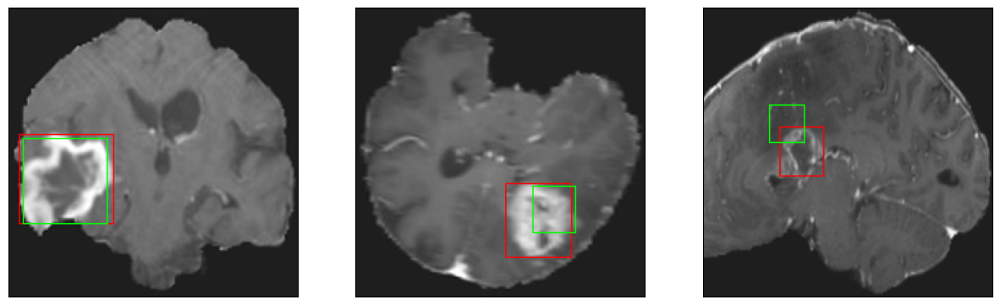

26/26 [==============================] - 4s 172ms/step - loss: 8.8963 - IoU: 0.4361 - val_loss: 13.4178 - val_IoU: 0.3665
Epoch 46/200
26/26 [==============================] - ETA: 0s - loss: 8.5755 - IoU: 0.4518
Epoch 46: val_loss did not improve from 10.44563
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4


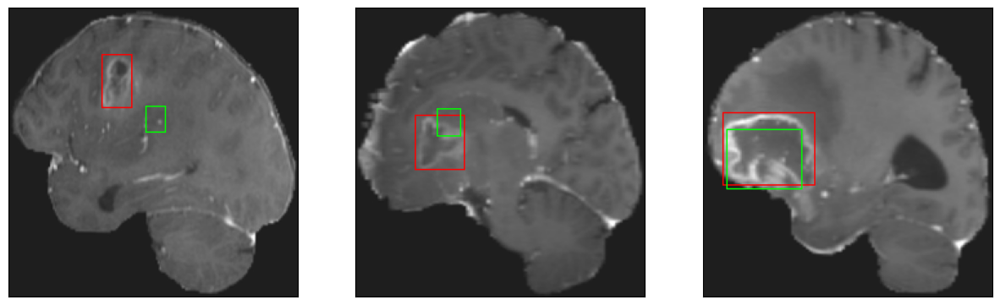

26/26 [==============================] - 4s 149ms/step - loss: 8.5755 - IoU: 0.4518 - val_loss: 18.1845 - val_IoU: 0.2446
Epoch 47/200
26/26 [==============================] - ETA: 0s - loss: 7.9894 - IoU: 0.4655
Epoch 47: val_loss did not improve from 10.44563
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 17ms/step
4


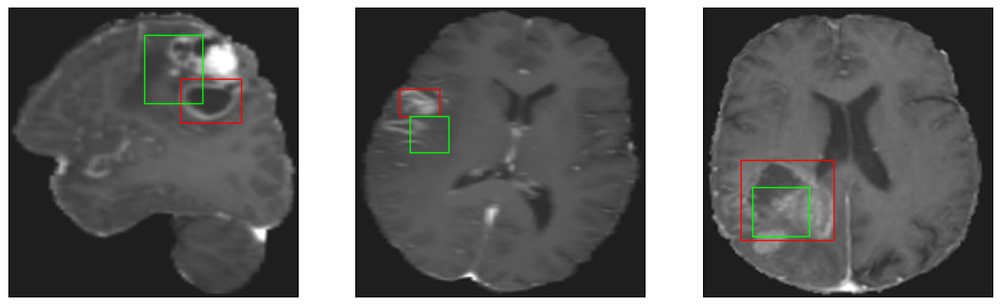

26/26 [==============================] - 4s 149ms/step - loss: 7.9894 - IoU: 0.4655 - val_loss: 12.1350 - val_IoU: 0.3694
Epoch 48/200
26/26 [==============================] - ETA: 0s - loss: 8.3922 - IoU: 0.4514
Epoch 48: val_loss did not improve from 10.44563
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


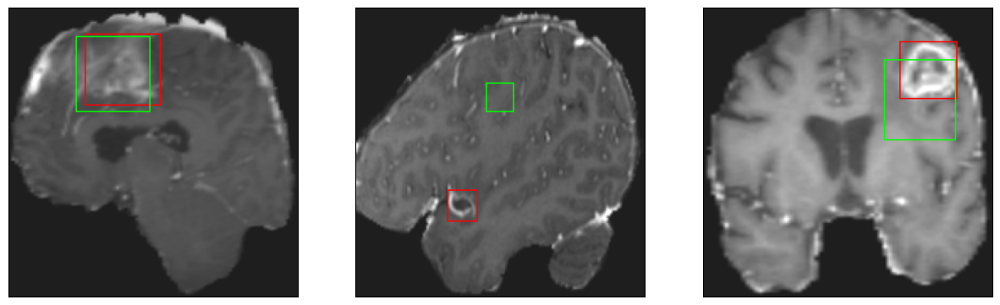

26/26 [==============================] - 4s 138ms/step - loss: 8.3922 - IoU: 0.4514 - val_loss: 10.6811 - val_IoU: 0.4534
Epoch 49/200
26/26 [==============================] - ETA: 0s - loss: 8.6168 - IoU: 0.4359
Epoch 49: val_loss did not improve from 10.44563
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 12ms/step
4


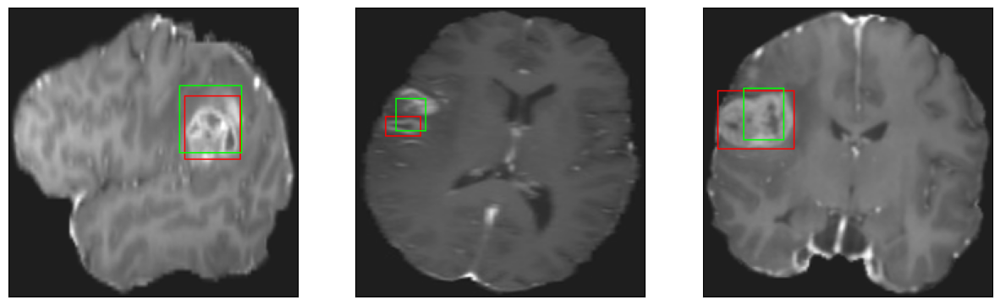

26/26 [==============================] - 4s 140ms/step - loss: 8.6168 - IoU: 0.4359 - val_loss: 12.3171 - val_IoU: 0.3689
Epoch 50/200
26/26 [==============================] - ETA: 0s - loss: 8.7144 - IoU: 0.4182
Epoch 50: val_loss did not improve from 10.44563
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


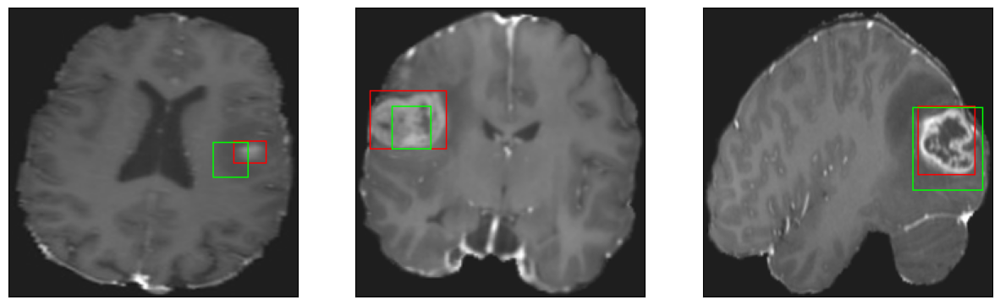

26/26 [==============================] - 4s 139ms/step - loss: 8.7144 - IoU: 0.4182 - val_loss: 11.6279 - val_IoU: 0.4555
Epoch 51/200
26/26 [==============================] - ETA: 0s - loss: 8.1455 - IoU: 0.4590
Epoch 51: val_loss improved from 10.44563 to 10.34930, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 19ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 17ms/step
4


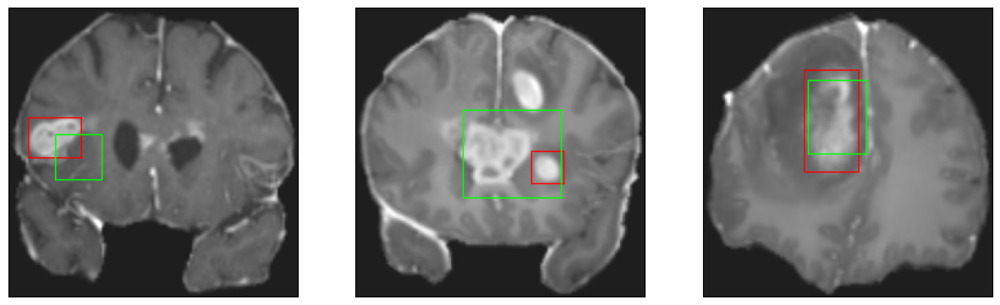

26/26 [==============================] - 10s 377ms/step - loss: 8.1455 - IoU: 0.4590 - val_loss: 10.3493 - val_IoU: 0.4783
Epoch 52/200
26/26 [==============================] - ETA: 0s - loss: 7.8754 - IoU: 0.4736
Epoch 52: val_loss did not improve from 10.34930
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 13ms/step
4


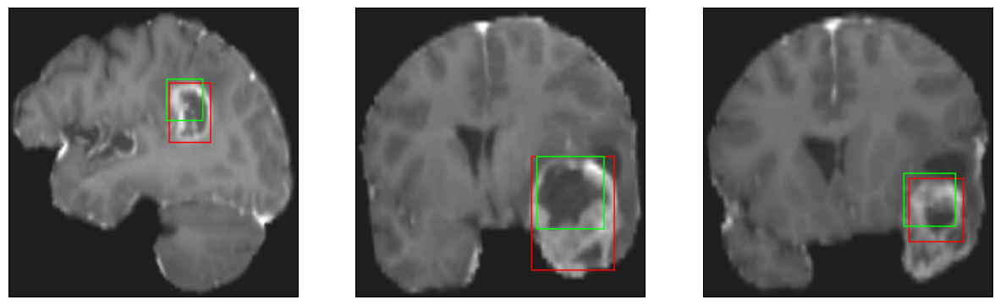

26/26 [==============================] - 3s 131ms/step - loss: 7.8754 - IoU: 0.4736 - val_loss: 11.1100 - val_IoU: 0.4218
Epoch 53/200
26/26 [==============================] - ETA: 0s - loss: 7.9814 - IoU: 0.4686
Epoch 53: val_loss did not improve from 10.34930
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


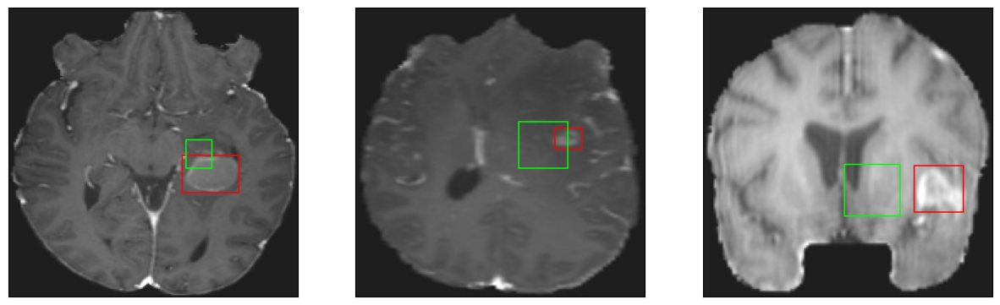

26/26 [==============================] - 4s 171ms/step - loss: 7.9814 - IoU: 0.4686 - val_loss: 11.8252 - val_IoU: 0.4273
Epoch 54/200
26/26 [==============================] - ETA: 0s - loss: 7.7202 - IoU: 0.4813
Epoch 54: val_loss did not improve from 10.34930
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4


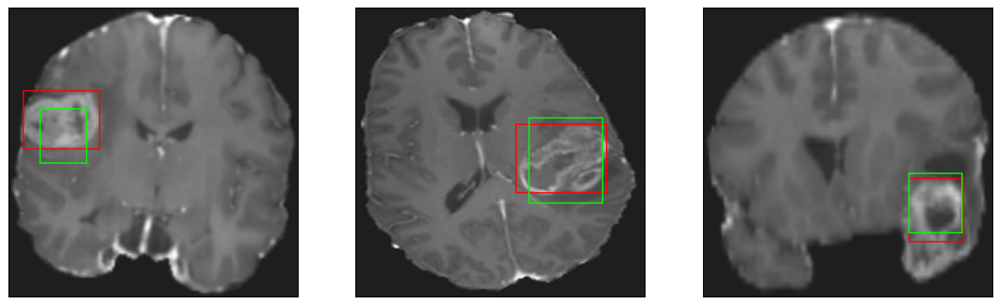

26/26 [==============================] - 4s 151ms/step - loss: 7.7202 - IoU: 0.4813 - val_loss: 11.3084 - val_IoU: 0.4391
Epoch 55/200
26/26 [==============================] - ETA: 0s - loss: 7.5082 - IoU: 0.4861
Epoch 55: val_loss did not improve from 10.34930
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4


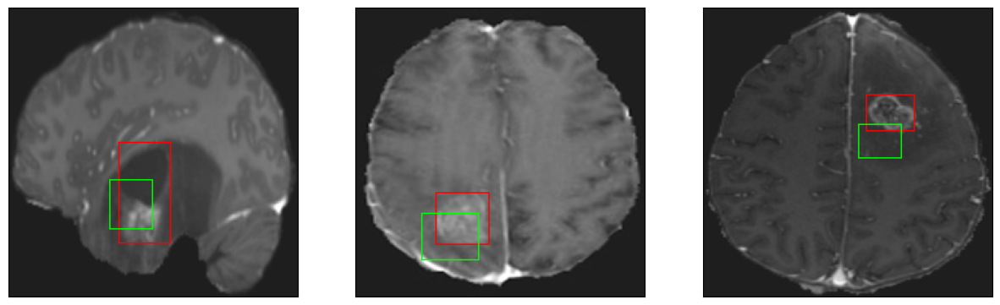

26/26 [==============================] - 3s 125ms/step - loss: 7.5082 - IoU: 0.4861 - val_loss: 11.7140 - val_IoU: 0.4170
Epoch 56/200
26/26 [==============================] - ETA: 0s - loss: 7.7582 - IoU: 0.4667
Epoch 56: val_loss did not improve from 10.34930
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


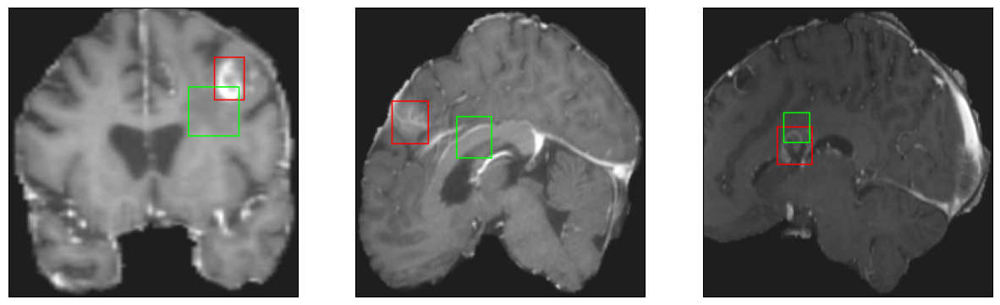

26/26 [==============================] - 3s 124ms/step - loss: 7.7582 - IoU: 0.4667 - val_loss: 11.6342 - val_IoU: 0.4303
Epoch 57/200
26/26 [==============================] - ETA: 0s - loss: 7.4434 - IoU: 0.4828
Epoch 57: val_loss did not improve from 10.34930
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


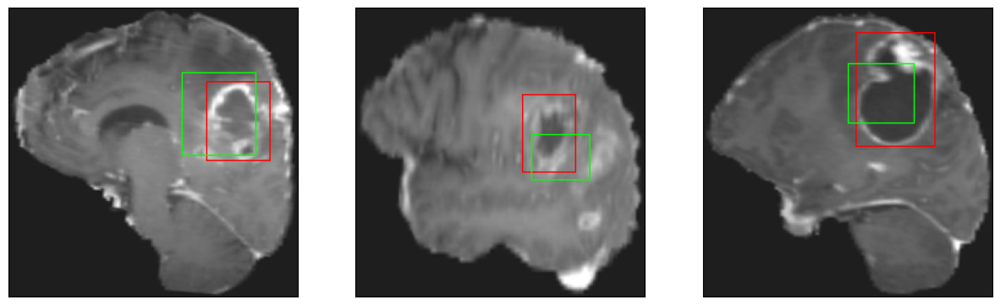

26/26 [==============================] - 3s 126ms/step - loss: 7.4434 - IoU: 0.4828 - val_loss: 11.1782 - val_IoU: 0.4284
Epoch 58/200
26/26 [==============================] - ETA: 0s - loss: 7.5648 - IoU: 0.4881
Epoch 58: val_loss did not improve from 10.34930
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


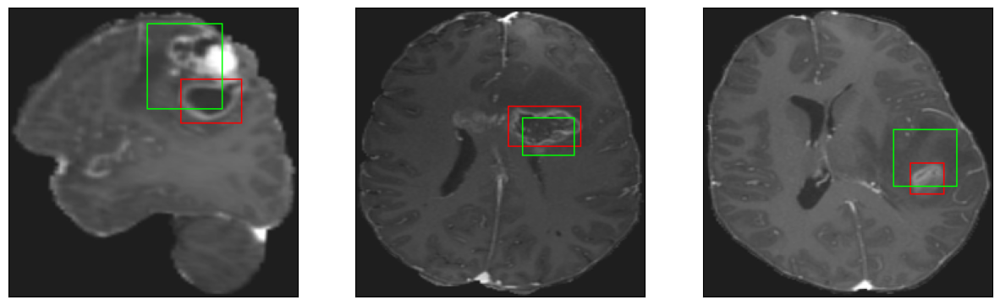

26/26 [==============================] - 4s 136ms/step - loss: 7.5648 - IoU: 0.4881 - val_loss: 11.3550 - val_IoU: 0.4504
Epoch 59/200
26/26 [==============================] - ETA: 0s - loss: 7.2317 - IoU: 0.4938
Epoch 59: val_loss improved from 10.34930 to 9.78993, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


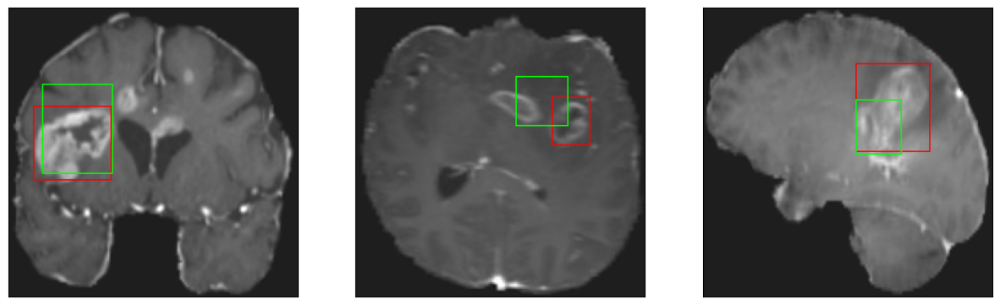

26/26 [==============================] - 8s 313ms/step - loss: 7.2317 - IoU: 0.4938 - val_loss: 9.7899 - val_IoU: 0.5030
Epoch 60/200
26/26 [==============================] - ETA: 0s - loss: 7.4205 - IoU: 0.4840
Epoch 60: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 16ms/step
4


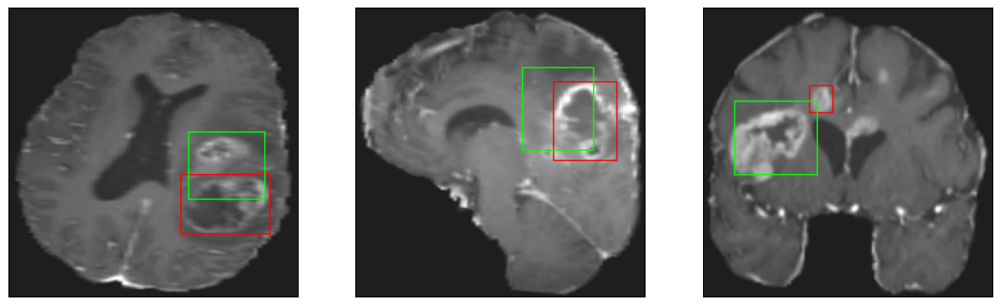

26/26 [==============================] - 4s 148ms/step - loss: 7.4205 - IoU: 0.4840 - val_loss: 12.5542 - val_IoU: 0.3919
Epoch 61/200
26/26 [==============================] - ETA: 0s - loss: 7.3918 - IoU: 0.4940
Epoch 61: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


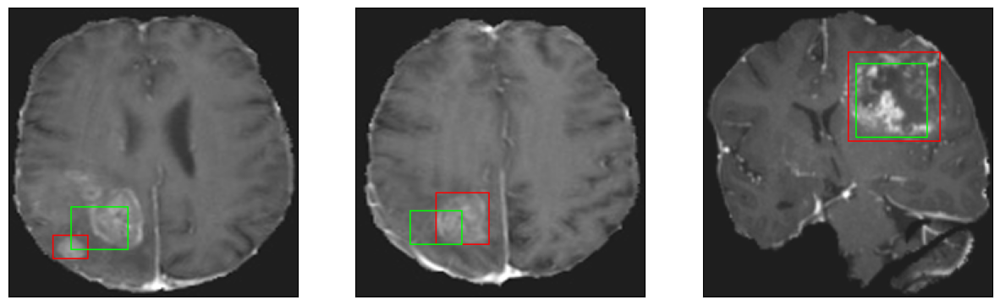

26/26 [==============================] - 4s 146ms/step - loss: 7.3918 - IoU: 0.4940 - val_loss: 10.5923 - val_IoU: 0.4477
Epoch 62/200
26/26 [==============================] - ETA: 0s - loss: 7.8108 - IoU: 0.4700
Epoch 62: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


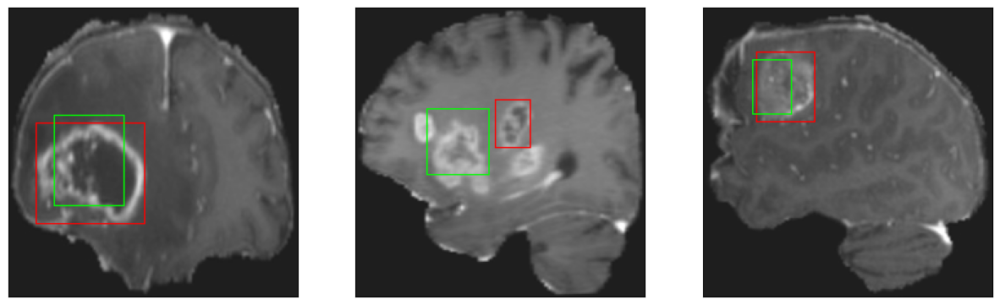

26/26 [==============================] - 4s 141ms/step - loss: 7.8108 - IoU: 0.4700 - val_loss: 11.1909 - val_IoU: 0.3853
Epoch 63/200
26/26 [==============================] - ETA: 0s - loss: 7.4814 - IoU: 0.4826
Epoch 63: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 18ms/step
4


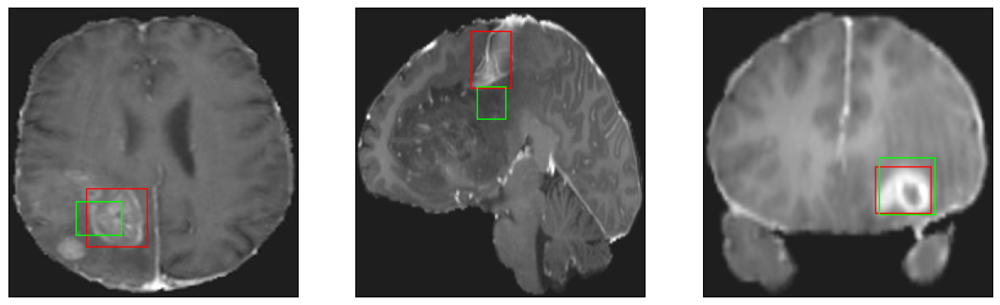

26/26 [==============================] - 4s 142ms/step - loss: 7.4814 - IoU: 0.4826 - val_loss: 13.6486 - val_IoU: 0.3432
Epoch 64/200
26/26 [==============================] - ETA: 0s - loss: 7.3542 - IoU: 0.4839
Epoch 64: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


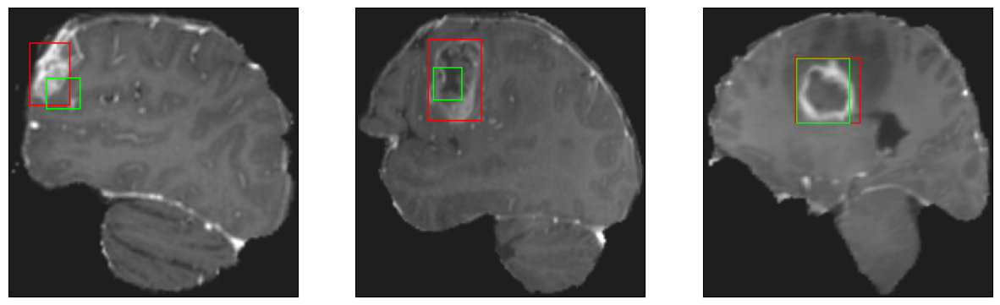

26/26 [==============================] - 4s 134ms/step - loss: 7.3542 - IoU: 0.4839 - val_loss: 11.8519 - val_IoU: 0.4333
Epoch 65/200
26/26 [==============================] - ETA: 0s - loss: 7.7775 - IoU: 0.4702
Epoch 65: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


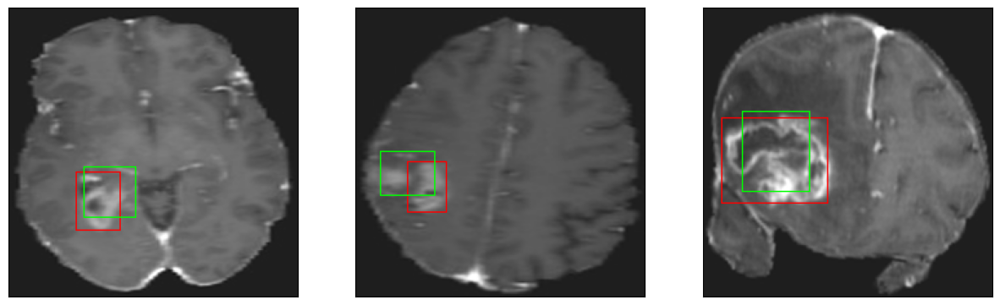

26/26 [==============================] - 3s 128ms/step - loss: 7.7775 - IoU: 0.4702 - val_loss: 12.3253 - val_IoU: 0.3971
Epoch 66/200
26/26 [==============================] - ETA: 0s - loss: 8.0454 - IoU: 0.4522
Epoch 66: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


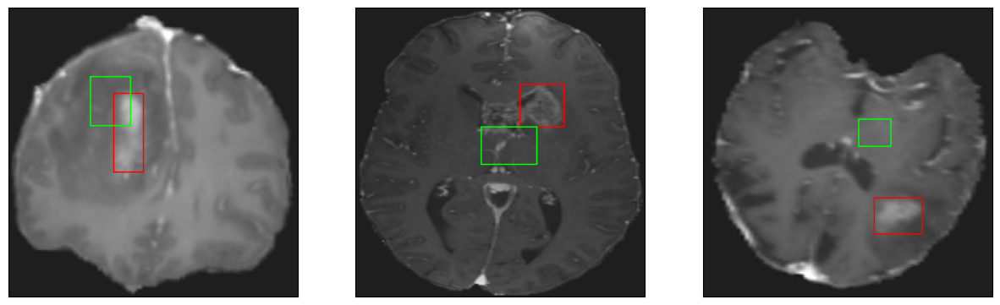

26/26 [==============================] - 3s 128ms/step - loss: 8.0454 - IoU: 0.4522 - val_loss: 10.3865 - val_IoU: 0.4442
Epoch 67/200
26/26 [==============================] - ETA: 0s - loss: 7.8204 - IoU: 0.4678
Epoch 67: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


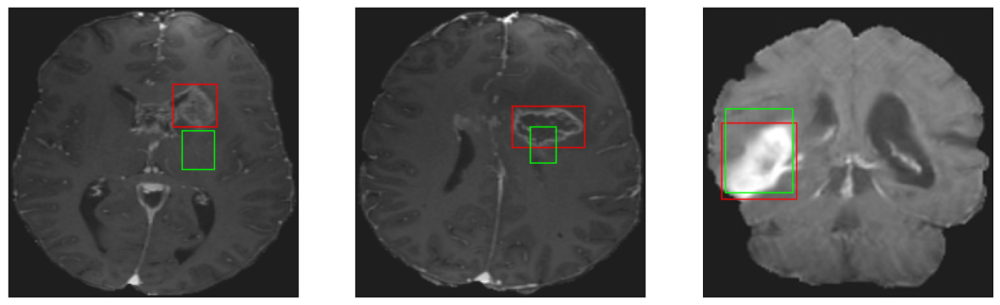

26/26 [==============================] - 4s 136ms/step - loss: 7.8204 - IoU: 0.4678 - val_loss: 16.9381 - val_IoU: 0.2517
Epoch 68/200
26/26 [==============================] - ETA: 0s - loss: 7.4206 - IoU: 0.4732
Epoch 68: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


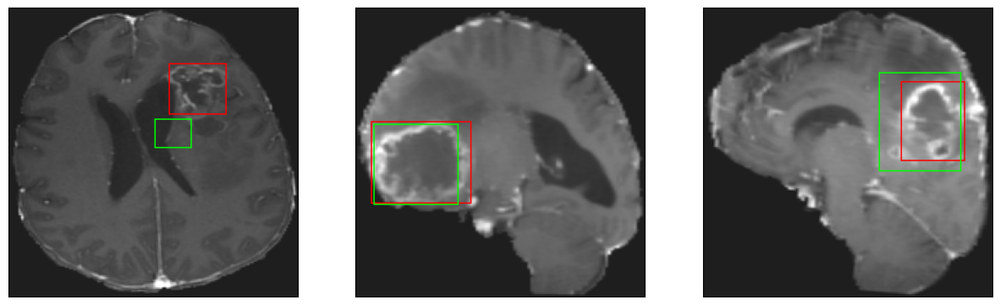

26/26 [==============================] - 3s 123ms/step - loss: 7.4206 - IoU: 0.4732 - val_loss: 11.0319 - val_IoU: 0.4554
Epoch 69/200
26/26 [==============================] - ETA: 0s - loss: 7.2039 - IoU: 0.4868
Epoch 69: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


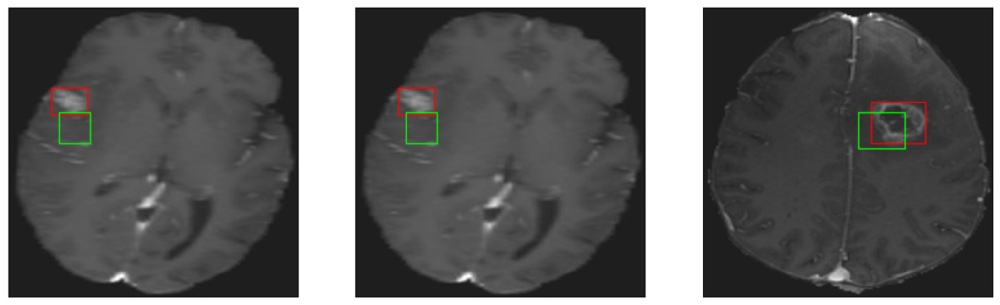

26/26 [==============================] - 3s 122ms/step - loss: 7.2039 - IoU: 0.4868 - val_loss: 11.7689 - val_IoU: 0.3839
Epoch 70/200
26/26 [==============================] - ETA: 0s - loss: 7.2276 - IoU: 0.4904
Epoch 70: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4


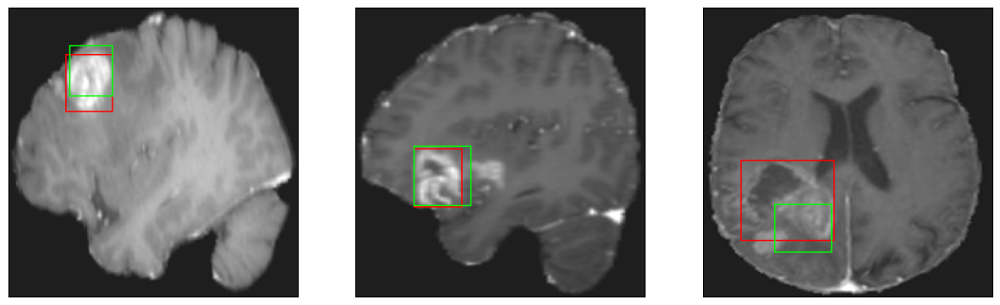

26/26 [==============================] - 4s 152ms/step - loss: 7.2276 - IoU: 0.4904 - val_loss: 12.6781 - val_IoU: 0.4021
Epoch 71/200
26/26 [==============================] - ETA: 0s - loss: 7.0600 - IoU: 0.4962
Epoch 71: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4


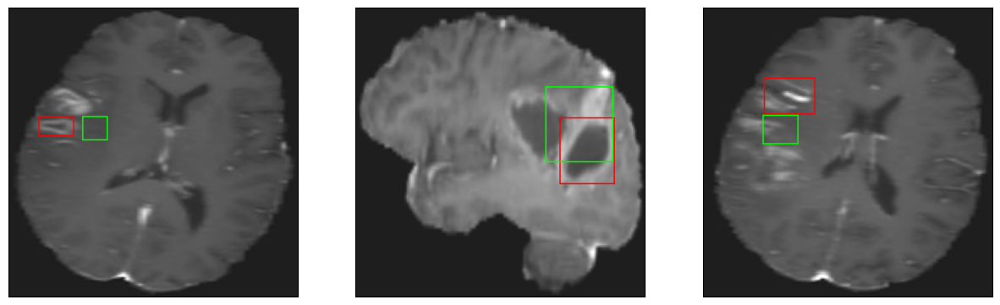

26/26 [==============================] - 3s 133ms/step - loss: 7.0600 - IoU: 0.4962 - val_loss: 12.6154 - val_IoU: 0.4072
Epoch 72/200
26/26 [==============================] - ETA: 0s - loss: 7.4122 - IoU: 0.4820
Epoch 72: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


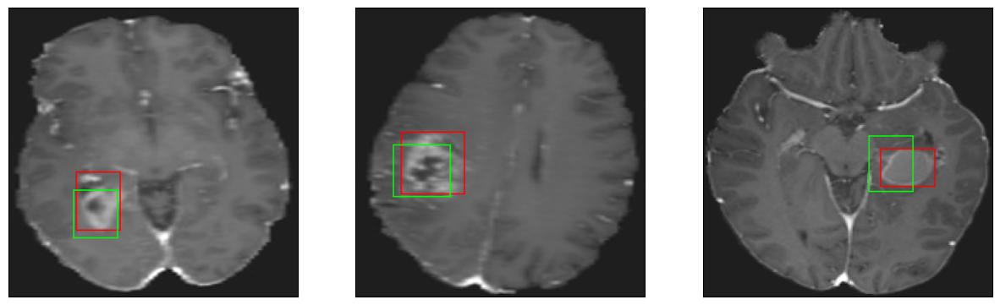

26/26 [==============================] - 3s 129ms/step - loss: 7.4122 - IoU: 0.4820 - val_loss: 11.8314 - val_IoU: 0.4138
Epoch 73/200
26/26 [==============================] - ETA: 0s - loss: 7.7592 - IoU: 0.4749
Epoch 73: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


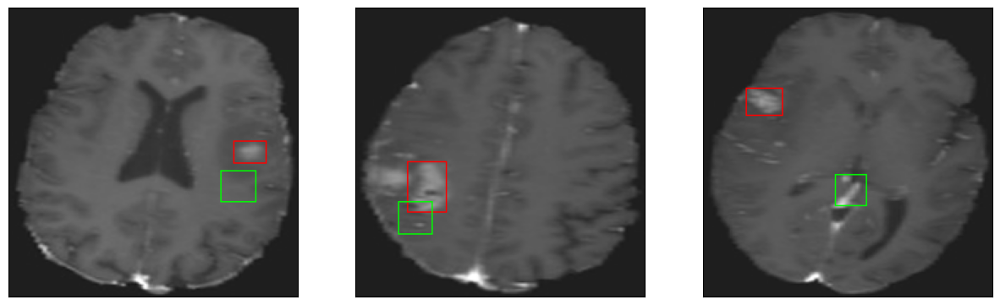

26/26 [==============================] - 4s 136ms/step - loss: 7.7592 - IoU: 0.4749 - val_loss: 12.2343 - val_IoU: 0.4142
Epoch 74/200
26/26 [==============================] - ETA: 0s - loss: 7.9612 - IoU: 0.4603
Epoch 74: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4


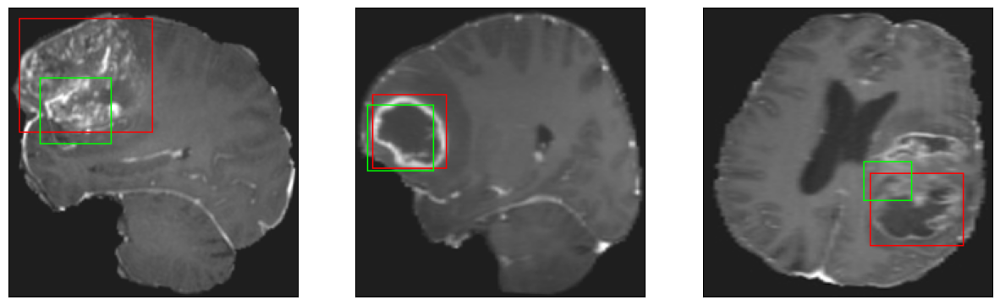

26/26 [==============================] - 4s 148ms/step - loss: 7.9612 - IoU: 0.4603 - val_loss: 22.2700 - val_IoU: 0.1836
Epoch 75/200
26/26 [==============================] - ETA: 0s - loss: 7.5189 - IoU: 0.4795
Epoch 75: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


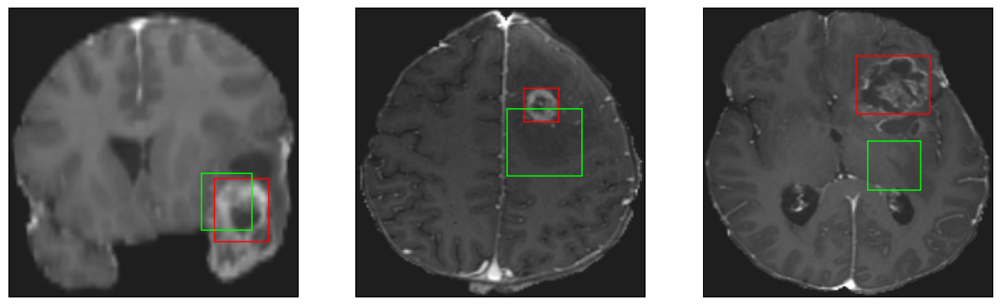

26/26 [==============================] - 3s 125ms/step - loss: 7.5189 - IoU: 0.4795 - val_loss: 13.9683 - val_IoU: 0.3821
Epoch 76/200
26/26 [==============================] - ETA: 0s - loss: 7.3465 - IoU: 0.4902
Epoch 76: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


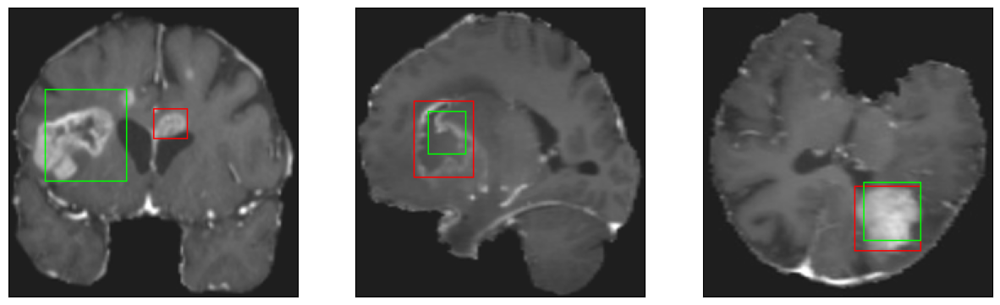

26/26 [==============================] - 3s 127ms/step - loss: 7.3465 - IoU: 0.4902 - val_loss: 11.7763 - val_IoU: 0.4524
Epoch 77/200
26/26 [==============================] - ETA: 0s - loss: 7.1347 - IoU: 0.5003
Epoch 77: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 15ms/step
4


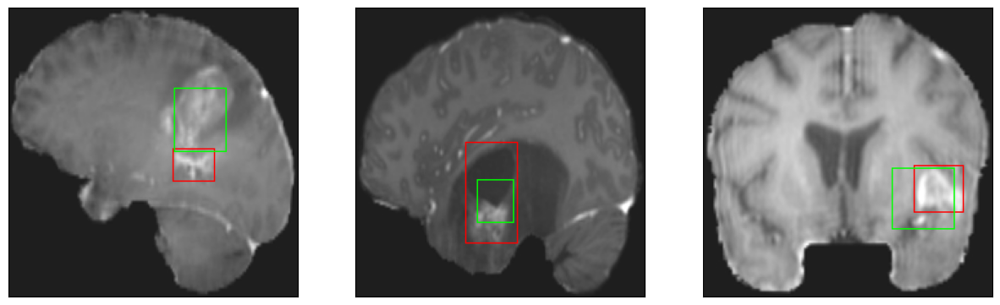

26/26 [==============================] - 4s 156ms/step - loss: 7.1347 - IoU: 0.5003 - val_loss: 10.7593 - val_IoU: 0.4620
Epoch 78/200
26/26 [==============================] - ETA: 0s - loss: 7.0924 - IoU: 0.5066
Epoch 78: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


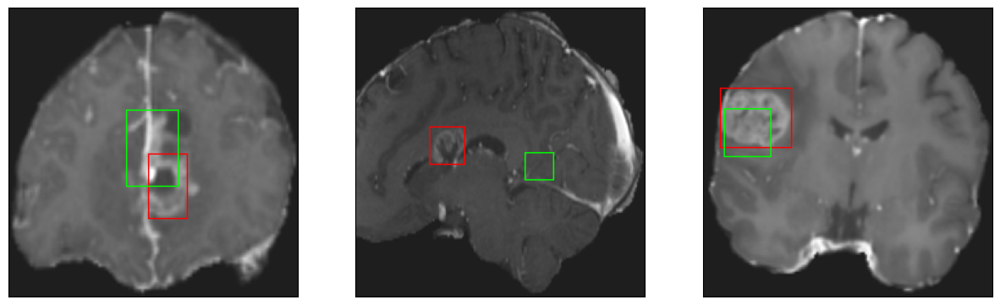

26/26 [==============================] - 3s 130ms/step - loss: 7.0924 - IoU: 0.5066 - val_loss: 10.6342 - val_IoU: 0.4855
Epoch 79/200
26/26 [==============================] - ETA: 0s - loss: 7.2597 - IoU: 0.4934
Epoch 79: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


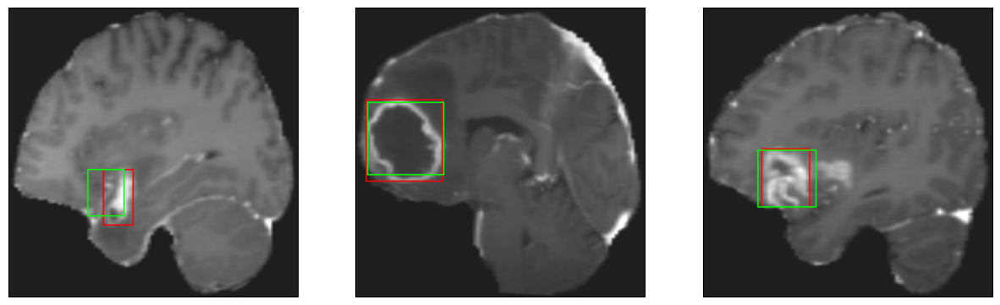

26/26 [==============================] - 3s 128ms/step - loss: 7.2597 - IoU: 0.4934 - val_loss: 12.8195 - val_IoU: 0.3832
Epoch 80/200
26/26 [==============================] - ETA: 0s - loss: 6.9745 - IoU: 0.5007
Epoch 80: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4


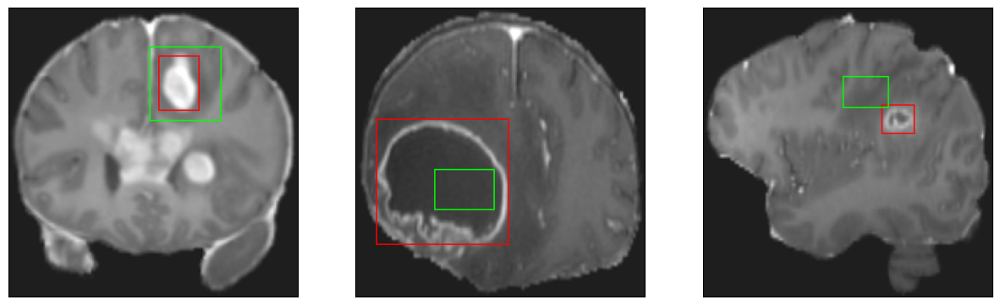

26/26 [==============================] - 4s 158ms/step - loss: 6.9745 - IoU: 0.5007 - val_loss: 16.3996 - val_IoU: 0.3038
Epoch 81/200
26/26 [==============================] - ETA: 0s - loss: 7.1433 - IoU: 0.4930
Epoch 81: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 11ms/step
4


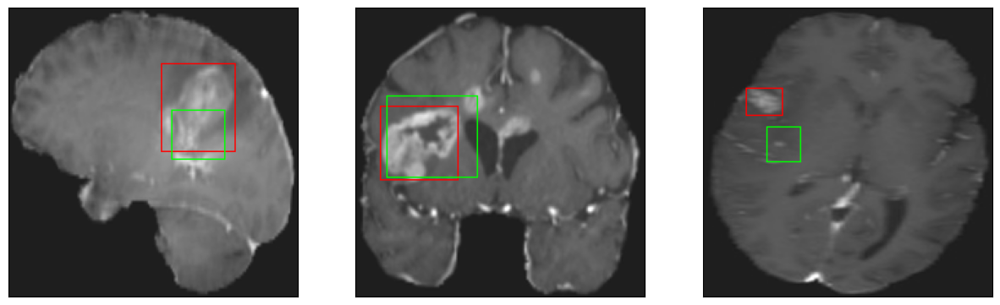

26/26 [==============================] - 4s 142ms/step - loss: 7.1433 - IoU: 0.4930 - val_loss: 10.6549 - val_IoU: 0.4639
Epoch 82/200
26/26 [==============================] - ETA: 0s - loss: 6.8383 - IoU: 0.5016
Epoch 82: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


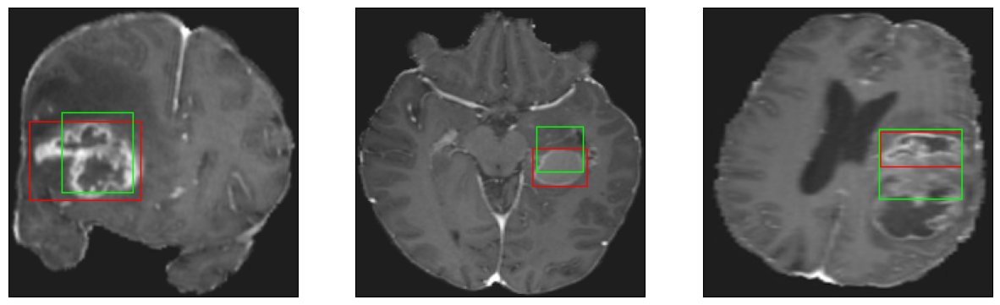

26/26 [==============================] - 3s 131ms/step - loss: 6.8383 - IoU: 0.5016 - val_loss: 9.9464 - val_IoU: 0.4932
Epoch 83/200
26/26 [==============================] - ETA: 0s - loss: 6.8620 - IoU: 0.5123
Epoch 83: val_loss did not improve from 9.78993
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


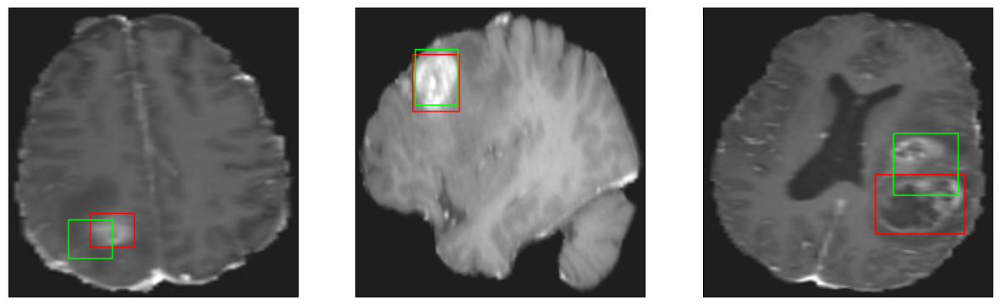

26/26 [==============================] - 3s 132ms/step - loss: 6.8620 - IoU: 0.5123 - val_loss: 11.4126 - val_IoU: 0.4352
Epoch 84/200
26/26 [==============================] - ETA: 0s - loss: 6.5005 - IoU: 0.5309
Epoch 84: val_loss improved from 9.78993 to 9.74410, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 16ms/step
4


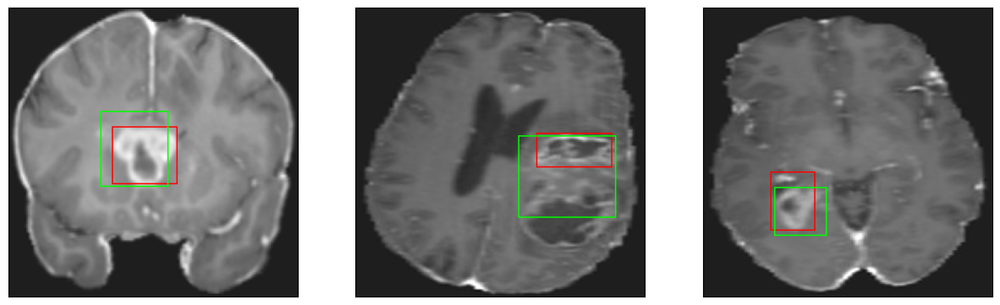

26/26 [==============================] - 11s 417ms/step - loss: 6.5005 - IoU: 0.5309 - val_loss: 9.7441 - val_IoU: 0.5030
Epoch 85/200
26/26 [==============================] - ETA: 0s - loss: 6.3774 - IoU: 0.5358
Epoch 85: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


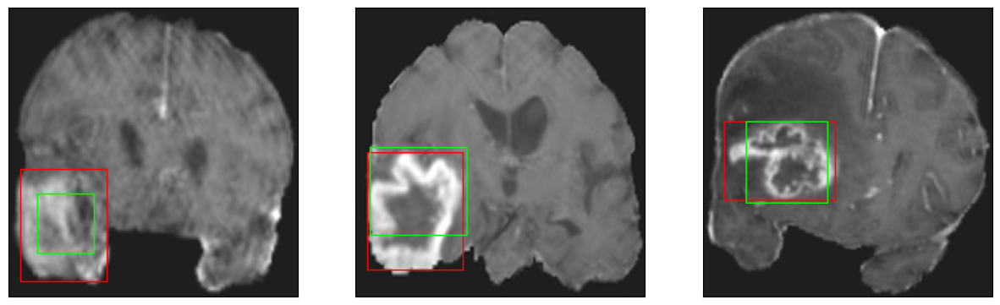

26/26 [==============================] - 3s 125ms/step - loss: 6.3774 - IoU: 0.5358 - val_loss: 11.0289 - val_IoU: 0.4627
Epoch 86/200
26/26 [==============================] - ETA: 0s - loss: 6.6900 - IoU: 0.5205
Epoch 86: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


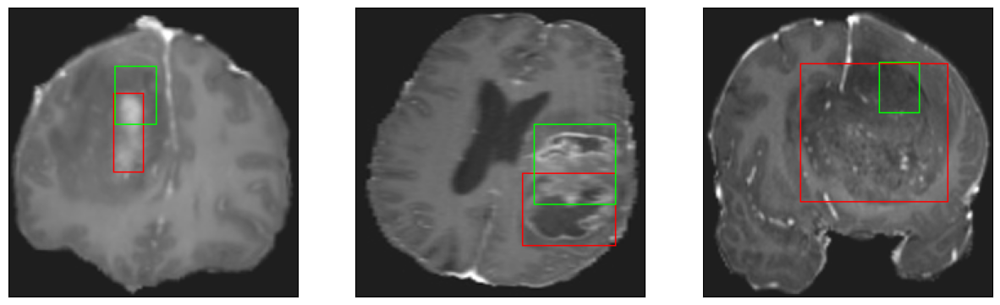

26/26 [==============================] - 4s 140ms/step - loss: 6.6900 - IoU: 0.5205 - val_loss: 11.3477 - val_IoU: 0.4704
Epoch 87/200
26/26 [==============================] - ETA: 0s - loss: 6.9276 - IoU: 0.5096
Epoch 87: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4


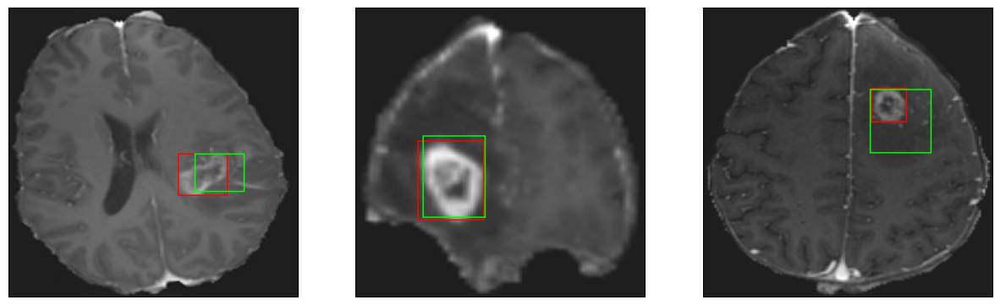

26/26 [==============================] - 4s 142ms/step - loss: 6.9276 - IoU: 0.5096 - val_loss: 10.7897 - val_IoU: 0.4758
Epoch 88/200
26/26 [==============================] - ETA: 0s - loss: 6.6397 - IoU: 0.5134
Epoch 88: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


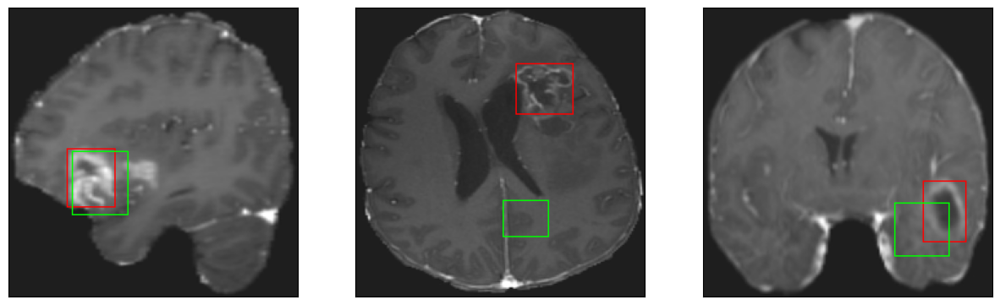

26/26 [==============================] - 4s 140ms/step - loss: 6.6397 - IoU: 0.5134 - val_loss: 11.8051 - val_IoU: 0.4197
Epoch 89/200
26/26 [==============================] - ETA: 0s - loss: 6.5881 - IoU: 0.5168
Epoch 89: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


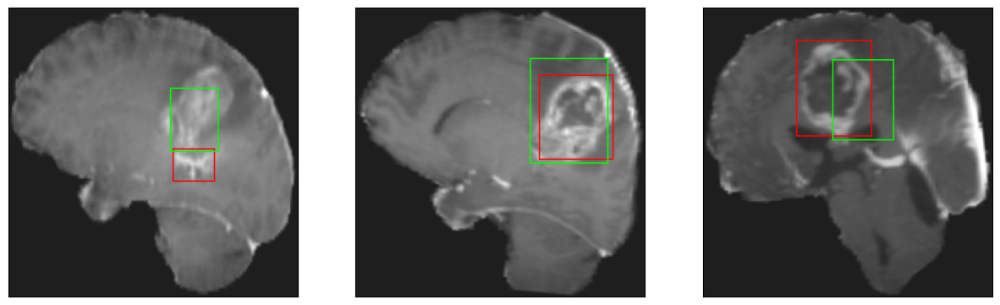

26/26 [==============================] - 3s 124ms/step - loss: 6.5881 - IoU: 0.5168 - val_loss: 9.9691 - val_IoU: 0.5080
Epoch 90/200
26/26 [==============================] - ETA: 0s - loss: 6.3927 - IoU: 0.5354
Epoch 90: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


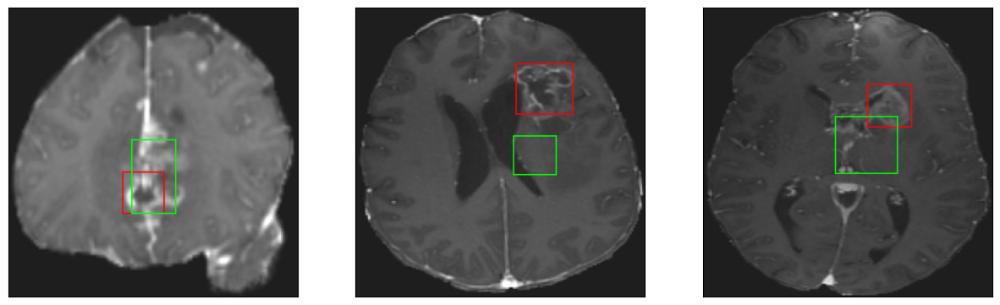

26/26 [==============================] - 3s 131ms/step - loss: 6.3927 - IoU: 0.5354 - val_loss: 9.7522 - val_IoU: 0.4860
Epoch 91/200
26/26 [==============================] - ETA: 0s - loss: 6.5933 - IoU: 0.5167
Epoch 91: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4


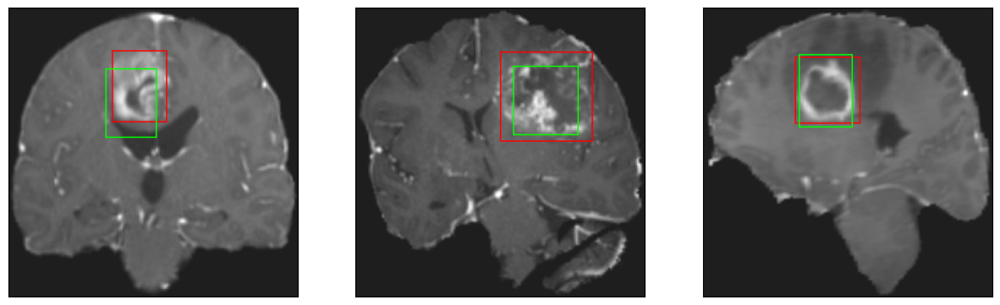

26/26 [==============================] - 4s 149ms/step - loss: 6.5933 - IoU: 0.5167 - val_loss: 10.4731 - val_IoU: 0.4893
Epoch 92/200
26/26 [==============================] - ETA: 0s - loss: 6.6510 - IoU: 0.5173
Epoch 92: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


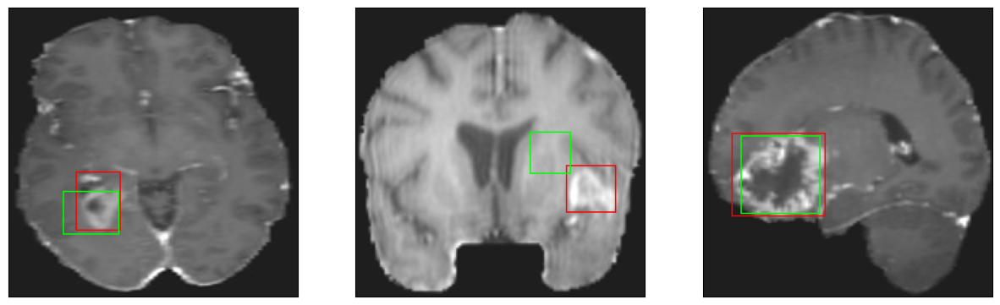

26/26 [==============================] - 4s 145ms/step - loss: 6.6510 - IoU: 0.5173 - val_loss: 12.4593 - val_IoU: 0.3918
Epoch 93/200
26/26 [==============================] - ETA: 0s - loss: 6.2843 - IoU: 0.5327
Epoch 93: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


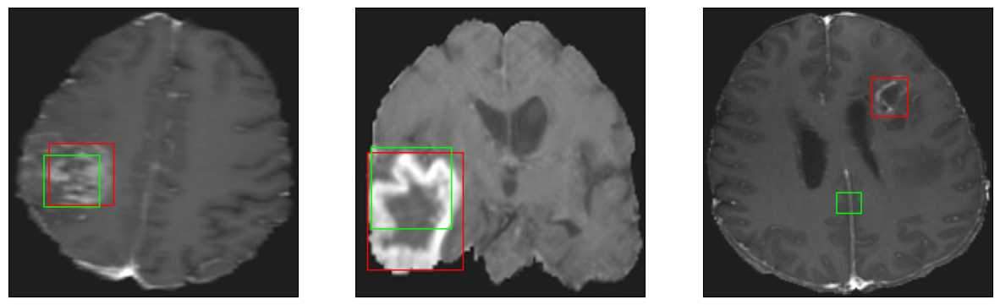

26/26 [==============================] - 3s 130ms/step - loss: 6.2843 - IoU: 0.5327 - val_loss: 10.8641 - val_IoU: 0.4371
Epoch 94/200
26/26 [==============================] - ETA: 0s - loss: 6.3484 - IoU: 0.5365
Epoch 94: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


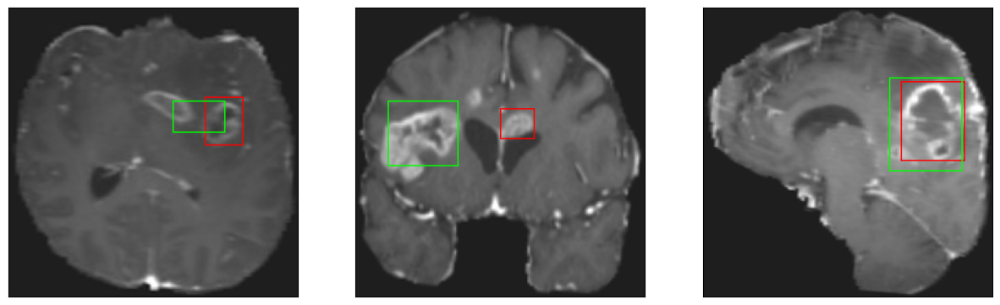

26/26 [==============================] - 3s 127ms/step - loss: 6.3484 - IoU: 0.5365 - val_loss: 15.1628 - val_IoU: 0.3166
Epoch 95/200
26/26 [==============================] - ETA: 0s - loss: 6.8854 - IoU: 0.5067
Epoch 95: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 12ms/step
4


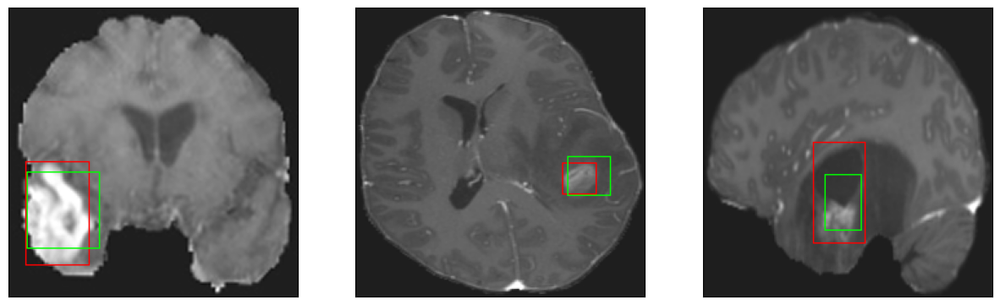

26/26 [==============================] - 4s 148ms/step - loss: 6.8854 - IoU: 0.5067 - val_loss: 10.2181 - val_IoU: 0.5044
Epoch 96/200
26/26 [==============================] - ETA: 0s - loss: 6.6030 - IoU: 0.5164
Epoch 96: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


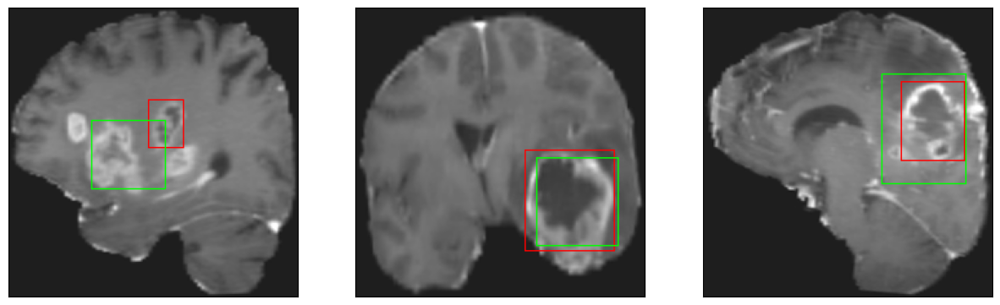

26/26 [==============================] - 3s 126ms/step - loss: 6.6030 - IoU: 0.5164 - val_loss: 9.8836 - val_IoU: 0.4966
Epoch 97/200
26/26 [==============================] - ETA: 0s - loss: 6.5991 - IoU: 0.5243
Epoch 97: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


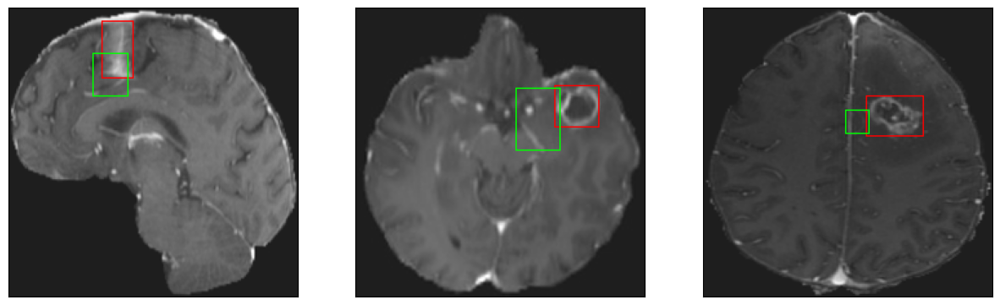

26/26 [==============================] - 3s 129ms/step - loss: 6.5991 - IoU: 0.5243 - val_loss: 14.4737 - val_IoU: 0.3037
Epoch 98/200
26/26 [==============================] - ETA: 0s - loss: 6.3109 - IoU: 0.5414
Epoch 98: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


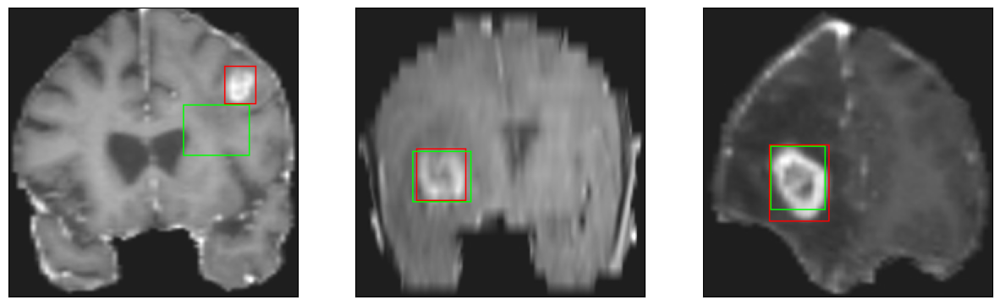

26/26 [==============================] - 3s 131ms/step - loss: 6.3109 - IoU: 0.5414 - val_loss: 13.0435 - val_IoU: 0.3656
Epoch 99/200
26/26 [==============================] - ETA: 0s - loss: 6.2989 - IoU: 0.5303
Epoch 99: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4


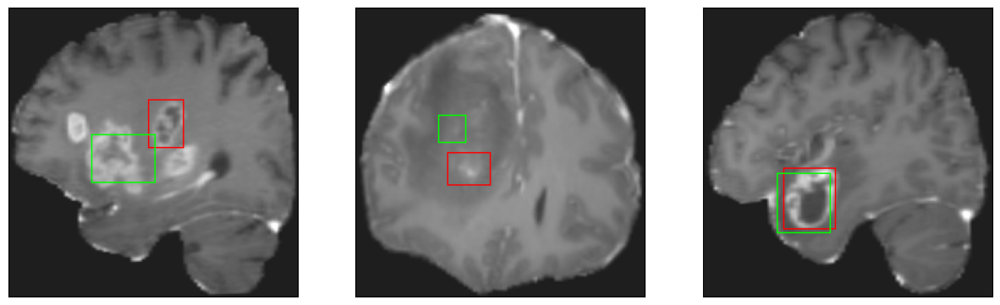

26/26 [==============================] - 4s 155ms/step - loss: 6.2989 - IoU: 0.5303 - val_loss: 14.7179 - val_IoU: 0.3349
Epoch 100/200
26/26 [==============================] - ETA: 0s - loss: 6.4050 - IoU: 0.5211
Epoch 100: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


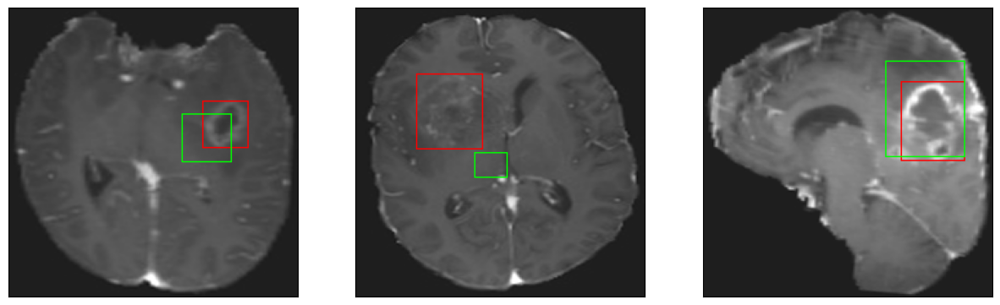

26/26 [==============================] - 4s 142ms/step - loss: 6.4050 - IoU: 0.5211 - val_loss: 10.8155 - val_IoU: 0.4156
Epoch 101/200
26/26 [==============================] - ETA: 0s - loss: 6.0054 - IoU: 0.5472
Epoch 101: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


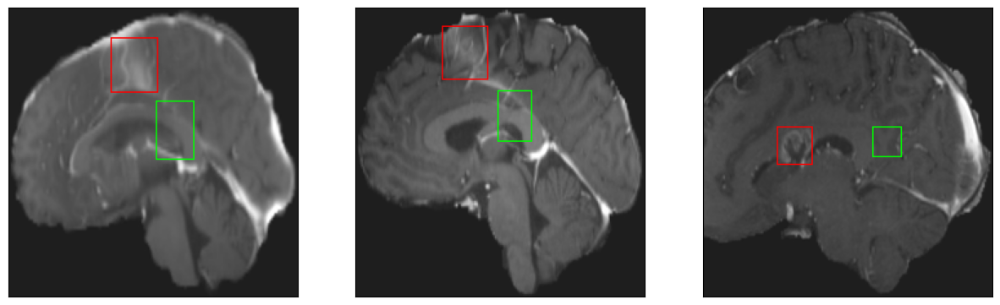

26/26 [==============================] - 3s 118ms/step - loss: 6.0054 - IoU: 0.5472 - val_loss: 12.4771 - val_IoU: 0.3924
Epoch 102/200
26/26 [==============================] - ETA: 0s - loss: 6.0495 - IoU: 0.5462
Epoch 102: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4


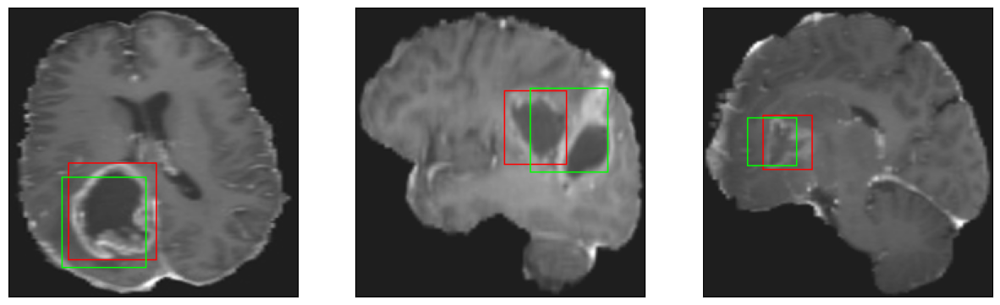

26/26 [==============================] - 3s 133ms/step - loss: 6.0495 - IoU: 0.5462 - val_loss: 9.8297 - val_IoU: 0.4833
Epoch 103/200
26/26 [==============================] - ETA: 0s - loss: 6.4984 - IoU: 0.5187
Epoch 103: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


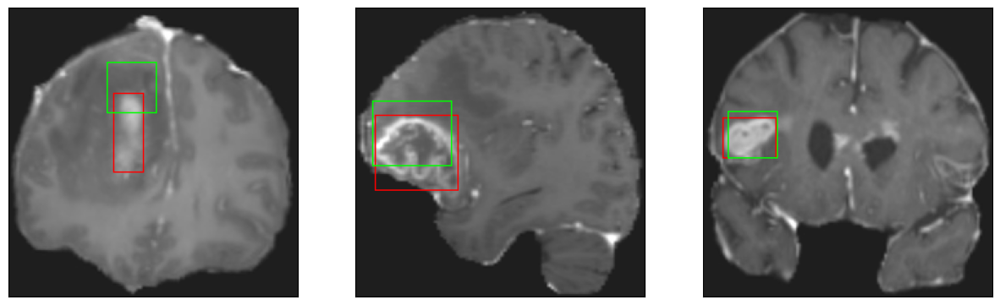

26/26 [==============================] - 3s 129ms/step - loss: 6.4984 - IoU: 0.5187 - val_loss: 12.9968 - val_IoU: 0.3655
Epoch 104/200
26/26 [==============================] - ETA: 0s - loss: 6.5016 - IoU: 0.5275
Epoch 104: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


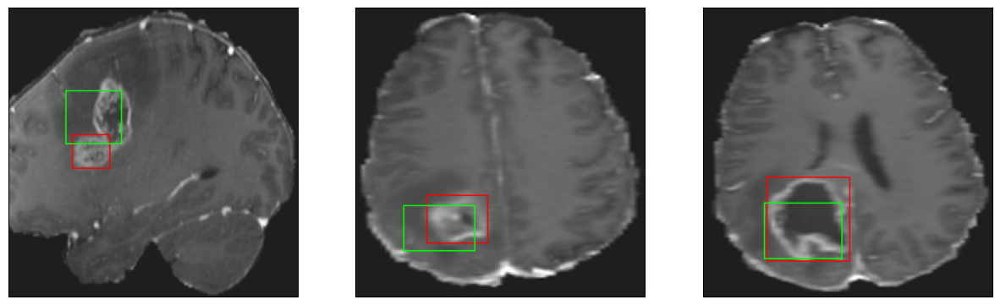

26/26 [==============================] - 3s 124ms/step - loss: 6.5016 - IoU: 0.5275 - val_loss: 12.5193 - val_IoU: 0.4150
Epoch 105/200
26/26 [==============================] - ETA: 0s - loss: 6.5847 - IoU: 0.5175
Epoch 105: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


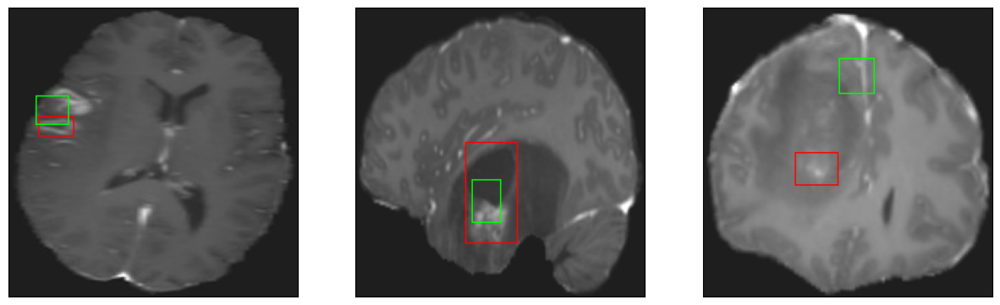

26/26 [==============================] - 3s 126ms/step - loss: 6.5847 - IoU: 0.5175 - val_loss: 11.3799 - val_IoU: 0.4555
Epoch 106/200
26/26 [==============================] - ETA: 0s - loss: 6.2269 - IoU: 0.5443
Epoch 106: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 14ms/step
4


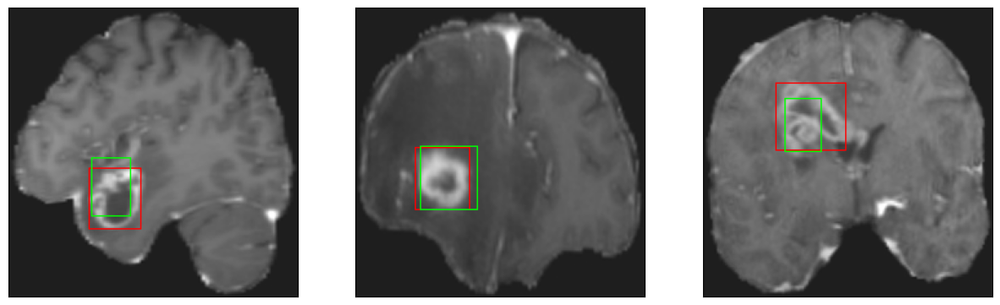

26/26 [==============================] - 4s 143ms/step - loss: 6.2269 - IoU: 0.5443 - val_loss: 10.5585 - val_IoU: 0.4693
Epoch 107/200
26/26 [==============================] - ETA: 0s - loss: 6.0597 - IoU: 0.5471
Epoch 107: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


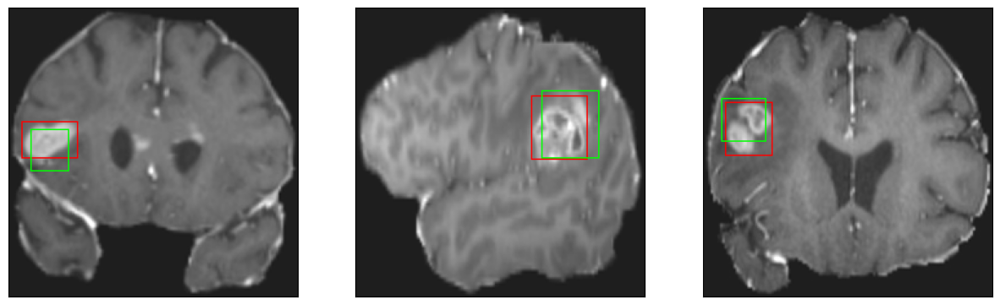

26/26 [==============================] - 4s 142ms/step - loss: 6.0597 - IoU: 0.5471 - val_loss: 10.3142 - val_IoU: 0.5049
Epoch 108/200
26/26 [==============================] - ETA: 0s - loss: 5.8884 - IoU: 0.5520
Epoch 108: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


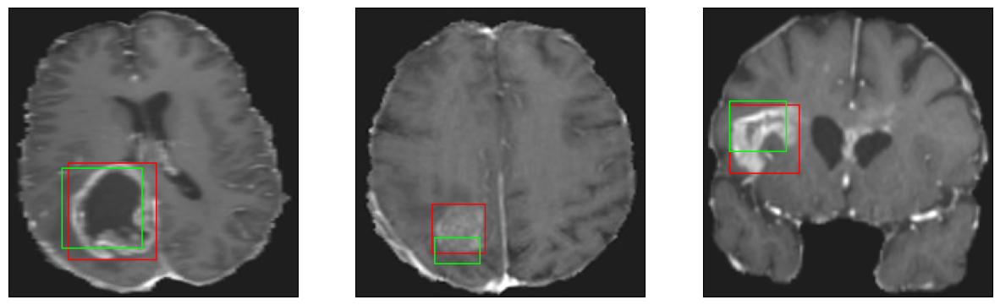

26/26 [==============================] - 3s 130ms/step - loss: 5.8884 - IoU: 0.5520 - val_loss: 11.1908 - val_IoU: 0.4538
Epoch 109/200
26/26 [==============================] - ETA: 0s - loss: 6.5206 - IoU: 0.5229
Epoch 109: val_loss did not improve from 9.74410
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


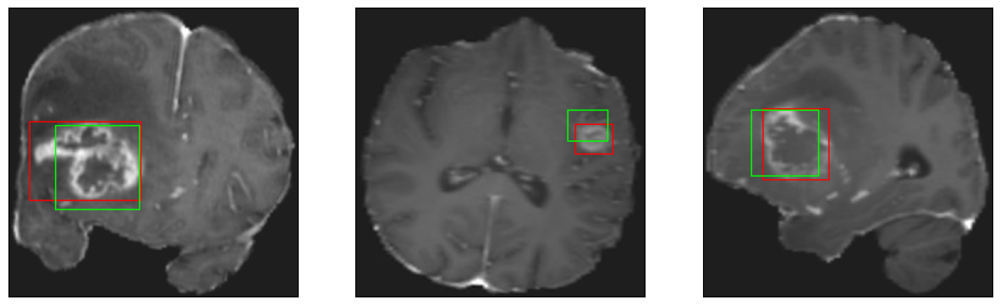

26/26 [==============================] - 3s 123ms/step - loss: 6.5206 - IoU: 0.5229 - val_loss: 10.3344 - val_IoU: 0.4868
Epoch 110/200
26/26 [==============================] - ETA: 0s - loss: 6.1686 - IoU: 0.5426
Epoch 110: val_loss improved from 9.74410 to 9.55885, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 16ms/step
4


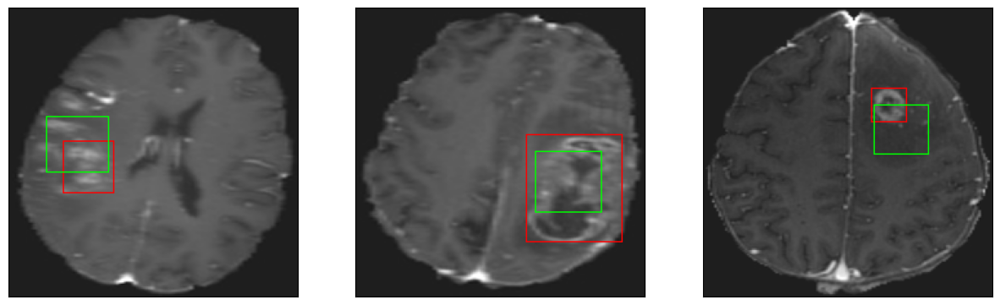

26/26 [==============================] - 10s 410ms/step - loss: 6.1686 - IoU: 0.5426 - val_loss: 9.5588 - val_IoU: 0.4937
Epoch 111/200
26/26 [==============================] - ETA: 0s - loss: 6.0694 - IoU: 0.5516
Epoch 111: val_loss did not improve from 9.55885
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


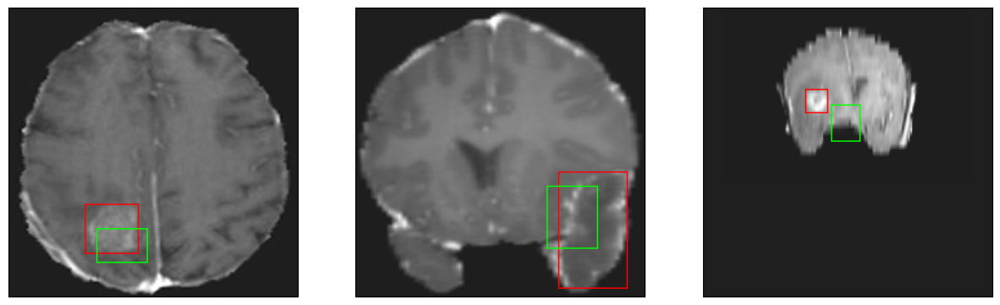

26/26 [==============================] - 3s 127ms/step - loss: 6.0694 - IoU: 0.5516 - val_loss: 9.8375 - val_IoU: 0.5022
Epoch 112/200
26/26 [==============================] - ETA: 0s - loss: 6.1072 - IoU: 0.5441
Epoch 112: val_loss did not improve from 9.55885
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 16ms/step
4


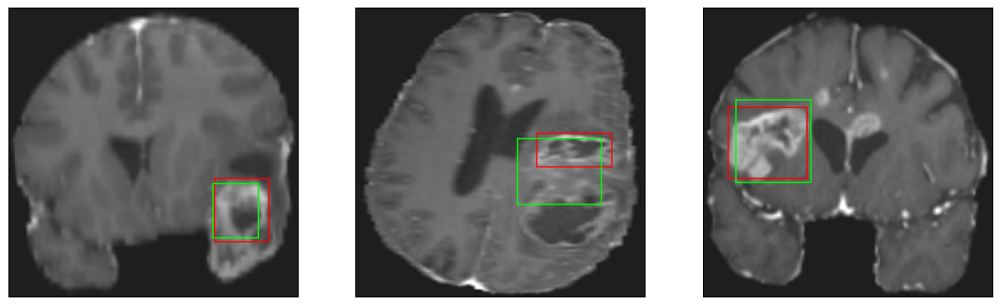

26/26 [==============================] - 4s 152ms/step - loss: 6.1072 - IoU: 0.5441 - val_loss: 10.4195 - val_IoU: 0.4564
Epoch 113/200
26/26 [==============================] - ETA: 0s - loss: 6.1977 - IoU: 0.5346
Epoch 113: val_loss improved from 9.55885 to 9.28756, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4


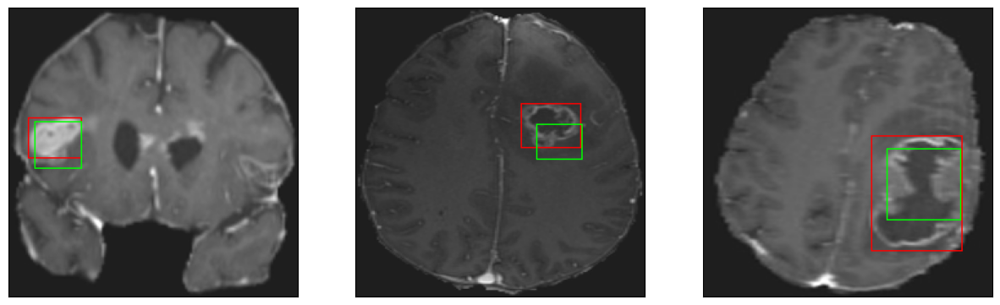

26/26 [==============================] - 5s 203ms/step - loss: 6.1977 - IoU: 0.5346 - val_loss: 9.2876 - val_IoU: 0.5200
Epoch 114/200
26/26 [==============================] - ETA: 0s - loss: 6.1832 - IoU: 0.5391
Epoch 114: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 19ms/step
4
8/8 [==============================] - 0s 17ms/step
4


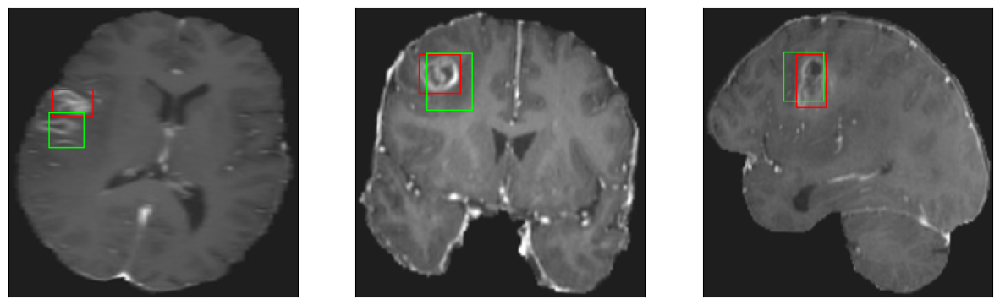

26/26 [==============================] - 4s 163ms/step - loss: 6.1832 - IoU: 0.5391 - val_loss: 9.6189 - val_IoU: 0.5229
Epoch 115/200
26/26 [==============================] - ETA: 0s - loss: 6.3518 - IoU: 0.5225
Epoch 115: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


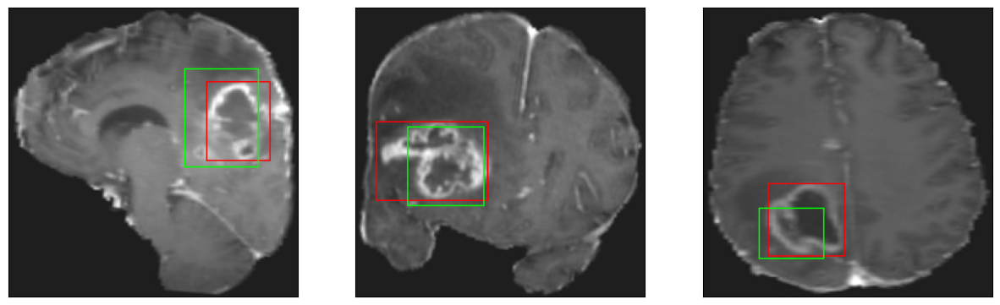

26/26 [==============================] - 3s 124ms/step - loss: 6.3518 - IoU: 0.5225 - val_loss: 10.0042 - val_IoU: 0.4661
Epoch 116/200
26/26 [==============================] - ETA: 0s - loss: 5.8125 - IoU: 0.5600
Epoch 116: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


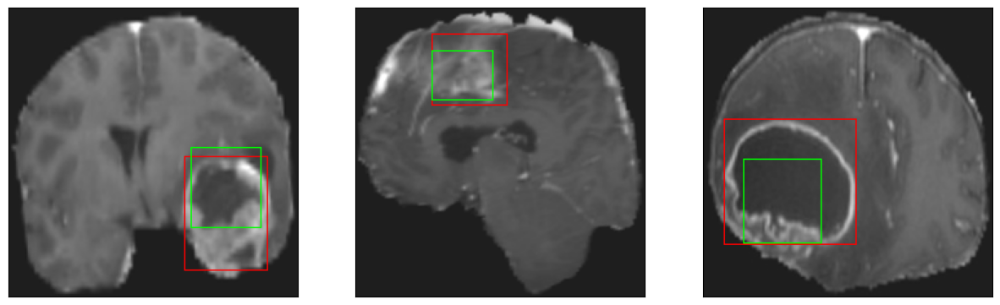

26/26 [==============================] - 3s 128ms/step - loss: 5.8125 - IoU: 0.5600 - val_loss: 9.8409 - val_IoU: 0.4950
Epoch 117/200
26/26 [==============================] - ETA: 0s - loss: 6.2781 - IoU: 0.5357
Epoch 117: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4


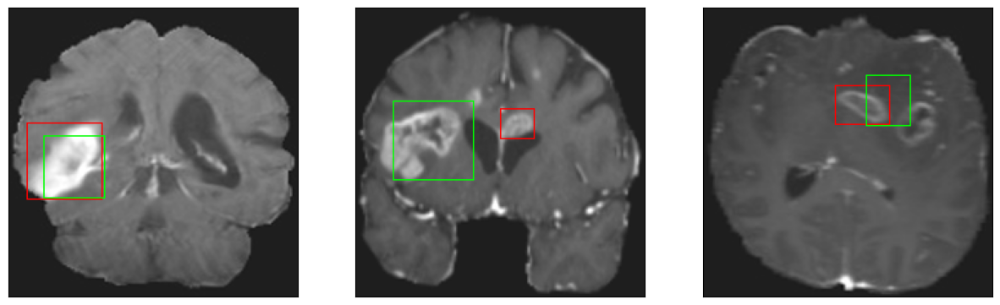

26/26 [==============================] - 4s 144ms/step - loss: 6.2781 - IoU: 0.5357 - val_loss: 10.5001 - val_IoU: 0.4446
Epoch 118/200
26/26 [==============================] - ETA: 0s - loss: 6.2284 - IoU: 0.5335
Epoch 118: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


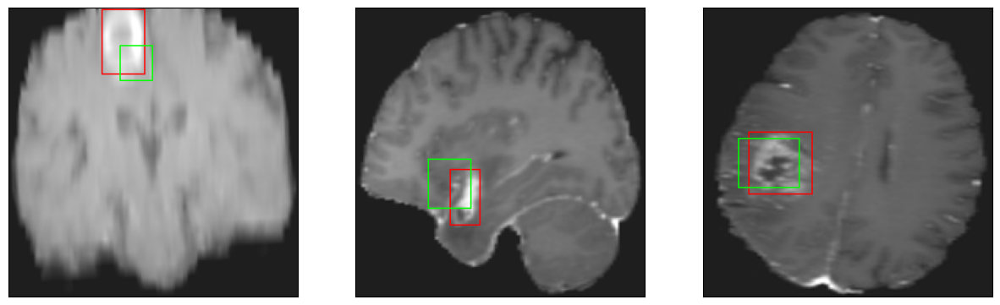

26/26 [==============================] - 3s 127ms/step - loss: 6.2284 - IoU: 0.5335 - val_loss: 9.8165 - val_IoU: 0.4817
Epoch 119/200
26/26 [==============================] - ETA: 0s - loss: 6.2467 - IoU: 0.5310
Epoch 119: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


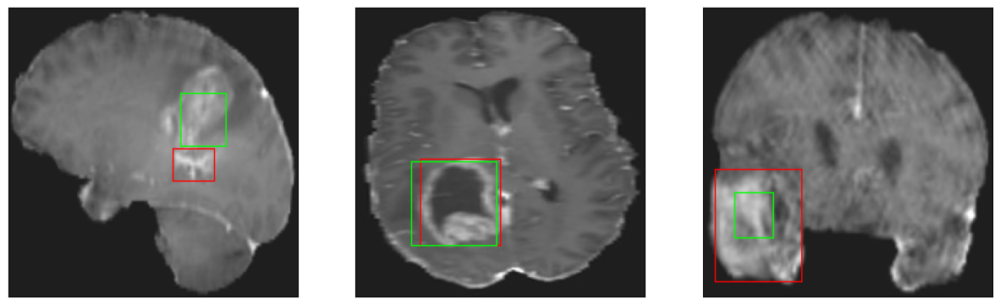

26/26 [==============================] - 3s 128ms/step - loss: 6.2467 - IoU: 0.5310 - val_loss: 9.7375 - val_IoU: 0.4880
Epoch 120/200
26/26 [==============================] - ETA: 0s - loss: 5.9211 - IoU: 0.5505
Epoch 120: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 11ms/step
4


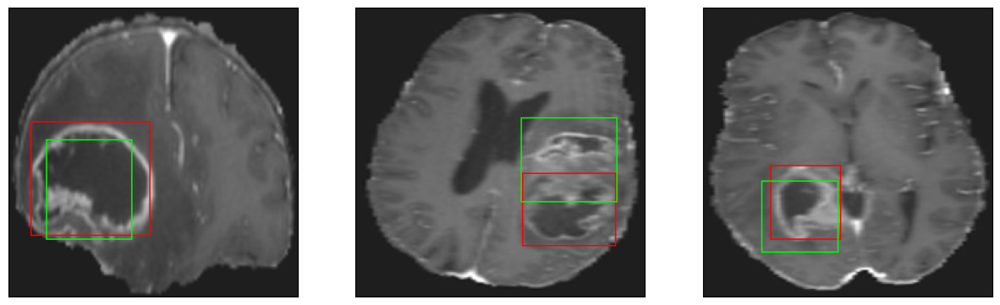

26/26 [==============================] - 3s 128ms/step - loss: 5.9211 - IoU: 0.5505 - val_loss: 9.9704 - val_IoU: 0.5098
Epoch 121/200
26/26 [==============================] - ETA: 0s - loss: 6.0166 - IoU: 0.5521
Epoch 121: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4


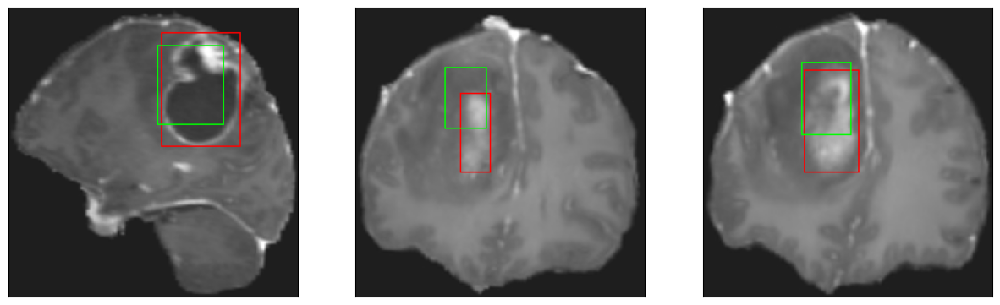

26/26 [==============================] - 4s 166ms/step - loss: 6.0166 - IoU: 0.5521 - val_loss: 10.7336 - val_IoU: 0.4473
Epoch 122/200
26/26 [==============================] - ETA: 0s - loss: 5.8803 - IoU: 0.5494
Epoch 122: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


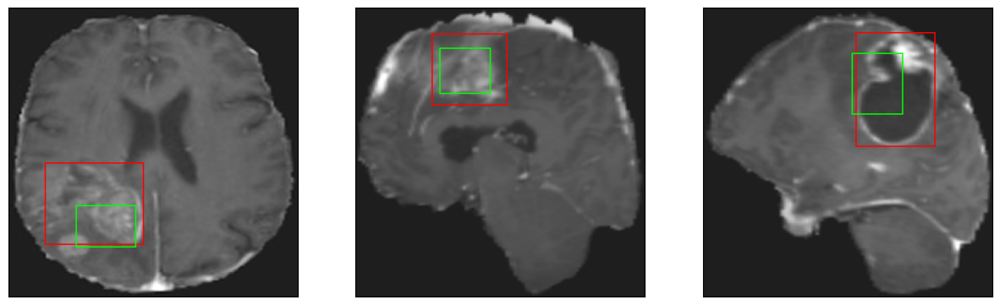

26/26 [==============================] - 3s 132ms/step - loss: 5.8803 - IoU: 0.5494 - val_loss: 12.2496 - val_IoU: 0.3827
Epoch 123/200
26/26 [==============================] - ETA: 0s - loss: 5.9712 - IoU: 0.5439
Epoch 123: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


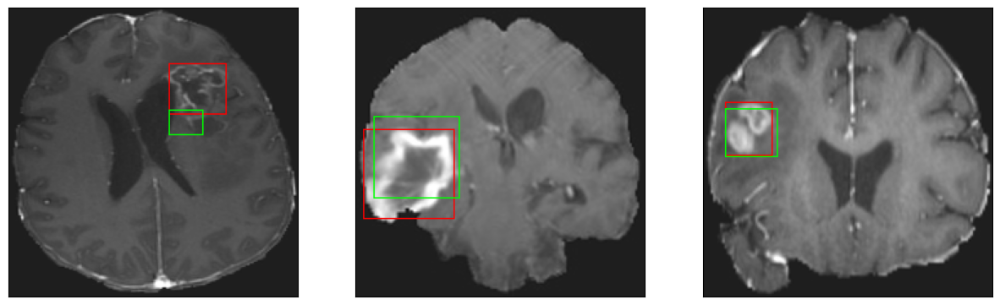

26/26 [==============================] - 3s 133ms/step - loss: 5.9712 - IoU: 0.5439 - val_loss: 11.1428 - val_IoU: 0.4662
Epoch 124/200
26/26 [==============================] - ETA: 0s - loss: 7.1489 - IoU: 0.5045
Epoch 124: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4


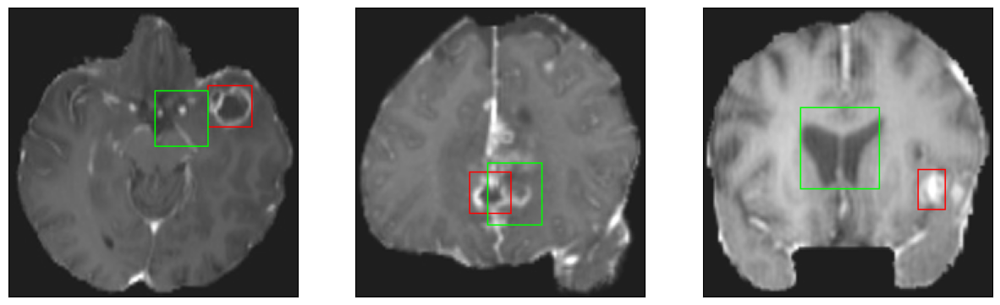

26/26 [==============================] - 4s 140ms/step - loss: 7.1489 - IoU: 0.5045 - val_loss: 47.1831 - val_IoU: 0.2313
Epoch 125/200
26/26 [==============================] - ETA: 0s - loss: 7.1566 - IoU: 0.5056
Epoch 125: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 13ms/step
4


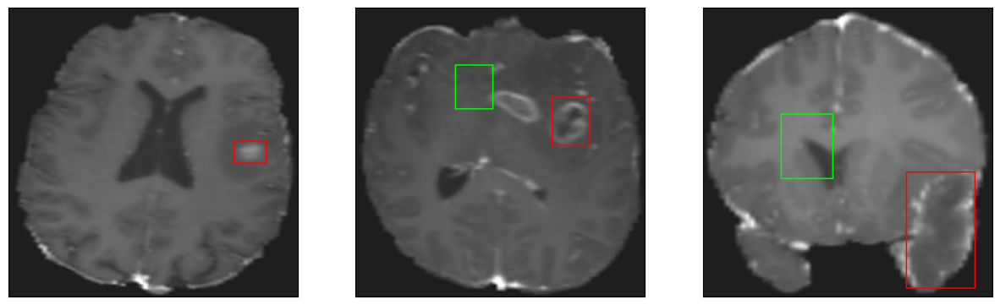

26/26 [==============================] - 4s 144ms/step - loss: 7.1566 - IoU: 0.5056 - val_loss: 18.7647 - val_IoU: 0.2580
Epoch 126/200
26/26 [==============================] - ETA: 0s - loss: 6.5024 - IoU: 0.5356
Epoch 126: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


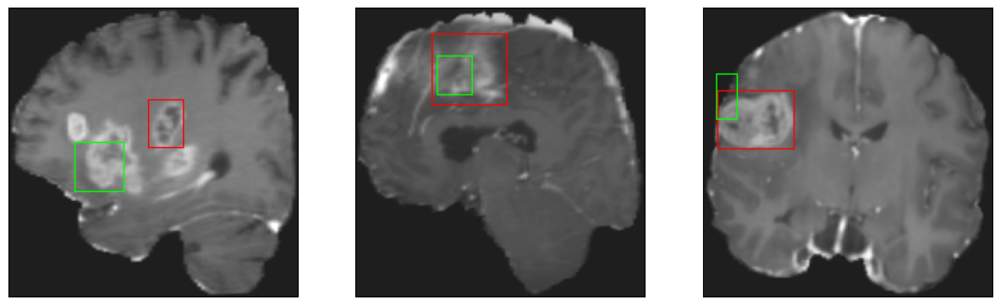

26/26 [==============================] - 3s 129ms/step - loss: 6.5024 - IoU: 0.5356 - val_loss: 15.1916 - val_IoU: 0.3132
Epoch 127/200
26/26 [==============================] - ETA: 0s - loss: 6.4807 - IoU: 0.5292
Epoch 127: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


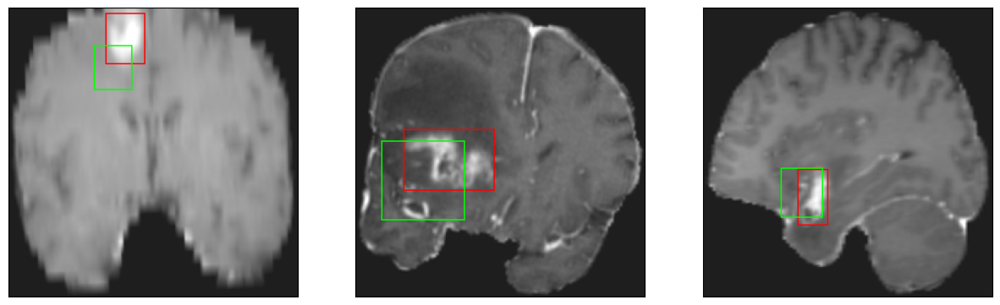

26/26 [==============================] - 3s 125ms/step - loss: 6.4807 - IoU: 0.5292 - val_loss: 10.2662 - val_IoU: 0.4782
Epoch 128/200
26/26 [==============================] - ETA: 0s - loss: 5.9070 - IoU: 0.5551
Epoch 128: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


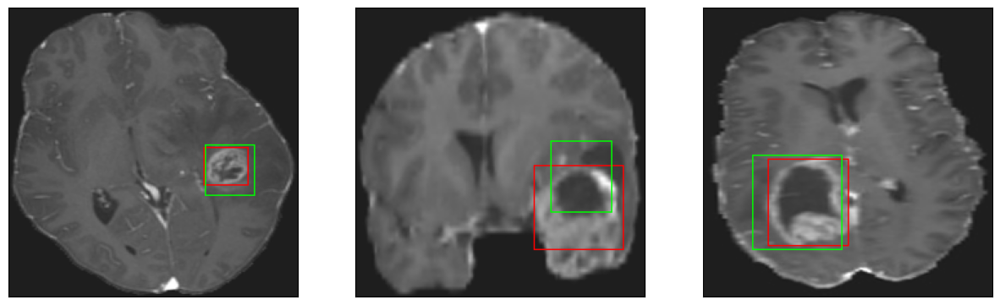

26/26 [==============================] - 3s 133ms/step - loss: 5.9070 - IoU: 0.5551 - val_loss: 10.8164 - val_IoU: 0.4869
Epoch 129/200
26/26 [==============================] - ETA: 0s - loss: 6.0901 - IoU: 0.5481
Epoch 129: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4


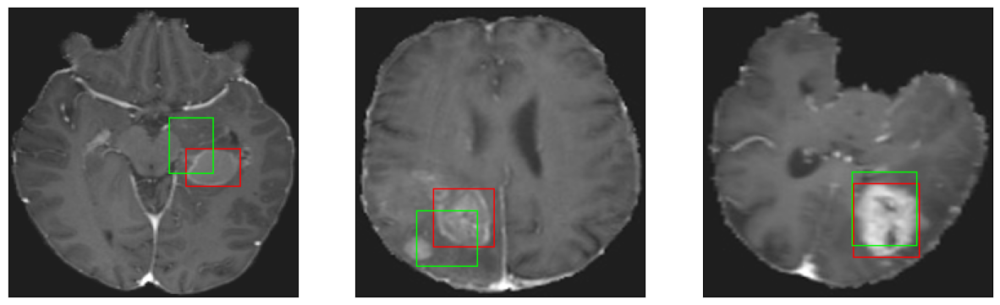

26/26 [==============================] - 4s 143ms/step - loss: 6.0901 - IoU: 0.5481 - val_loss: 11.0829 - val_IoU: 0.4520
Epoch 130/200
26/26 [==============================] - ETA: 0s - loss: 6.0661 - IoU: 0.5455
Epoch 130: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


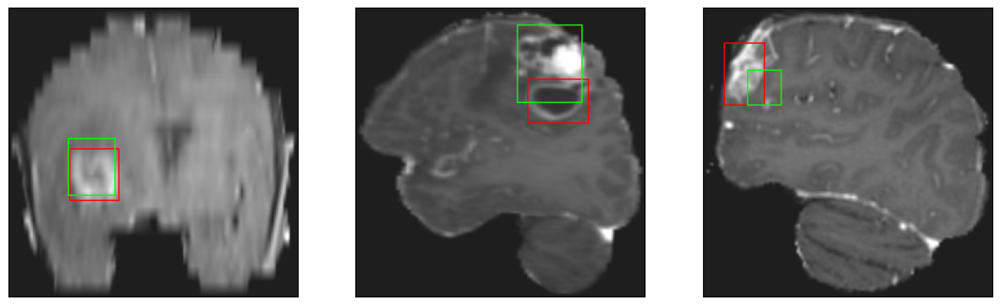

26/26 [==============================] - 4s 138ms/step - loss: 6.0661 - IoU: 0.5455 - val_loss: 9.9800 - val_IoU: 0.5061
Epoch 131/200
26/26 [==============================] - ETA: 0s - loss: 6.0245 - IoU: 0.5513
Epoch 131: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4


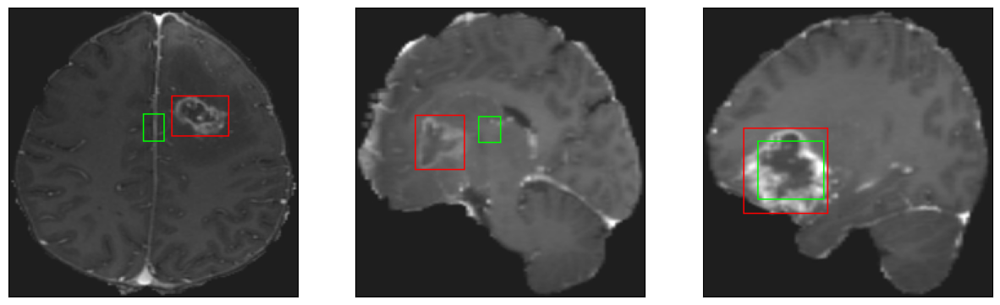

26/26 [==============================] - 4s 136ms/step - loss: 6.0245 - IoU: 0.5513 - val_loss: 13.8975 - val_IoU: 0.3749
Epoch 132/200
26/26 [==============================] - ETA: 0s - loss: 6.0664 - IoU: 0.5502
Epoch 132: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4


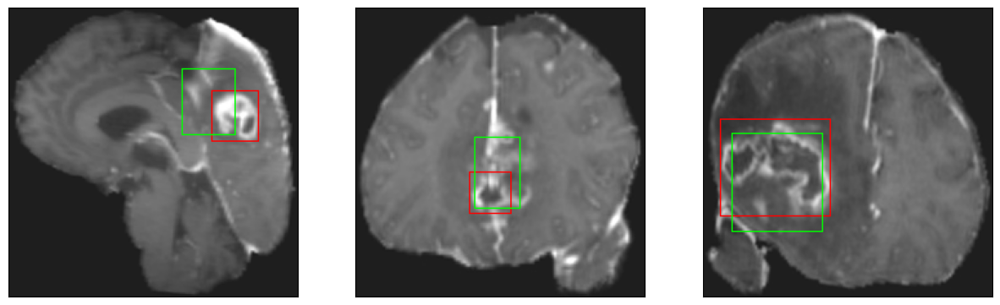

26/26 [==============================] - 4s 141ms/step - loss: 6.0664 - IoU: 0.5502 - val_loss: 10.3602 - val_IoU: 0.4644
Epoch 133/200
26/26 [==============================] - ETA: 0s - loss: 5.9063 - IoU: 0.5445
Epoch 133: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4


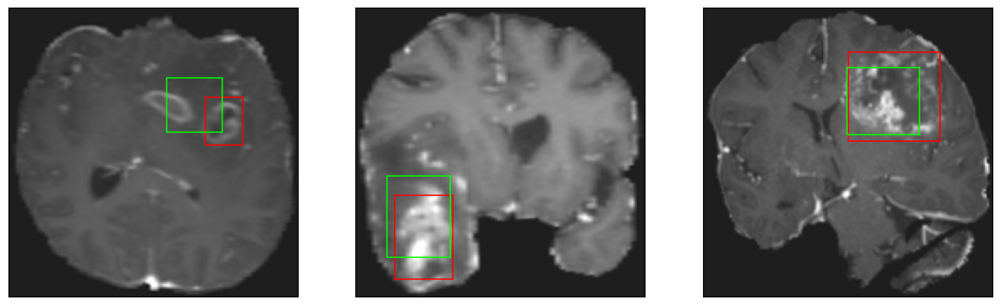

26/26 [==============================] - 4s 150ms/step - loss: 5.9063 - IoU: 0.5445 - val_loss: 10.1367 - val_IoU: 0.5003
Epoch 134/200
26/26 [==============================] - ETA: 0s - loss: 5.8429 - IoU: 0.5568
Epoch 134: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


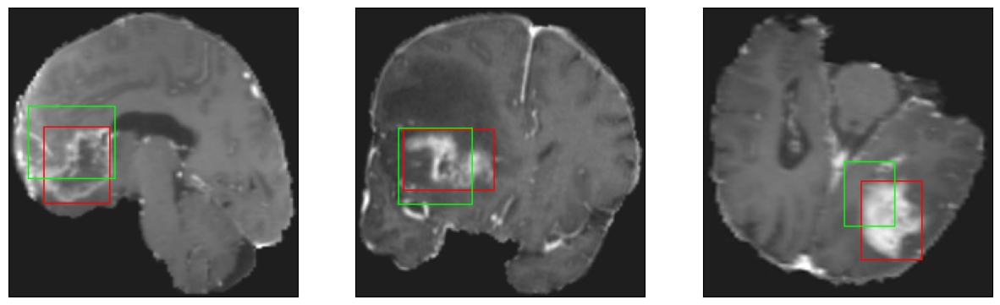

26/26 [==============================] - 3s 121ms/step - loss: 5.8429 - IoU: 0.5568 - val_loss: 10.0361 - val_IoU: 0.4654
Epoch 135/200
26/26 [==============================] - ETA: 0s - loss: 5.4867 - IoU: 0.5754
Epoch 135: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


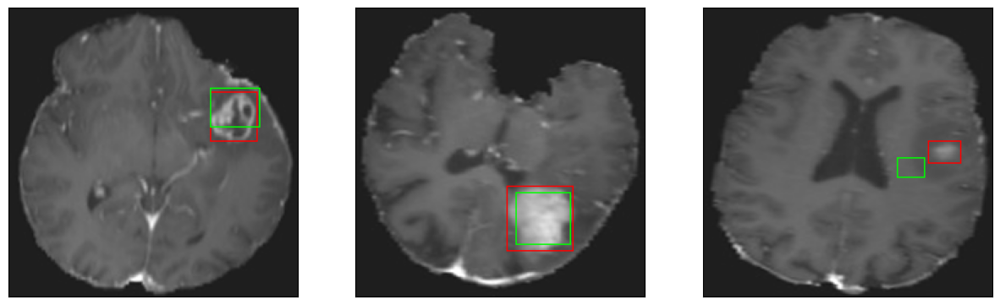

26/26 [==============================] - 3s 124ms/step - loss: 5.4867 - IoU: 0.5754 - val_loss: 11.6037 - val_IoU: 0.4416
Epoch 136/200
26/26 [==============================] - ETA: 0s - loss: 5.7405 - IoU: 0.5667
Epoch 136: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4


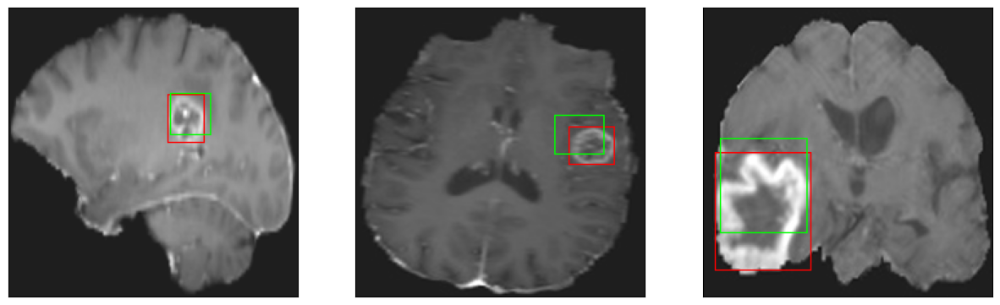

26/26 [==============================] - 4s 146ms/step - loss: 5.7405 - IoU: 0.5667 - val_loss: 10.6911 - val_IoU: 0.4339
Epoch 137/200
26/26 [==============================] - ETA: 0s - loss: 5.8587 - IoU: 0.5530
Epoch 137: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


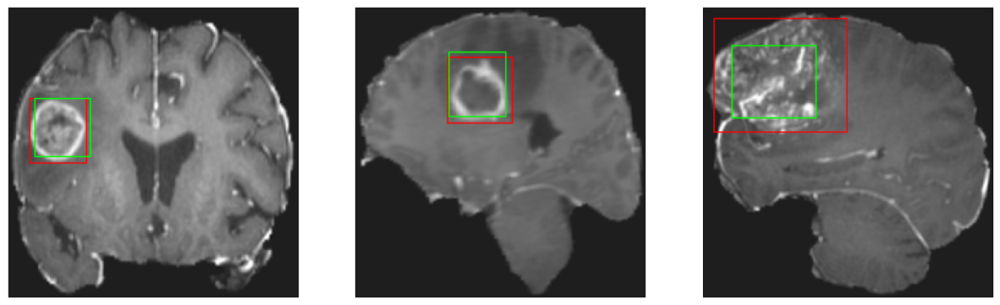

26/26 [==============================] - 3s 129ms/step - loss: 5.8587 - IoU: 0.5530 - val_loss: 10.3027 - val_IoU: 0.4717
Epoch 138/200
26/26 [==============================] - ETA: 0s - loss: 5.9733 - IoU: 0.5472
Epoch 138: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


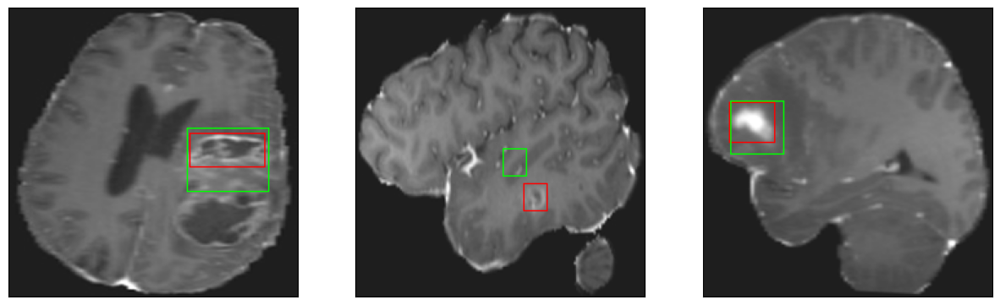

26/26 [==============================] - 3s 133ms/step - loss: 5.9733 - IoU: 0.5472 - val_loss: 10.1033 - val_IoU: 0.4848
Epoch 139/200
26/26 [==============================] - ETA: 0s - loss: 5.9743 - IoU: 0.5553
Epoch 139: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4


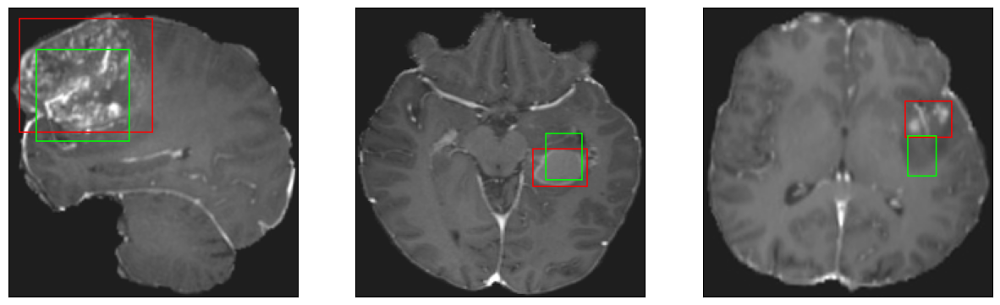

26/26 [==============================] - 4s 145ms/step - loss: 5.9743 - IoU: 0.5553 - val_loss: 11.6134 - val_IoU: 0.4247
Epoch 140/200
26/26 [==============================] - ETA: 0s - loss: 6.1177 - IoU: 0.5409
Epoch 140: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


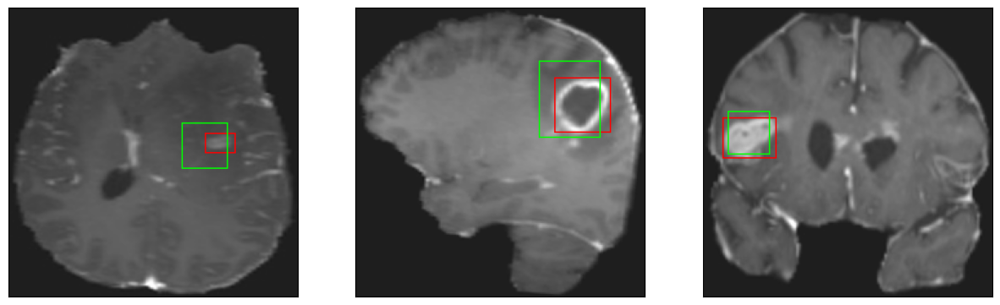

26/26 [==============================] - 3s 130ms/step - loss: 6.1177 - IoU: 0.5409 - val_loss: 12.5115 - val_IoU: 0.4499
Epoch 141/200
26/26 [==============================] - ETA: 0s - loss: 5.8390 - IoU: 0.5568
Epoch 141: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4


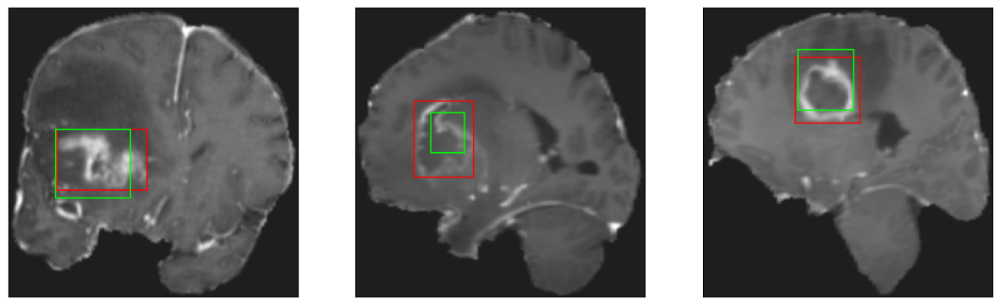

26/26 [==============================] - 4s 151ms/step - loss: 5.8390 - IoU: 0.5568 - val_loss: 11.4720 - val_IoU: 0.4402
Epoch 142/200
26/26 [==============================] - ETA: 0s - loss: 5.5911 - IoU: 0.5689
Epoch 142: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4


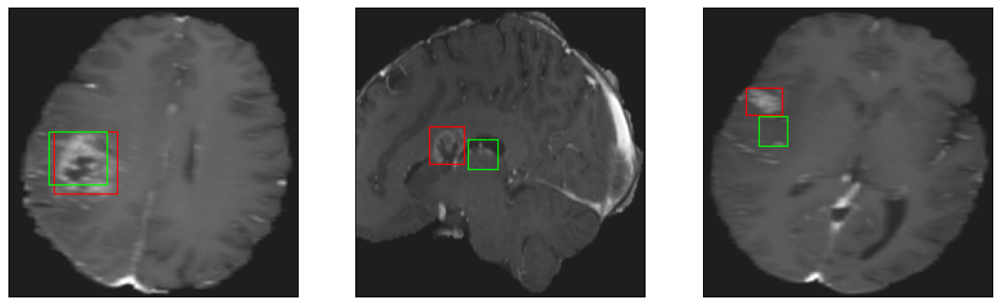

26/26 [==============================] - 4s 139ms/step - loss: 5.5911 - IoU: 0.5689 - val_loss: 9.8112 - val_IoU: 0.4962
Epoch 143/200
26/26 [==============================] - ETA: 0s - loss: 5.5292 - IoU: 0.5731
Epoch 143: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


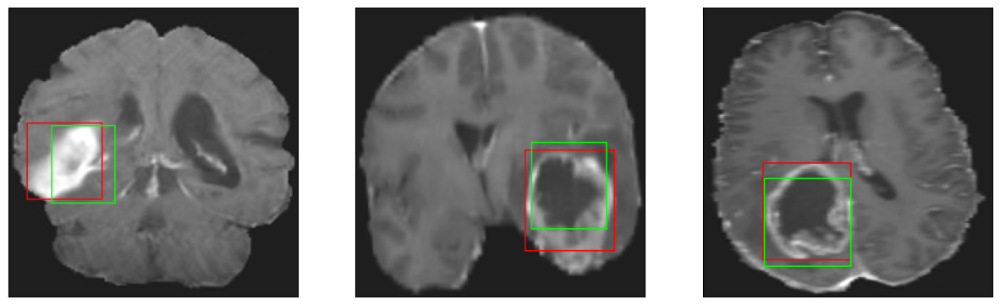

26/26 [==============================] - 3s 131ms/step - loss: 5.5292 - IoU: 0.5731 - val_loss: 9.8610 - val_IoU: 0.5087
Epoch 144/200
26/26 [==============================] - ETA: 0s - loss: 5.7277 - IoU: 0.5693
Epoch 144: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


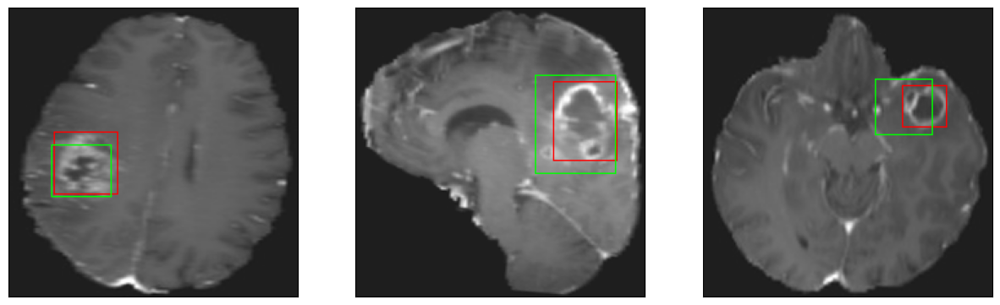

26/26 [==============================] - 3s 130ms/step - loss: 5.7277 - IoU: 0.5693 - val_loss: 9.5545 - val_IoU: 0.5132
Epoch 145/200
26/26 [==============================] - ETA: 0s - loss: 5.8486 - IoU: 0.5526
Epoch 145: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4


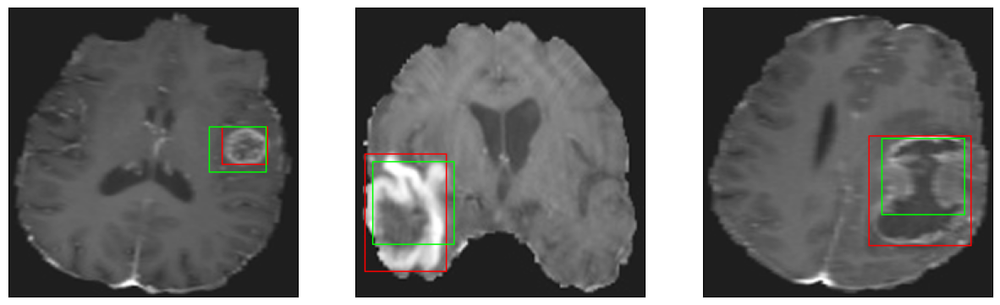

26/26 [==============================] - 3s 134ms/step - loss: 5.8486 - IoU: 0.5526 - val_loss: 9.8907 - val_IoU: 0.4908
Epoch 146/200
26/26 [==============================] - ETA: 0s - loss: 5.4722 - IoU: 0.5731
Epoch 146: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 15ms/step
4


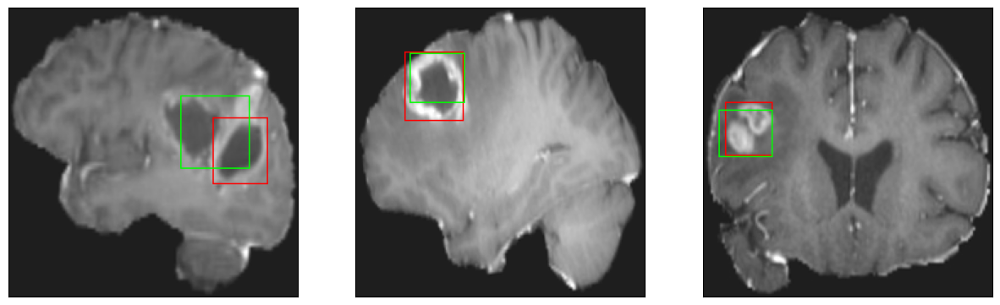

26/26 [==============================] - 4s 149ms/step - loss: 5.4722 - IoU: 0.5731 - val_loss: 9.8746 - val_IoU: 0.4900
Epoch 147/200
26/26 [==============================] - ETA: 0s - loss: 6.0971 - IoU: 0.5405
Epoch 147: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 12ms/step
4


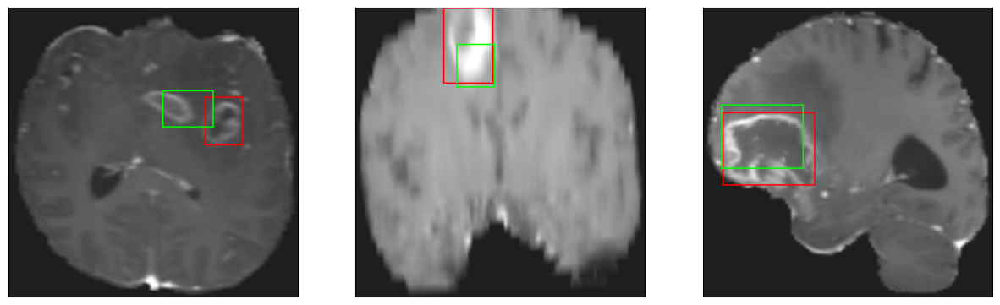

26/26 [==============================] - 3s 130ms/step - loss: 6.0971 - IoU: 0.5405 - val_loss: 12.3260 - val_IoU: 0.3918
Epoch 148/200
26/26 [==============================] - ETA: 0s - loss: 6.0465 - IoU: 0.5398
Epoch 148: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


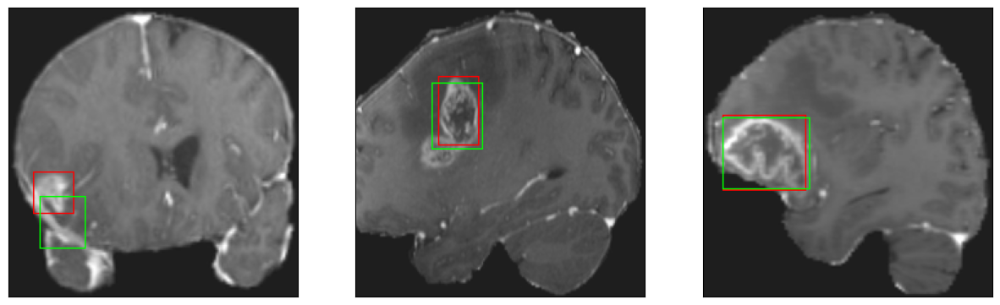

26/26 [==============================] - 3s 125ms/step - loss: 6.0465 - IoU: 0.5398 - val_loss: 11.4937 - val_IoU: 0.4428
Epoch 149/200
26/26 [==============================] - ETA: 0s - loss: 5.6525 - IoU: 0.5714
Epoch 149: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


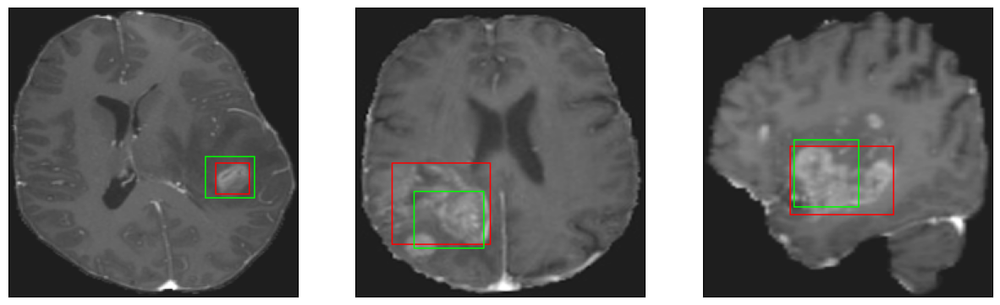

26/26 [==============================] - 4s 149ms/step - loss: 5.6525 - IoU: 0.5714 - val_loss: 9.3802 - val_IoU: 0.5269
Epoch 150/200
26/26 [==============================] - ETA: 0s - loss: 5.9221 - IoU: 0.5570
Epoch 150: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4


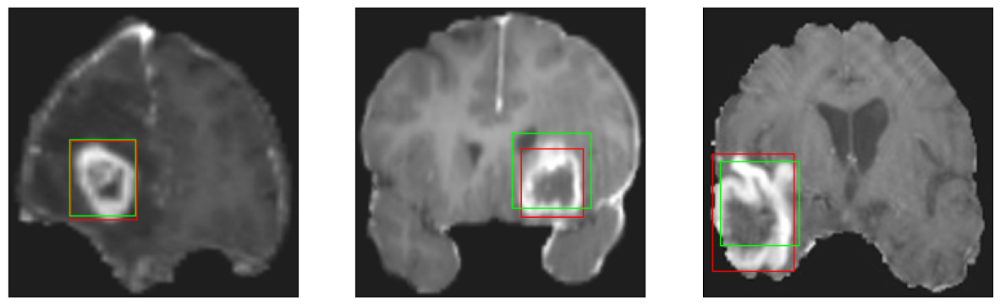

26/26 [==============================] - 4s 146ms/step - loss: 5.9221 - IoU: 0.5570 - val_loss: 47.6252 - val_IoU: 0.4787
Epoch 151/200
26/26 [==============================] - ETA: 0s - loss: 5.4646 - IoU: 0.5722
Epoch 151: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


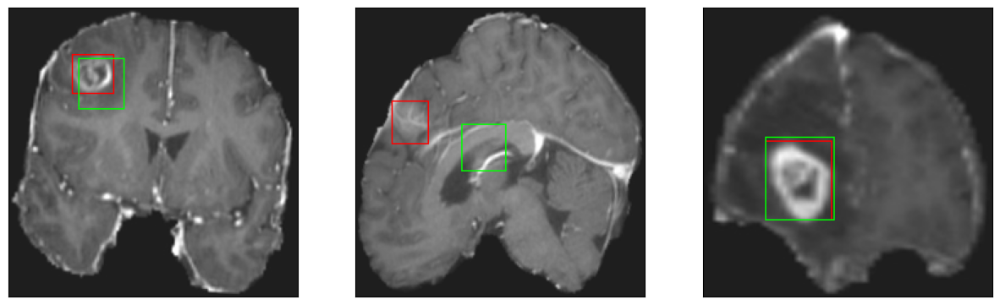

26/26 [==============================] - 3s 130ms/step - loss: 5.4646 - IoU: 0.5722 - val_loss: 11.4405 - val_IoU: 0.4950
Epoch 152/200
26/26 [==============================] - ETA: 0s - loss: 5.5989 - IoU: 0.5750
Epoch 152: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


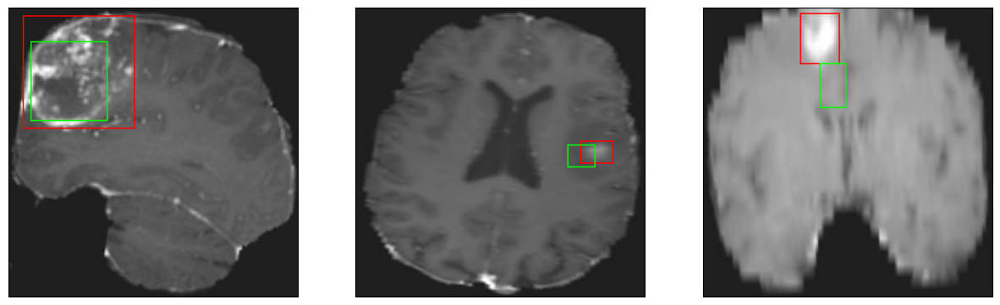

26/26 [==============================] - 3s 126ms/step - loss: 5.5989 - IoU: 0.5750 - val_loss: 11.0271 - val_IoU: 0.4837
Epoch 153/200
26/26 [==============================] - ETA: 0s - loss: 5.5268 - IoU: 0.5779
Epoch 153: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


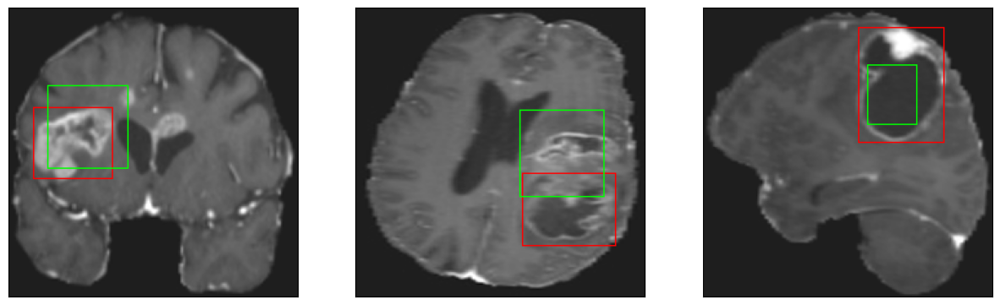

26/26 [==============================] - 3s 123ms/step - loss: 5.5268 - IoU: 0.5779 - val_loss: 11.7717 - val_IoU: 0.4100
Epoch 154/200
26/26 [==============================] - ETA: 0s - loss: 5.8339 - IoU: 0.5561
Epoch 154: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


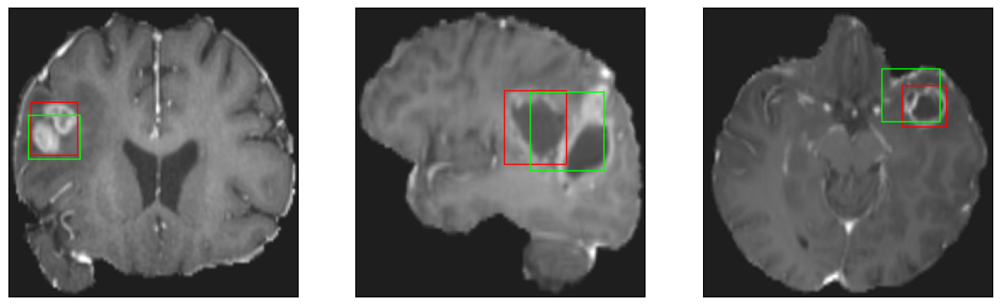

26/26 [==============================] - 4s 140ms/step - loss: 5.8339 - IoU: 0.5561 - val_loss: 11.3456 - val_IoU: 0.4712
Epoch 155/200
26/26 [==============================] - ETA: 0s - loss: 5.6832 - IoU: 0.5566
Epoch 155: val_loss did not improve from 9.28756
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


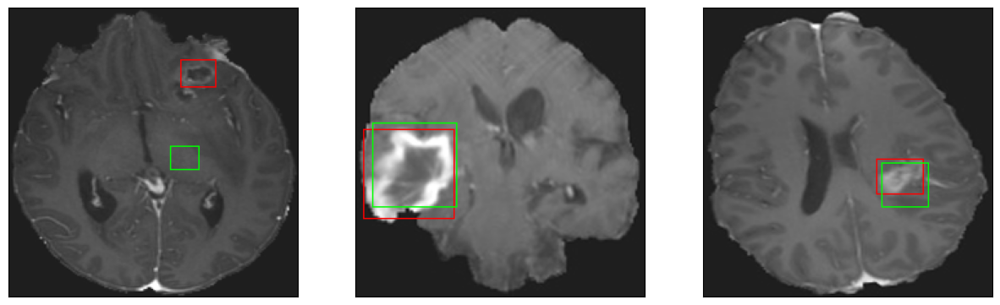

26/26 [==============================] - 3s 130ms/step - loss: 5.6832 - IoU: 0.5566 - val_loss: 10.4899 - val_IoU: 0.4962
Epoch 156/200
26/26 [==============================] - ETA: 0s - loss: 5.6547 - IoU: 0.5616
Epoch 156: val_loss improved from 9.28756 to 9.07559, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 13ms/step
4


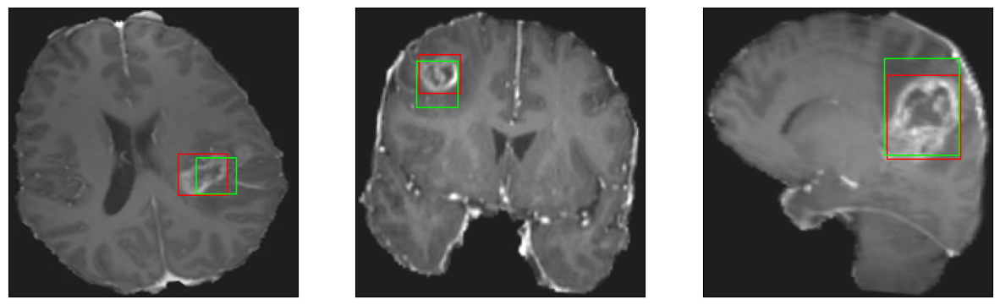

26/26 [==============================] - 11s 454ms/step - loss: 5.6547 - IoU: 0.5616 - val_loss: 9.0756 - val_IoU: 0.5115
Epoch 157/200
26/26 [==============================] - ETA: 0s - loss: 5.6928 - IoU: 0.5608
Epoch 157: val_loss improved from 9.07559 to 8.76803, saving model to ./model_checkpoint_SCRATCH/model_SCRATCH.h5
8/8 [==============================] - 0s 18ms/step
4
8/8 [==============================] - 0s 20ms/step
4
8/8 [==============================] - 0s 19ms/step
4


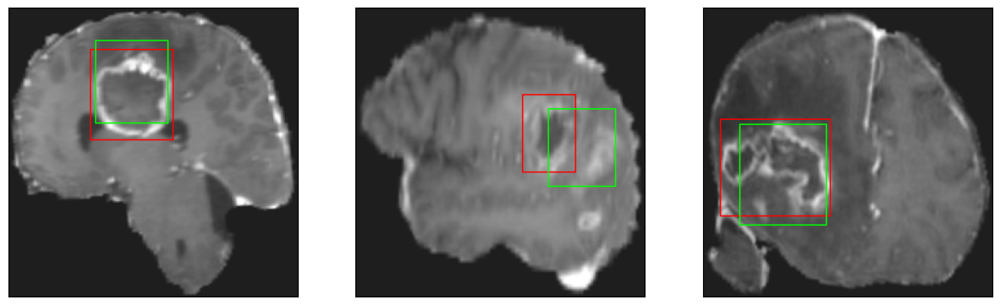

26/26 [==============================] - 9s 340ms/step - loss: 5.6928 - IoU: 0.5608 - val_loss: 8.7680 - val_IoU: 0.5498
Epoch 158/200
26/26 [==============================] - ETA: 0s - loss: 5.7575 - IoU: 0.5641
Epoch 158: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


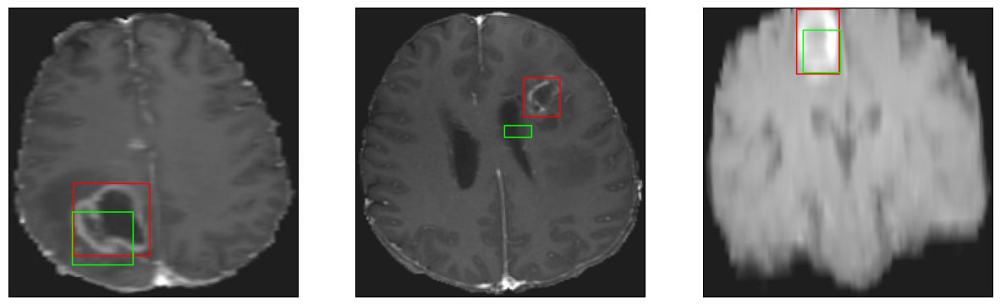

26/26 [==============================] - 3s 122ms/step - loss: 5.7575 - IoU: 0.5641 - val_loss: 9.8772 - val_IoU: 0.5094
Epoch 159/200
26/26 [==============================] - ETA: 0s - loss: 5.5297 - IoU: 0.5755
Epoch 159: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


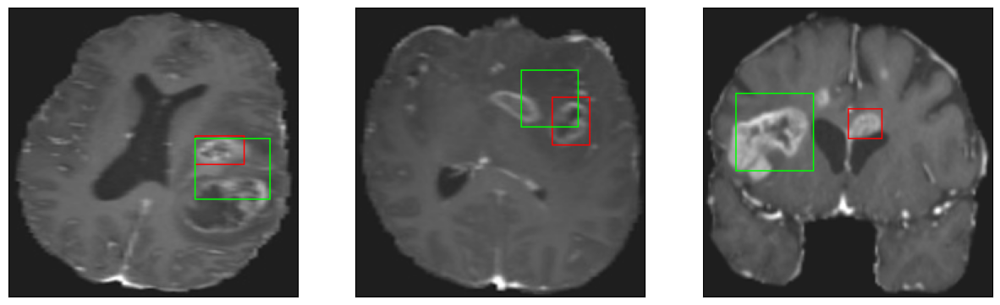

26/26 [==============================] - 3s 123ms/step - loss: 5.5297 - IoU: 0.5755 - val_loss: 9.1405 - val_IoU: 0.5222
Epoch 160/200
26/26 [==============================] - ETA: 0s - loss: 5.5379 - IoU: 0.5713
Epoch 160: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4


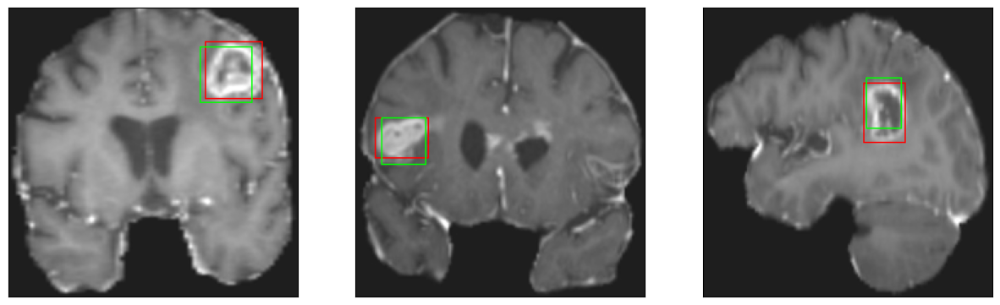

26/26 [==============================] - 4s 158ms/step - loss: 5.5379 - IoU: 0.5713 - val_loss: 9.2580 - val_IoU: 0.5389
Epoch 161/200
26/26 [==============================] - ETA: 0s - loss: 5.8466 - IoU: 0.5574
Epoch 161: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4


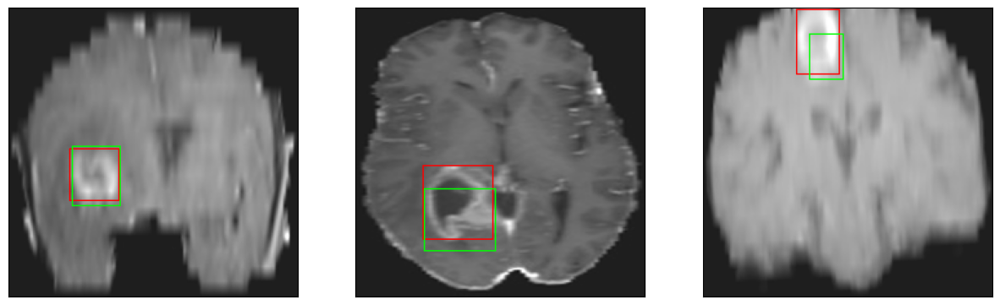

26/26 [==============================] - 4s 162ms/step - loss: 5.8466 - IoU: 0.5574 - val_loss: 10.3822 - val_IoU: 0.4511
Epoch 162/200
26/26 [==============================] - ETA: 0s - loss: 5.4697 - IoU: 0.5750
Epoch 162: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


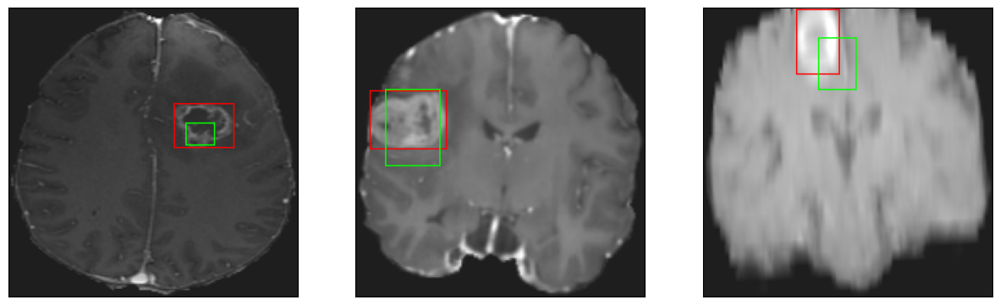

26/26 [==============================] - 3s 126ms/step - loss: 5.4697 - IoU: 0.5750 - val_loss: 9.9057 - val_IoU: 0.5048
Epoch 163/200
26/26 [==============================] - ETA: 0s - loss: 5.8691 - IoU: 0.5460
Epoch 163: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4


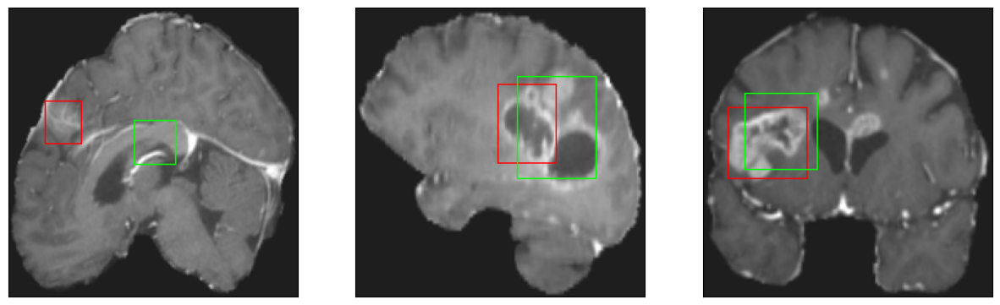

26/26 [==============================] - 3s 124ms/step - loss: 5.8691 - IoU: 0.5460 - val_loss: 10.1210 - val_IoU: 0.4758
Epoch 164/200
26/26 [==============================] - ETA: 0s - loss: 5.7047 - IoU: 0.5678
Epoch 164: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4


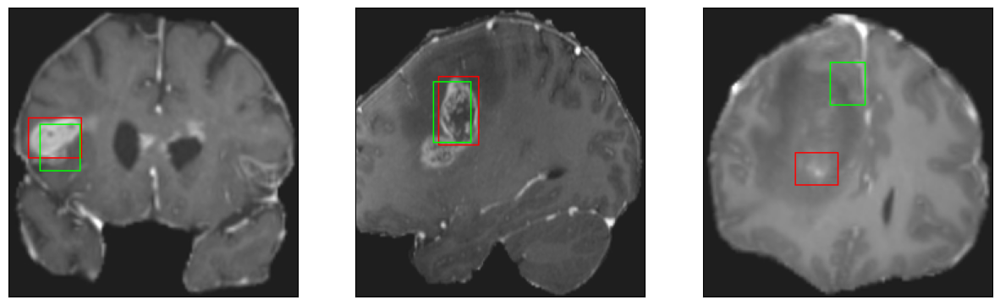

26/26 [==============================] - 4s 149ms/step - loss: 5.7047 - IoU: 0.5678 - val_loss: 9.4915 - val_IoU: 0.5090
Epoch 165/200
26/26 [==============================] - ETA: 0s - loss: 5.6845 - IoU: 0.5577
Epoch 165: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


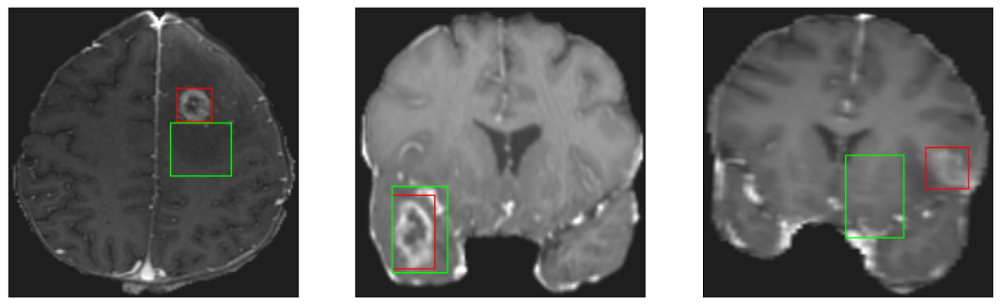

26/26 [==============================] - 3s 130ms/step - loss: 5.6845 - IoU: 0.5577 - val_loss: 9.4997 - val_IoU: 0.5182
Epoch 166/200
26/26 [==============================] - ETA: 0s - loss: 5.4888 - IoU: 0.5800
Epoch 166: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


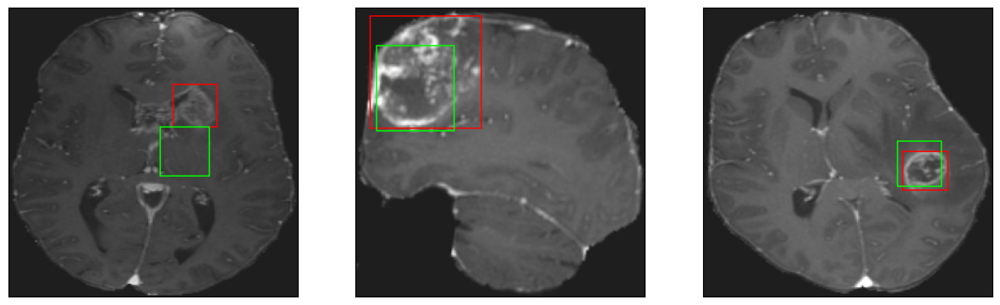

26/26 [==============================] - 4s 136ms/step - loss: 5.4888 - IoU: 0.5800 - val_loss: 10.5219 - val_IoU: 0.4834
Epoch 167/200
26/26 [==============================] - ETA: 0s - loss: 5.6018 - IoU: 0.5700
Epoch 167: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4


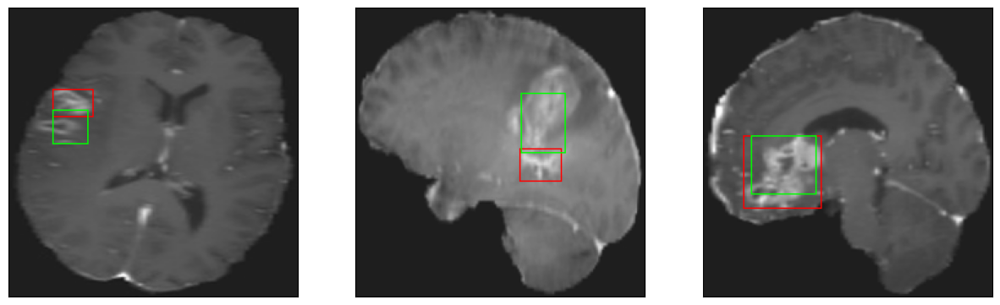

26/26 [==============================] - 4s 151ms/step - loss: 5.6018 - IoU: 0.5700 - val_loss: 9.5366 - val_IoU: 0.5074
Epoch 168/200
26/26 [==============================] - ETA: 0s - loss: 5.5715 - IoU: 0.5709
Epoch 168: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


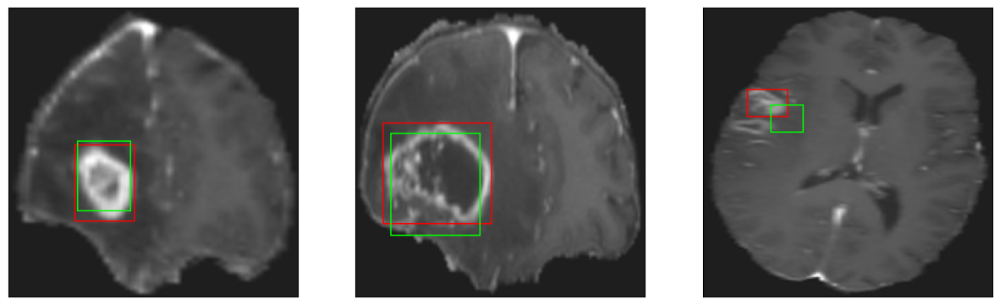

26/26 [==============================] - 3s 131ms/step - loss: 5.5715 - IoU: 0.5709 - val_loss: 16.8480 - val_IoU: 0.3211
Epoch 169/200
26/26 [==============================] - ETA: 0s - loss: 5.4743 - IoU: 0.5750
Epoch 169: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


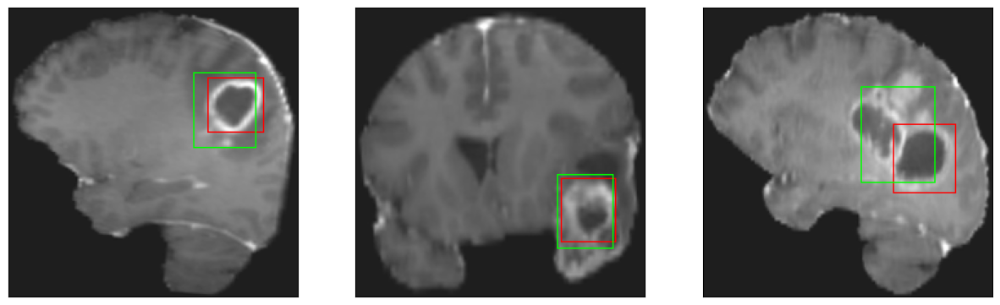

26/26 [==============================] - 3s 128ms/step - loss: 5.4743 - IoU: 0.5750 - val_loss: 10.1570 - val_IoU: 0.4988
Epoch 170/200
26/26 [==============================] - ETA: 0s - loss: 5.4507 - IoU: 0.5756
Epoch 170: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4


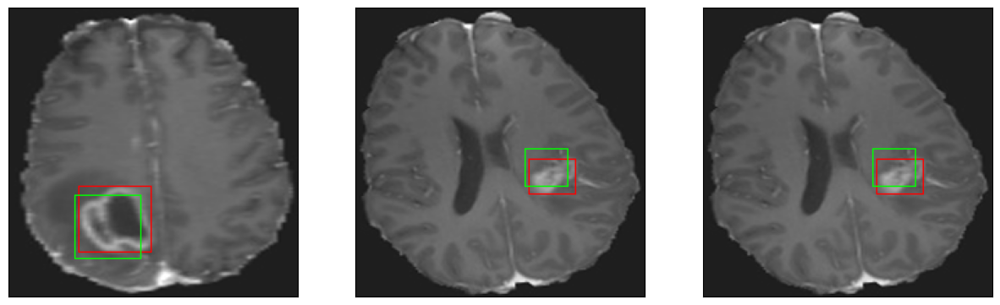

26/26 [==============================] - 3s 132ms/step - loss: 5.4507 - IoU: 0.5756 - val_loss: 10.0611 - val_IoU: 0.4864
Epoch 171/200
26/26 [==============================] - ETA: 0s - loss: 5.5857 - IoU: 0.5638
Epoch 171: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4


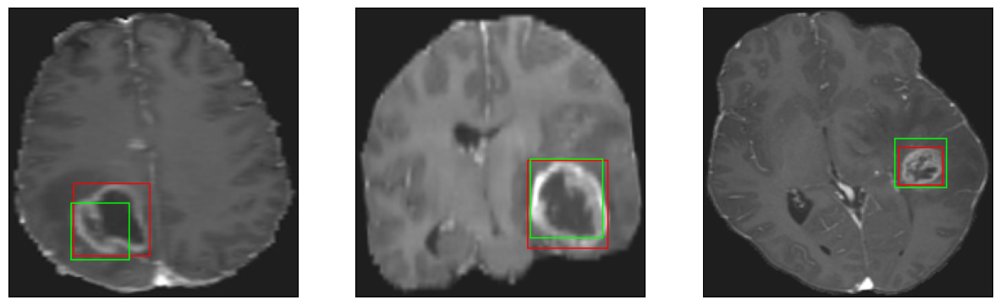

26/26 [==============================] - 4s 145ms/step - loss: 5.5857 - IoU: 0.5638 - val_loss: 10.2176 - val_IoU: 0.5107
Epoch 172/200
26/26 [==============================] - ETA: 0s - loss: 5.5394 - IoU: 0.5720
Epoch 172: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4


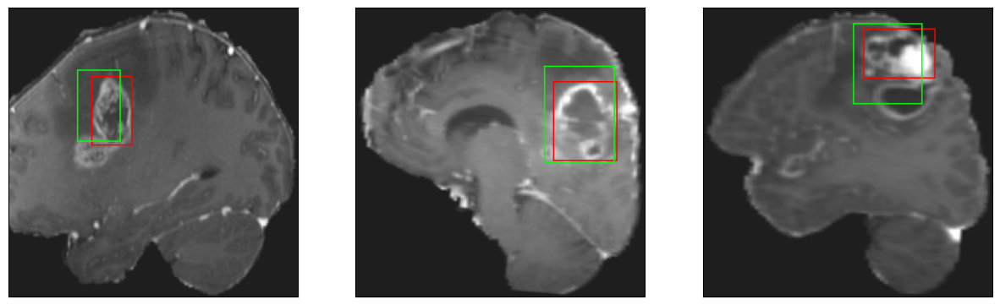

26/26 [==============================] - 3s 128ms/step - loss: 5.5394 - IoU: 0.5720 - val_loss: 10.3329 - val_IoU: 0.4785
Epoch 173/200
26/26 [==============================] - ETA: 0s - loss: 5.4211 - IoU: 0.5793
Epoch 173: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


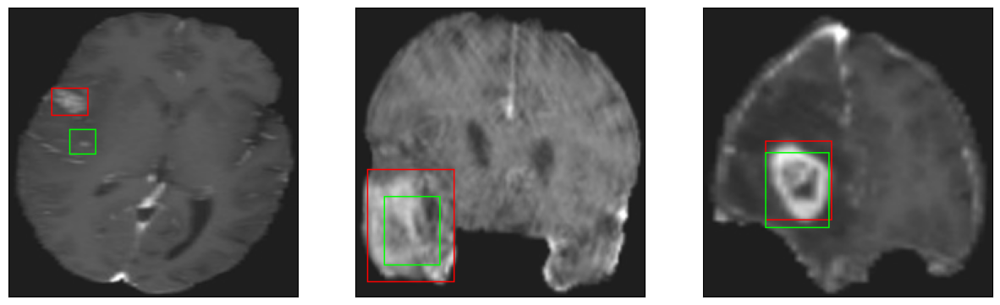

26/26 [==============================] - 3s 126ms/step - loss: 5.4211 - IoU: 0.5793 - val_loss: 10.5253 - val_IoU: 0.4915
Epoch 174/200
26/26 [==============================] - ETA: 0s - loss: 5.6000 - IoU: 0.5726
Epoch 174: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4


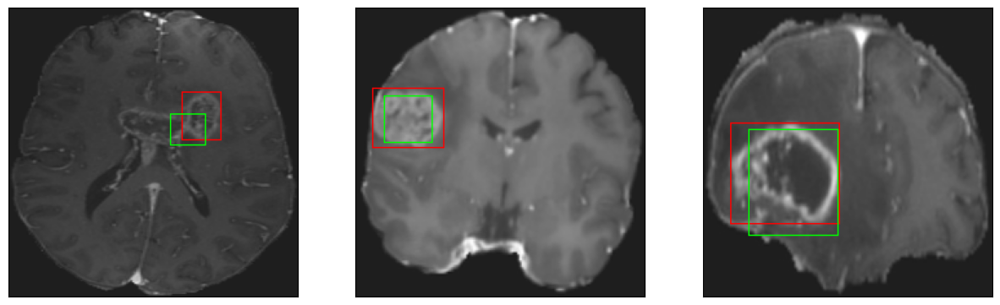

26/26 [==============================] - 4s 137ms/step - loss: 5.6000 - IoU: 0.5726 - val_loss: 10.0043 - val_IoU: 0.5096
Epoch 175/200
26/26 [==============================] - ETA: 0s - loss: 5.8252 - IoU: 0.5614
Epoch 175: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


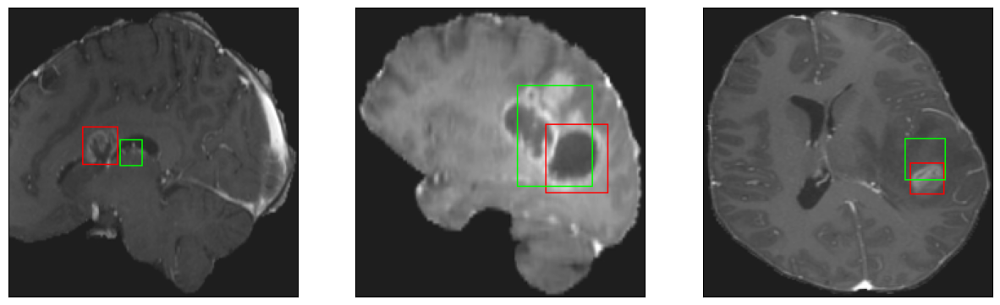

26/26 [==============================] - 4s 136ms/step - loss: 5.8252 - IoU: 0.5614 - val_loss: 10.7889 - val_IoU: 0.4752
Epoch 176/200
26/26 [==============================] - ETA: 0s - loss: 5.5391 - IoU: 0.5691
Epoch 176: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


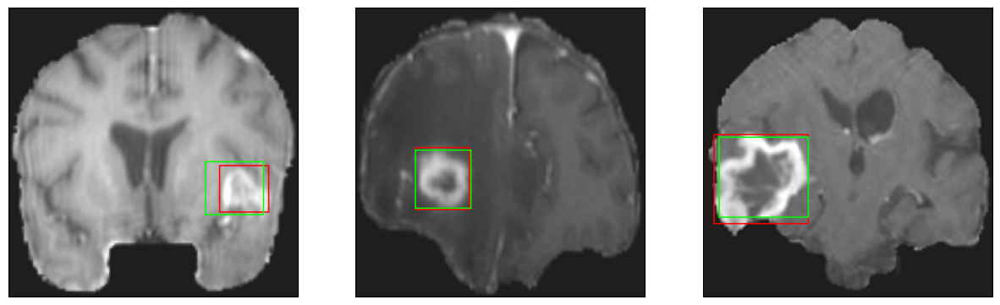

26/26 [==============================] - 3s 128ms/step - loss: 5.5391 - IoU: 0.5691 - val_loss: 11.0295 - val_IoU: 0.4794
Epoch 177/200
26/26 [==============================] - ETA: 0s - loss: 5.6559 - IoU: 0.5648
Epoch 177: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4


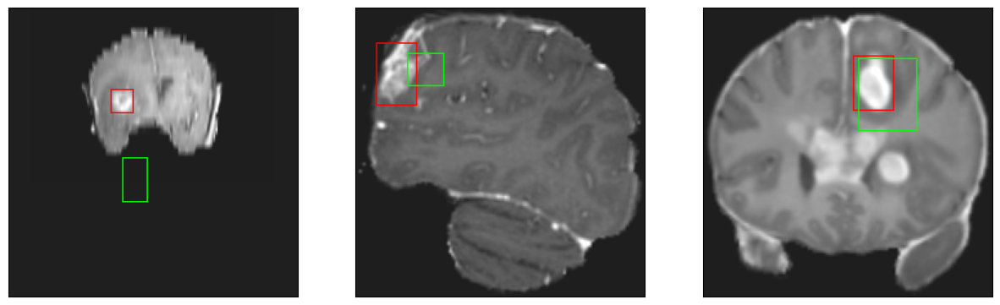

26/26 [==============================] - 4s 136ms/step - loss: 5.6559 - IoU: 0.5648 - val_loss: 14.7865 - val_IoU: 0.4800
Epoch 178/200
26/26 [==============================] - ETA: 0s - loss: 5.5593 - IoU: 0.5755
Epoch 178: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 15ms/step
4


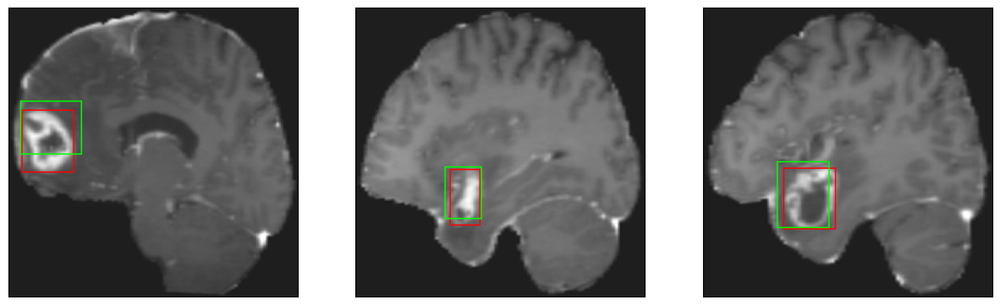

26/26 [==============================] - 4s 144ms/step - loss: 5.5593 - IoU: 0.5755 - val_loss: 11.0145 - val_IoU: 0.4593
Epoch 179/200
26/26 [==============================] - ETA: 0s - loss: 5.5249 - IoU: 0.5731
Epoch 179: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 10ms/step
4
8/8 [==============================] - 0s 11ms/step
4


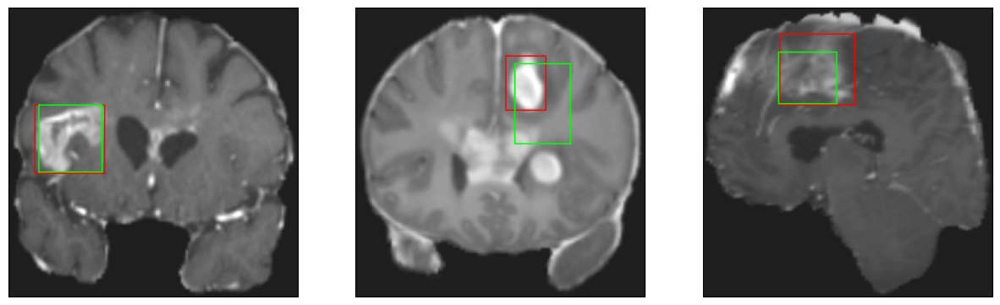

26/26 [==============================] - 3s 131ms/step - loss: 5.5249 - IoU: 0.5731 - val_loss: 10.2887 - val_IoU: 0.4939
Epoch 180/200
26/26 [==============================] - ETA: 0s - loss: 5.2233 - IoU: 0.5959
Epoch 180: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


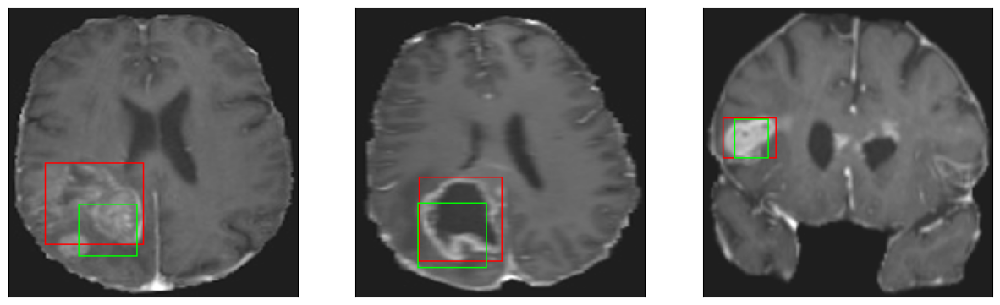

26/26 [==============================] - 3s 124ms/step - loss: 5.2233 - IoU: 0.5959 - val_loss: 18.5088 - val_IoU: 0.4705
Epoch 181/200
26/26 [==============================] - ETA: 0s - loss: 5.2707 - IoU: 0.5925
Epoch 181: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 13ms/step
4


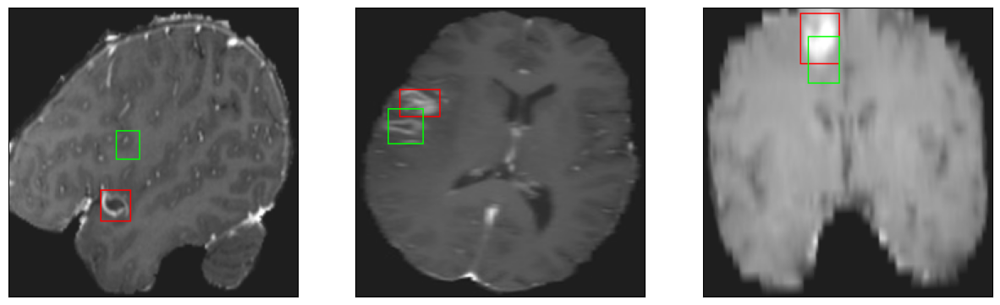

26/26 [==============================] - 3s 130ms/step - loss: 5.2707 - IoU: 0.5925 - val_loss: 373.1838 - val_IoU: 0.5003
Epoch 182/200
26/26 [==============================] - ETA: 0s - loss: 5.3990 - IoU: 0.5812
Epoch 182: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


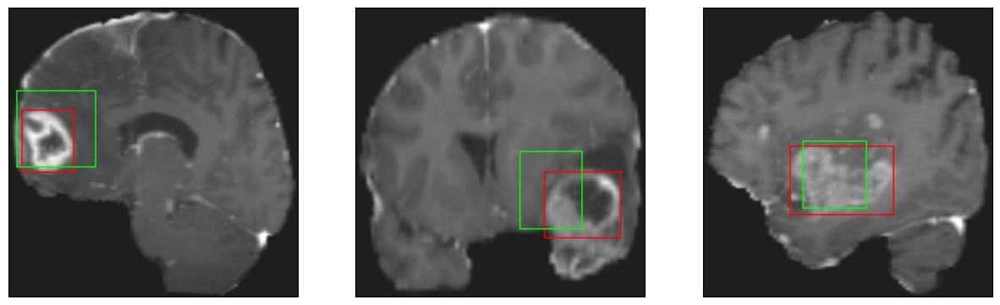

26/26 [==============================] - 4s 149ms/step - loss: 5.3990 - IoU: 0.5812 - val_loss: 15.6292 - val_IoU: 0.4804
Epoch 183/200
26/26 [==============================] - ETA: 0s - loss: 5.4267 - IoU: 0.5783
Epoch 183: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 12ms/step
4


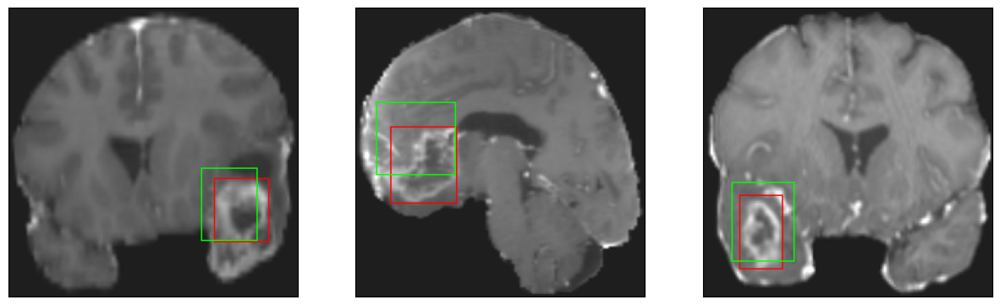

26/26 [==============================] - 3s 124ms/step - loss: 5.4267 - IoU: 0.5783 - val_loss: 10.2993 - val_IoU: 0.5068
Epoch 184/200
26/26 [==============================] - ETA: 0s - loss: 5.3005 - IoU: 0.5844
Epoch 184: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 12ms/step
4


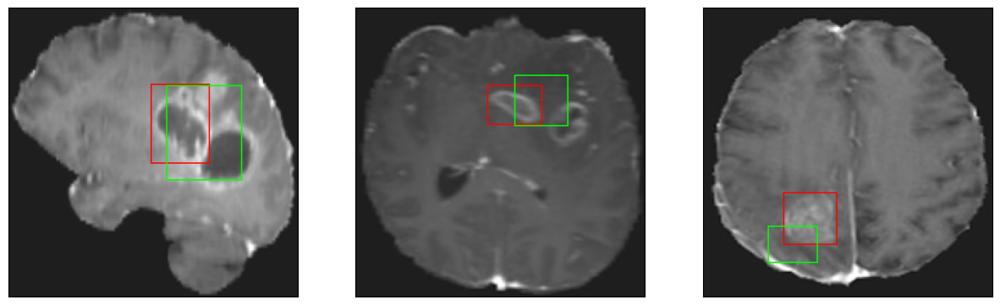

26/26 [==============================] - 3s 127ms/step - loss: 5.3005 - IoU: 0.5844 - val_loss: 10.6359 - val_IoU: 0.4950
Epoch 185/200
26/26 [==============================] - ETA: 0s - loss: 5.5986 - IoU: 0.5801
Epoch 185: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 14ms/step
4


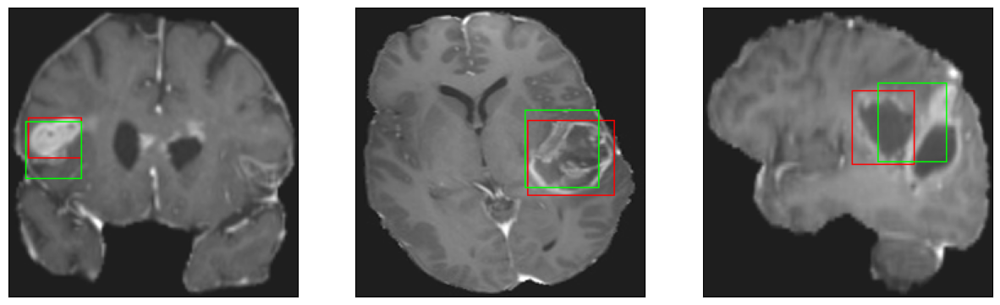

26/26 [==============================] - 3s 134ms/step - loss: 5.5986 - IoU: 0.5801 - val_loss: 10.2774 - val_IoU: 0.4724
Epoch 186/200
26/26 [==============================] - ETA: 0s - loss: 5.2380 - IoU: 0.5889
Epoch 186: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


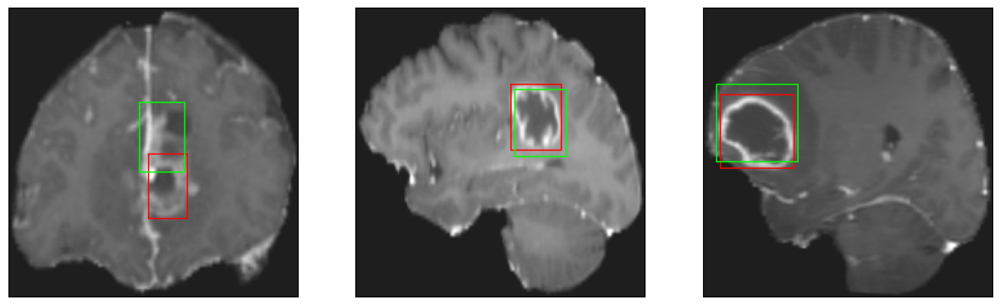

26/26 [==============================] - 3s 127ms/step - loss: 5.2380 - IoU: 0.5889 - val_loss: 10.5427 - val_IoU: 0.4684
Epoch 187/200
26/26 [==============================] - ETA: 0s - loss: 5.4162 - IoU: 0.5671
Epoch 187: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 10ms/step
4


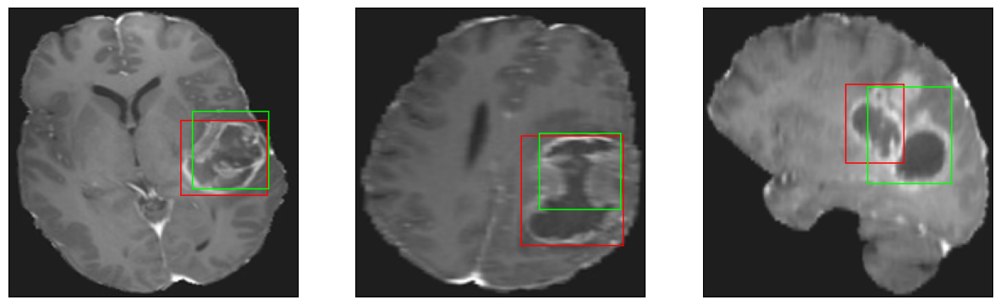

26/26 [==============================] - 3s 130ms/step - loss: 5.4162 - IoU: 0.5671 - val_loss: 10.5632 - val_IoU: 0.4759
Epoch 188/200
26/26 [==============================] - ETA: 0s - loss: 5.3052 - IoU: 0.5904
Epoch 188: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4
8/8 [==============================] - 0s 14ms/step
4


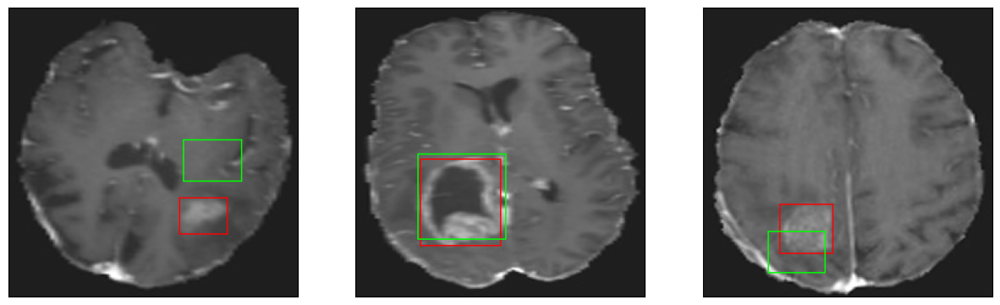

26/26 [==============================] - 4s 144ms/step - loss: 5.3052 - IoU: 0.5904 - val_loss: 9.8487 - val_IoU: 0.4868
Epoch 189/200
26/26 [==============================] - ETA: 0s - loss: 5.3615 - IoU: 0.5795
Epoch 189: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 13ms/step
4


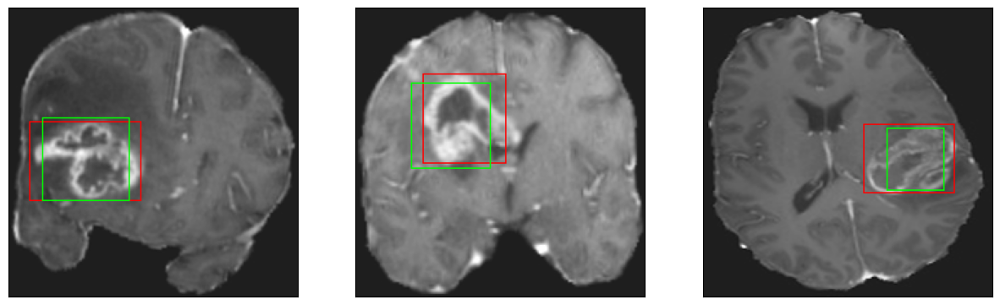

26/26 [==============================] - 4s 146ms/step - loss: 5.3615 - IoU: 0.5795 - val_loss: 4104.0732 - val_IoU: 0.4617
Epoch 190/200
26/26 [==============================] - ETA: 0s - loss: 5.3161 - IoU: 0.5871
Epoch 190: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 15ms/step
4


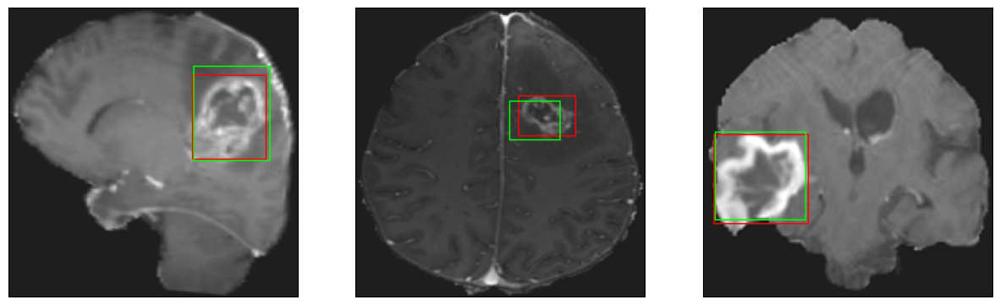

26/26 [==============================] - 4s 148ms/step - loss: 5.3161 - IoU: 0.5871 - val_loss: 9.7938 - val_IoU: 0.5103
Epoch 191/200
26/26 [==============================] - ETA: 0s - loss: 5.4573 - IoU: 0.5801
Epoch 191: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 12ms/step
4


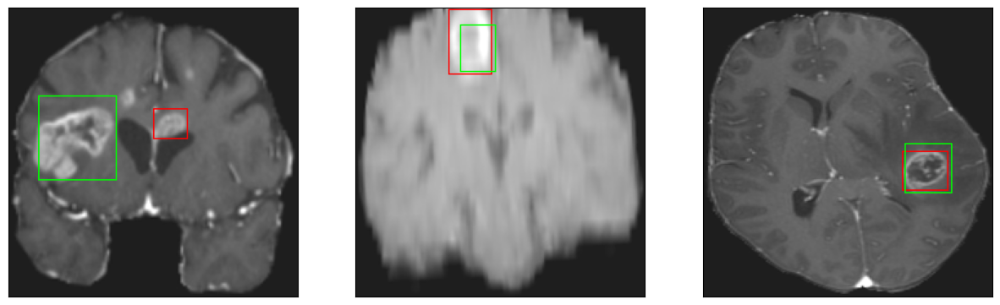

26/26 [==============================] - 3s 126ms/step - loss: 5.4573 - IoU: 0.5801 - val_loss: 9.7630 - val_IoU: 0.5080
Epoch 192/200
26/26 [==============================] - ETA: 0s - loss: 5.5816 - IoU: 0.5718
Epoch 192: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 14ms/step
4


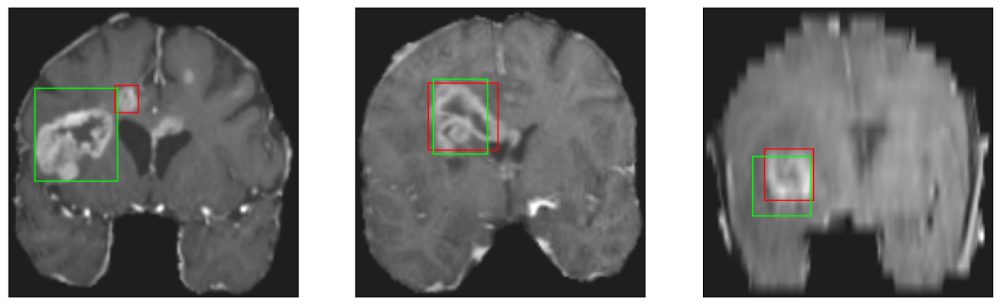

26/26 [==============================] - 4s 144ms/step - loss: 5.5816 - IoU: 0.5718 - val_loss: 41378.8438 - val_IoU: 0.3830
Epoch 193/200
26/26 [==============================] - ETA: 0s - loss: 5.2934 - IoU: 0.5803
Epoch 193: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


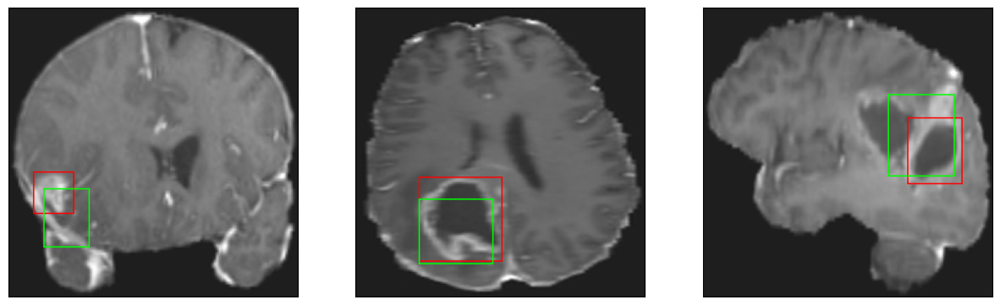

26/26 [==============================] - 3s 127ms/step - loss: 5.2934 - IoU: 0.5803 - val_loss: 227699.3750 - val_IoU: 0.3292
Epoch 194/200
26/26 [==============================] - ETA: 0s - loss: 5.2798 - IoU: 0.5917
Epoch 194: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


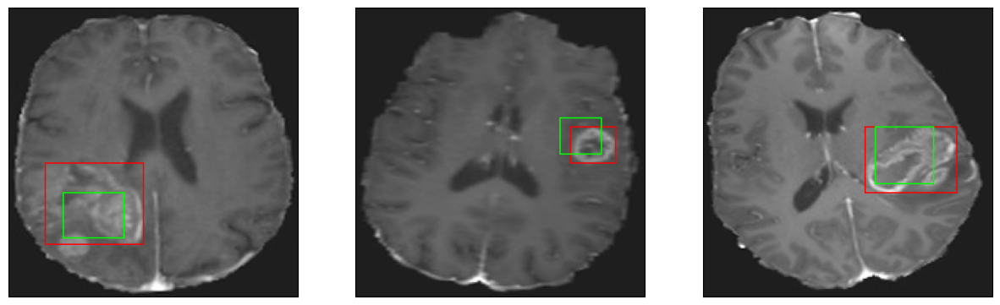

26/26 [==============================] - 3s 133ms/step - loss: 5.2798 - IoU: 0.5917 - val_loss: 10.4023 - val_IoU: 0.4612
Epoch 195/200
26/26 [==============================] - ETA: 0s - loss: 5.3777 - IoU: 0.5821
Epoch 195: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 14ms/step
4
8/8 [==============================] - 0s 16ms/step
4
8/8 [==============================] - 0s 16ms/step
4


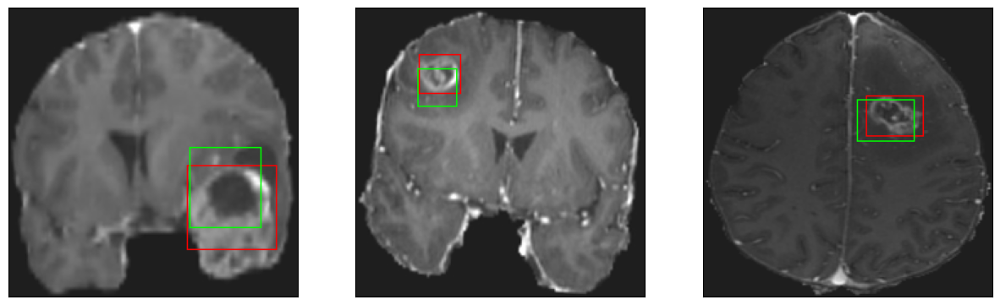

26/26 [==============================] - 4s 150ms/step - loss: 5.3777 - IoU: 0.5821 - val_loss: 10.5087 - val_IoU: 0.4953
Epoch 196/200
26/26 [==============================] - ETA: 0s - loss: 5.3007 - IoU: 0.5826
Epoch 196: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 12ms/step
4
8/8 [==============================] - 0s 11ms/step
4


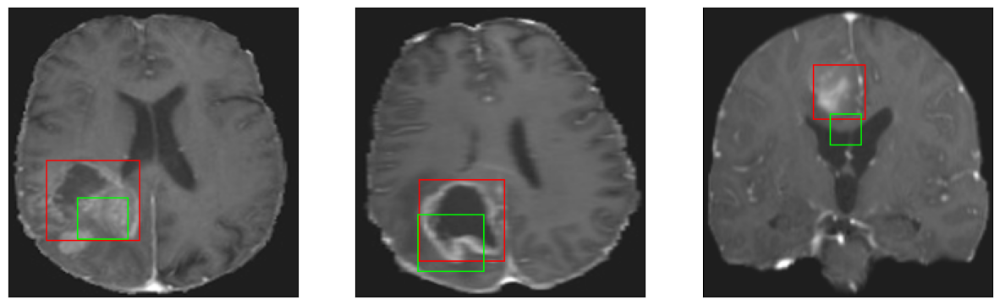

26/26 [==============================] - 4s 139ms/step - loss: 5.3007 - IoU: 0.5826 - val_loss: 11.9526 - val_IoU: 0.4543
Epoch 197/200
26/26 [==============================] - ETA: 0s - loss: 5.2135 - IoU: 0.5890
Epoch 197: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


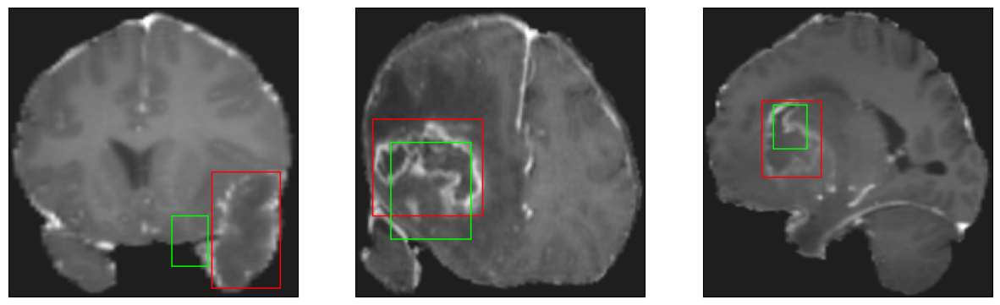

26/26 [==============================] - 3s 127ms/step - loss: 5.2135 - IoU: 0.5890 - val_loss: 17777.7871 - val_IoU: 0.4145
Epoch 198/200
26/26 [==============================] - ETA: 0s - loss: 5.4745 - IoU: 0.5807
Epoch 198: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 11ms/step
4


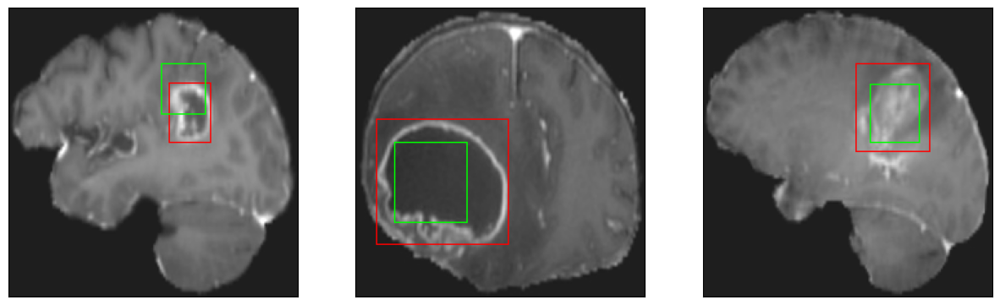

26/26 [==============================] - 3s 123ms/step - loss: 5.4745 - IoU: 0.5807 - val_loss: 11.4600 - val_IoU: 0.4149
Epoch 199/200
26/26 [==============================] - ETA: 0s - loss: 5.3520 - IoU: 0.5854
Epoch 199: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 11ms/step
4
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 11ms/step
4


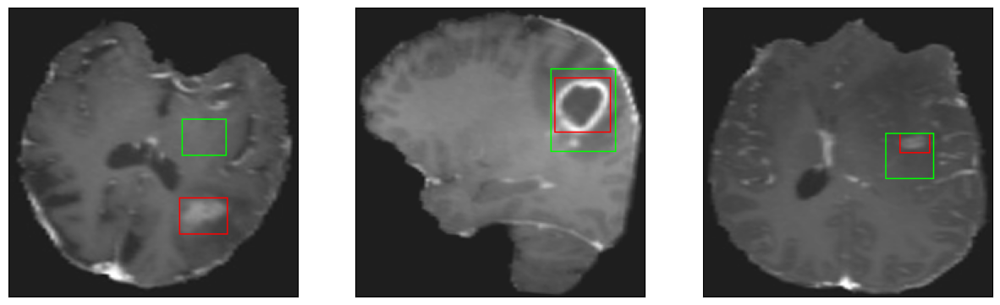

26/26 [==============================] - 3s 129ms/step - loss: 5.3520 - IoU: 0.5854 - val_loss: 3468.5337 - val_IoU: 0.4831
Epoch 200/200
26/26 [==============================] - ETA: 0s - loss: 5.1082 - IoU: 0.5876
Epoch 200: val_loss did not improve from 8.76803
8/8 [==============================] - 0s 13ms/step
4
8/8 [==============================] - 0s 17ms/step
4
8/8 [==============================] - 0s 12ms/step
4


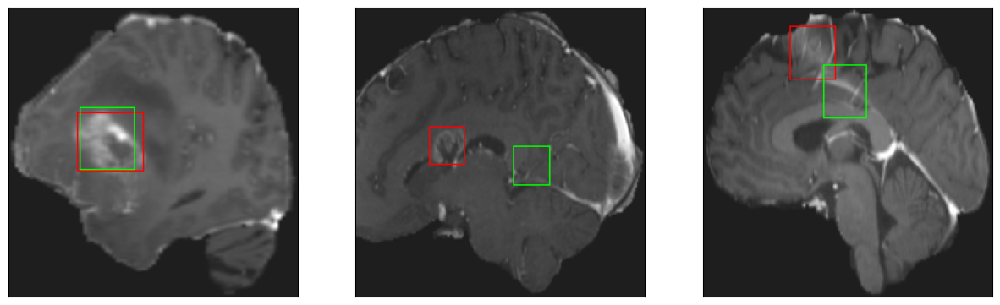

26/26 [==============================] - 4s 142ms/step - loss: 5.1082 - IoU: 0.5876 - val_loss: 9.8856 - val_IoU: 0.5198


In [24]:
hist = model.fit(
        train_dataset,
        epochs=200,
        validation_data = val_dataset,
        callbacks = callbacks_list
        )

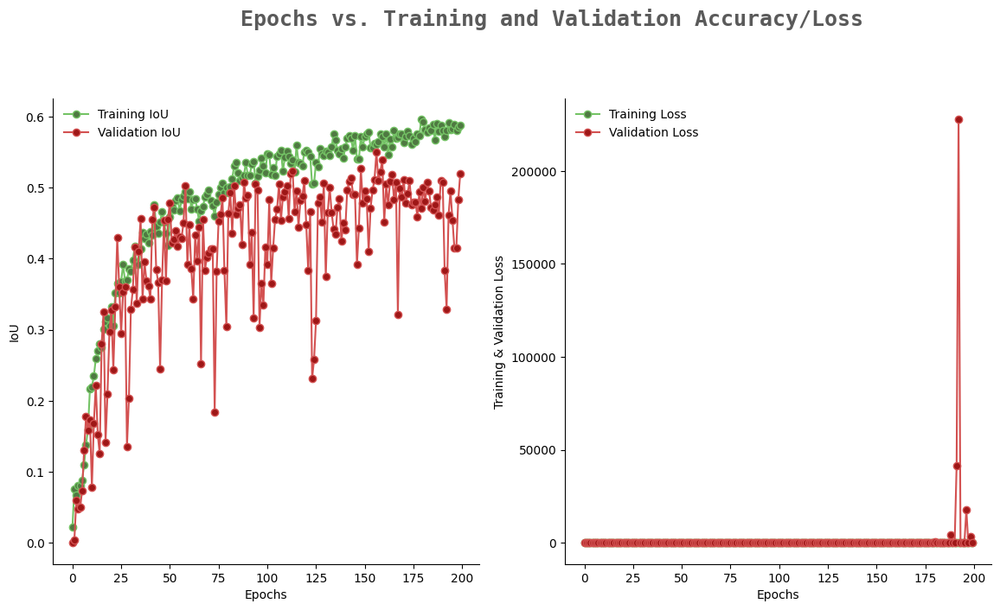

In [25]:
import seaborn as sns
colors_dark = ["#1F1F1F", "#313131", '#636363', '#AEAEAE', '#DADADA']
colors_red = ["#331313", "#582626", '#9E1717', '#D35151', '#E9B4B4']
colors_green = ['#01411C','#4B6F44','#4F7942','#74C365','#D0F0C0']
from warnings import filterwarnings
filterwarnings('ignore')

epochs = [i for i in range(200)]
fig, ax = plt.subplots(1,2,figsize=(14,7))
train_acc = hist.history['IoU']
train_loss = hist.history['loss']
val_acc = hist.history['val_IoU']
val_loss = hist.history['val_loss']

fig.text(s='Epochs vs. Training and Validation Accuracy/Loss',size=18,fontweight='bold',
             fontname='monospace',color=colors_dark[1],y=1,x=0.28,alpha=0.8)

sns.despine()
ax[0].plot(epochs, train_acc, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label = 'Training IoU')
ax[0].plot(epochs, val_acc, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation IoU')
ax[0].legend(frameon=False)
ax[0].set_xlabel('Epochs')
ax[0].set_ylabel('IoU')

sns.despine()
ax[1].plot(epochs, train_loss, marker='o',markerfacecolor=colors_green[2],color=colors_green[3],
           label ='Training Loss')
ax[1].plot(epochs, val_loss, marker='o',markerfacecolor=colors_red[2],color=colors_red[3],
           label = 'Validation Loss')
ax[1].legend(frameon=False)
ax[1].set_xlabel('Epochs')
ax[1].set_ylabel('Training & Validation Loss')

fig.show()

In [26]:
#iou = IoU(y_true, y_pred, 4, [1])
model = tf.keras.models.load_model('./model_checkpoint_SCRATCH/model_SCRATCH.h5',compile = False)

In [27]:
model.compile(
    loss={
        'coords': 'mae'
    },
    optimizer=tf.keras.optimizers.Adam(1e-3),
    metrics=[IoU]
)

In [28]:
model.evaluate(test_dataset)

8/8 [==============================] - 1s 37ms/step - loss: 10.0897 - IoU: 0.4649


[10.089729309082031, 0.46486032009124756]